<a href="https://colab.research.google.com/github/FKz11/Portfolio_Data_Science_2.0/blob/main/Hand_Gesture_Recognition/Hand_Gesture_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ВКР

## Постановка задачи:

### Распознавание жестов рук с помощью компьютерного зрения в режиме реального времени.

### Используемые библиотеки:

In [ ]:
#!pip -qq install torch torchvision --extra-index-url https://download.pytorch.org/whl/cu117
#!pip -qq install opencv-python

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import os
import json
import copy
import time
import torch
import torchvision
import torch.nn as nn
import numpy as np
from sklearn.metrics import f1_score
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as tt
from torchvision.utils import make_grid
from matplotlib import pyplot as plt
import cv2
%matplotlib inline

from tqdm import tqdm

In [ ]:
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

# -- Часть 1. Решение на прямую --

Сначала попытаемся решить задачу, что называется "в лоб". Найдём тренировочные данные с жестами рук, чтобы натренировать нейронную сеть классифицировать различные жесты рук.

## Обучения классификатора

### Данные

Данный датасет был найден в открытом доступе в интернете, в нём много различных жестов, которые хорошо видны, так как они заметно выделяются относительно фона. Чем больше различных данных, тем лучше нейронная сеть будет классифицировать.

In [ ]:
num_data = sorted(os.listdir("./leapGestRecog"))
print(f'Num Data - {num_data}')
classes_data = sorted(os.listdir("./leapGestRecog/00"))
print(f'Data Classes - {classes_data}')

Num Data - ['00', '01', '02', '03', '04', '05', '06', '07', '08', '09']
Data Classes - ['01_palm', '02_l', '03_fist', '04_fist_moved', '05_thumb', '06_index', '07_ok', '08_palm_moved', '09_c', '10_down']


In [ ]:
for data in os.listdir("./leapGestRecog"):
    print(f'############ {data} ############')
    for gesture in os.listdir(f"./leapGestRecog/{data}"):
        print(gesture, len(os.listdir(f"./leapGestRecog/00/{gesture}")))

############ 00 ############
01_palm 200
02_l 200
03_fist 200
04_fist_moved 200
05_thumb 200
06_index 200
07_ok 200
08_palm_moved 200
09_c 200
10_down 200
############ 01 ############
01_palm 200
02_l 200
03_fist 200
04_fist_moved 200
05_thumb 200
06_index 200
07_ok 200
08_palm_moved 200
09_c 200
10_down 200
############ 02 ############
01_palm 200
02_l 200
03_fist 200
04_fist_moved 200
05_thumb 200
06_index 200
07_ok 200
08_palm_moved 200
09_c 200
10_down 200
############ 03 ############
01_palm 200
02_l 200
03_fist 200
04_fist_moved 200
05_thumb 200
06_index 200
07_ok 200
08_palm_moved 200
09_c 200
10_down 200
############ 04 ############
01_palm 200
02_l 200
03_fist 200
04_fist_moved 200
05_thumb 200
06_index 200
07_ok 200
08_palm_moved 200
09_c 200
10_down 200
############ 05 ############
01_palm 200
02_l 200
03_fist 200
04_fist_moved 200
05_thumb 200
06_index 200
07_ok 200
08_palm_moved 200
09_c 200
10_down 200
############ 06 ############
01_palm 200
02_l 200
03_fist 200
04_fist_

Видно, что у нас в каждом пакете данных, в каждом классе по 200 примеров, возьмём 160 для train и 40 для test(test_size = 0.2):

In [ ]:
test_size = 0.2

train_data = []
train_labels = []
test_data = []
test_labels = []

for data in os.listdir("./leapGestRecog"):
    for gesture in os.listdir(f"./leapGestRecog/{data}"):
        imgs =  os.listdir(f"./leapGestRecog/{data}/{gesture}")
        trashold = int((1-test_size)*len(imgs))
        for img in imgs[:trashold]:
            train_data.append(f"./leapGestRecog/{data}/{gesture}/{img}")
            train_labels.append(int(gesture[:2]))
        for img in imgs[trashold:]:
            test_data.append(f"./leapGestRecog/{data}/{gesture}/{img}")
            test_labels.append(int(gesture[:2]))

In [ ]:
print(len(train_data))
print(len(test_data))

16000
4000


Всего получилось 20000 примеров, 2000 на каждый жест, это очень хорошие результаты.
Возьмём 4000 примеров для проверки неронной сети.

In [ ]:
train_data[160*2:160*2+5]

['./leapGestRecog/00/03_fist/frame_00_03_0001.png',
 './leapGestRecog/00/03_fist/frame_00_03_0002.png',
 './leapGestRecog/00/03_fist/frame_00_03_0003.png',
 './leapGestRecog/00/03_fist/frame_00_03_0004.png',
 './leapGestRecog/00/03_fist/frame_00_03_0005.png']

In [ ]:
train_labels[160*2:160*2+5]

[3, 3, 3, 3, 3]

### Пример

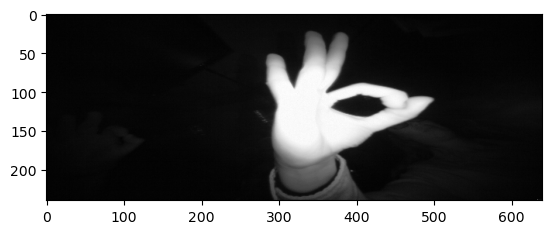

In [ ]:
img = plt.imread(train_data[1000])
plt.imshow(img, cmap='gray');

In [ ]:
img.shape

(240, 640)

Организуем наши данные для обучения, во-первых уменьшим и приведём все размеры изображений к одному = (128, 128), во-вторых будём отражать случайные изображение, чтобы нейронная сеть могла распозновать жесты показанные как левой, так и правой рукой.

### Dataset

In [ ]:
class Dataset_classification(Dataset):
    def __init__(self, data, labels, tfms):
      
        self.data = data
        self.labels = labels
        self.tfms = tfms

    def __getitem__(self, index):

        img = plt.imread(self.data[index])
        img = self.tfms(img)

        label = self.labels[index] - 1 # так как labels от 1 до 10

        return img, label

    def __len__(self):
        return len(self.labels)

In [ ]:
SIZE = (128, 128)

In [ ]:
train_tfms = tt.Compose([tt.ToTensor(),
                         tt.Resize(SIZE, antialias=False),
                         tt.RandomHorizontalFlip()])
test_tfms = tt.Compose([tt.ToTensor(),
                        tt.Resize(SIZE, antialias=False)])

In [ ]:
train_dataset = Dataset_classification(train_data, train_labels, train_tfms)
test_dataset = Dataset_classification(test_data, test_labels, test_tfms)

### DataLoader

In [ ]:
BATCH_SIZE = 16

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)
test_loader= DataLoader(test_dataset, BATCH_SIZE, shuffle=True)

In [ ]:
def show_batch(loader):
    for images, labels in loader:
        fig, ax = plt.subplots(figsize=(12, 12))
        ax.set_xticks([]); ax.set_yticks([])
        print(images[0].shape)
        ax.imshow(make_grid(images[:BATCH_SIZE], nrow=int(np.sqrt(BATCH_SIZE))).permute(1, 2, 0))
        break

torch.Size([1, 128, 128])


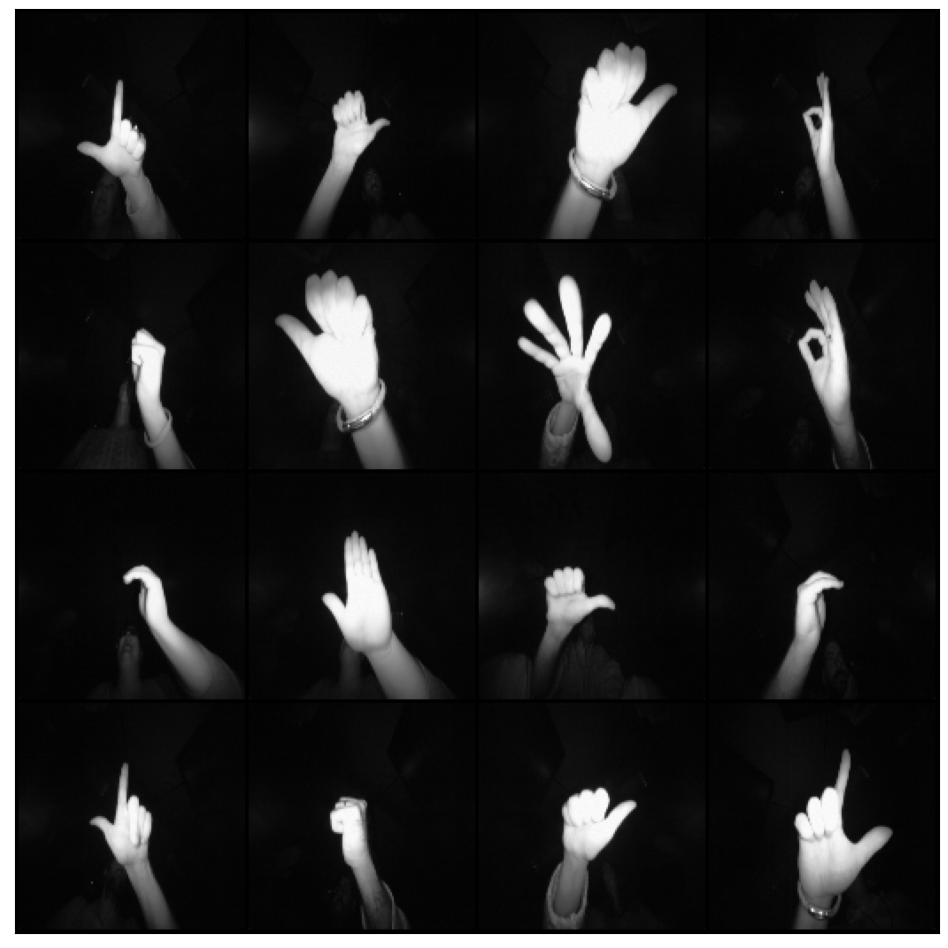

In [ ]:
show_batch(train_loader)

### Модель 

Модель содержит 3 блока свёртывающих слоев с пробрасыванием соединений, пакетной нормализацией, а так же слои, которые выключают из обучения какое-то количество нейронов. В конце сети стоит классификатор, который выдаёт 10 чисел, каждое из чисел отражает вероятность одного из жестов, чем больше, тем более вероятен этот жест.

In [ ]:
def conv_block(in_channels, out_channels, pool=False):
    layers = [nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1), 
              nn.BatchNorm2d(out_channels), 
              nn.ELU(inplace=True)]
    if pool:
        layers.append(nn.MaxPool2d(2))
    return nn.Sequential(*layers)


class Net_classification(nn.Module):
    def __init__(self, in_channels, num_classes, hidden_dim, dropout):
        super().__init__()
        
        self.conv1 = conv_block(in_channels, hidden_dim)
        self.conv2 = conv_block(hidden_dim, hidden_dim, pool=True)
        self.res1 = nn.Sequential(conv_block(hidden_dim, hidden_dim), conv_block(hidden_dim, hidden_dim))
        
        self.conv3 = conv_block(hidden_dim, hidden_dim*2)
        self.conv4 = conv_block(hidden_dim*2, hidden_dim*2, pool=True)
        self.res2 = nn.Sequential(conv_block(hidden_dim*2, hidden_dim*2), conv_block(hidden_dim*2, hidden_dim*2))
        
        self.conv5 = conv_block(hidden_dim*2, hidden_dim*4)
        self.conv6 = conv_block(hidden_dim*4, hidden_dim*4, pool=True)
        self.res3 = nn.Sequential(conv_block(hidden_dim*4, hidden_dim*4), conv_block(hidden_dim*4, hidden_dim*4))

        self.drop = nn.Dropout(dropout)
        
        self.classifier = nn.Sequential(nn.MaxPool2d(int(SIZE[0]/2**3)), 
                                        nn.Flatten(),
                                        nn.Linear(hidden_dim*4, num_classes))
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.conv2(out)
        out = self.res1(out) + out
        out = self.drop(out)
        
        out = self.conv3(out)
        out = self.conv4(out)
        out = self.res2(out) + out
        out = self.drop(out)
        
        out = self.conv5(out)
        out = self.conv6(out)
        out = self.res3(out) + out
        out = self.drop(out)
        
        out = self.classifier(out)
        return out

Будем обучать используя ядра cuda (2560) видеокарты "GeForce RTX 3050"

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
model = Net_classification(1, len(np.unique(train_labels)), 128, 0.5).to(device)
model

Net_classification(
  (conv1): Sequential(
    (0): Conv2d(1, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ELU(alpha=1.0, inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ELU(alpha=1.0, inplace=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ELU(alpha=1.0, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_ru

In [ ]:
print("Количество параметров: ", sum([param.numel() for param in model.parameters()]))

Количество параметров:  10781322


### Обучение

In [ ]:
model = model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

In [ ]:
%%time

epochs = 3

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    train_acc = 0
    test_acc = 0
    
    model.train()
    for imgs, labels in tqdm(train_loader):
        imgs = imgs.to(device)
        labels = labels.to(device)

        output = model(imgs)
                
        loss = criterion(output, labels)
        train_loss += loss.item()
                
        train_acc += (output.argmax(dim=1) == labels).sum().item() / len(labels)

        model.zero_grad()
        loss.backward()
        optimizer.step()
            
    model.eval()
    for imgs, labels in test_loader:
        imgs = imgs.to(device)
        labels = labels.to(device)

        output = model(imgs)

        loss = criterion(output, labels)
        test_loss += loss.item()
                    
        test_acc += (output.argmax(dim=1) == labels).sum().item() / len(labels)
    
    print(
        f"Epochs: {epoch_num + 1} | Train Loss: {train_loss / len(train_loader): .6f} \
        | Train Accuracy: {train_acc / len(train_loader): .6f}" + "\n" + " "*len(str(epoch_num + 1)) +
f"         | Test Loss: {test_loss / len(test_loader): .6f} \
         | Test Accuracy: {test_acc / len(test_loader): .6f}")

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:01<00:00,  4.14it/s]


Epochs: 1 | Train Loss:  2.241814         | Train Accuracy:  0.523813
          | Test Loss:  0.197564          | Test Accuracy:  0.963000


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [03:48<00:00,  4.37it/s]


Epochs: 2 | Train Loss:  0.142519         | Train Accuracy:  0.954063
          | Test Loss:  0.682192          | Test Accuracy:  0.765250


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [03:43<00:00,  4.48it/s]


Epochs: 3 | Train Loss:  0.107370         | Train Accuracy:  0.968625
          | Test Loss:  0.048487          | Test Accuracy:  0.979750
Wall time: 12min 48s


Мы получили точность 0.983250 на тестовой выборке, что даже очень хорошо.

### Сохраним классификатор:

In [ ]:
torch.save(model, 'classification_model.pth')

### ------ checkpoint ------

### Загрузим классификатор:

In [ ]:
classification_model = torch.load('classification_model.pth', map_location=torch.device('cuda')) 
classification_model.eval()

Net_classification(
  (conv1): Sequential(
    (0): Conv2d(1, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ELU(alpha=1.0, inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ELU(alpha=1.0, inplace=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ELU(alpha=1.0, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_ru

### Функция выводящая результаты работы модели

In [ ]:
def print_output(bbox_array, output, classes_data, x_txt, y_txt, step):
    x_txt, y_txt = int(x_txt * bbox_array.shape[0]), int(y_txt * bbox_array.shape[1])
    step = int(step * bbox_array.shape[1])
    for i in range(len(output[0])):
    # Выводим score для каждого класса
        bbox_array = cv2.putText(bbox_array, f'{classes_data[i]}: {round(output[0][i].item(), 3)}', 
                              (x_txt, y_txt+step*i), cv2.FONT_HERSHEY_COMPLEX, 0.7, (0,255,0), 1, cv2.LINE_AA)
  # Выводим самый вероятный класс его вероятность
    bbox_array = cv2.putText(bbox_array, f'{classes_data[output.argmax().item()]}: {round(F.softmax(output, dim=1).max().item()*100, 3)}%', 
                            (x_txt, y_txt+step*len(output[0])+3*step), cv2.FONT_HERSHEY_COMPLEX, 0.7, (0,255,0), 2, cv2.LINE_AA)    
    return bbox_array

## Результат

In [ ]:
cap = cv2.VideoCapture(0)
while True:
    ret, frame = cap.read()
    # resize image
    resize = cv2.resize(frame, SIZE)
    # grayscale image
    bgr2gray = cv2.cvtColor(resize, cv2.COLOR_BGR2GRAY)
    # image to tensor
    tensor = torch.FloatTensor(bgr2gray) / 255
    # tensor to device
    tensor = tensor[None,None,:,:].to(device)
    
    # predict classification_model
    classification_model.eval()
    output = classification_model(tensor)
    
    # print output classification_model
    img = print_output(frame, output, classes_data, x_txt=0.05, y_txt=0.05, step=0.04)   
    cv2.imshow('frame', img)
    if cv2.waitKey(1) == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

#### 09_с

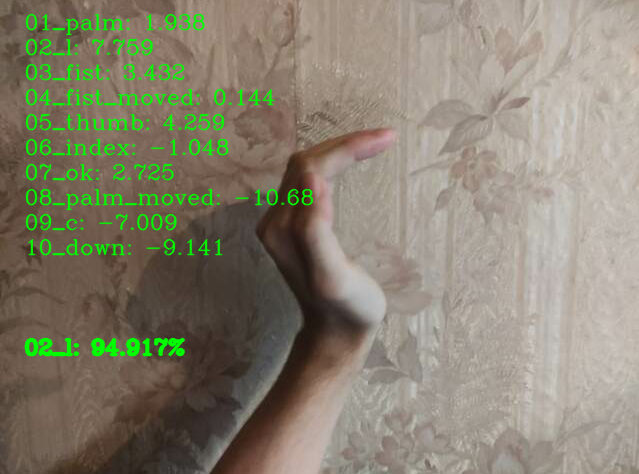

#### 06_index

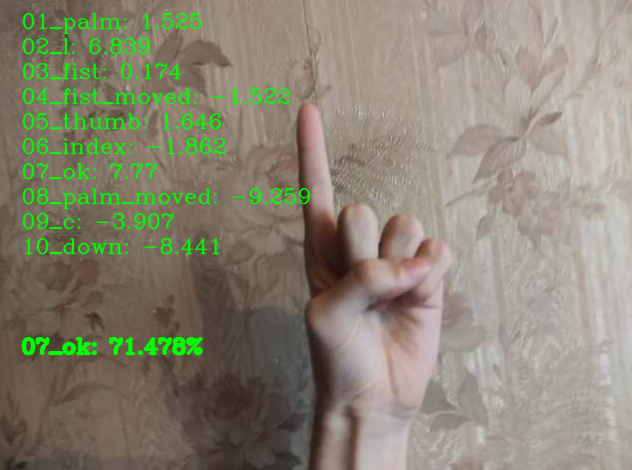

Видно, что модель не справляется, так как обучающие + тестовые данные недостаточно генерализированны. Моё видео с вебкамеры, даже переведенное в серые тона, всё равно слишком отчиается от тех данных, на которых тренировалась и проверялась классификационная модель.

# -- Часть 2. Улучшенное решение --

### Переосмыслим задачу. 

Cначала будем детектировать руку, затем определять ключевые точки, а уже только потом классифицировать.

### Mediapipe

Сначала попробуем воспользоваться готовым промышленным бесплатным решением от mediapipe.

In [ ]:
!pip install -qq mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.9/33.9 MB 16.0 MB/s eta 0:00:00


In [ ]:
import mediapipe as mp

Посмотрим сколько всего у нас данных

In [ ]:
count_labels = {}
for i in range(1,11):
    count_labels[str(i)] = (train_labels+test_labels).count(i)
count_labels

{'1': 2000,
 '2': 2000,
 '3': 2000,
 '4': 2000,
 '5': 2000,
 '6': 2000,
 '7': 2000,
 '8': 2000,
 '9': 2000,
 '10': 2000}

Теперь попробуем получить ключевые точки для наших данных. Понятно, что детектор не сможет дать точки для каждой картинки

In [ ]:
%%time
hands = mp.solutions.hands.Hands(
        static_image_mode=False,
        min_detection_confidence=0.5,
        min_tracking_confidence=0.5,
        max_num_hands=1) # 1 так как на каждой фотографии только один жест
# обьединим данные
data = train_data+test_data 
labels = train_labels+test_labels
data_landmarks = []
labels_landmarks = []
for i in tqdm(range(len(labels))):
    image = cv2.imread(data[i])
    results = hands.process(image)
    if results.multi_hand_landmarks:
        landmarks = []
        for landmark in results.multi_hand_landmarks[0].landmark:
            landmarks.append([landmark.x, landmark.y])
        # !!! Нормализуем данные от 0 до 1 (min-max normalisation) !!!
        landmarks = np.array(landmarks)
        landmarks[:,0] -= min(landmarks[:,0])
        landmarks[:,1] -= min(landmarks[:,1])
        landmarks[:,0] /= max(landmarks[:,0])
        landmarks[:,1] /= max(landmarks[:,1])
        data_landmarks.append(landmarks)   
        labels_landmarks.append(labels[i])

100%|████████████████████████████████████████████████████████████████████████████| 20000/20000 [05:54<00:00, 56.48it/s]

Wall time: 5min 54s


Посмторим для скольких примером детектор смог получить точки

In [ ]:
count_labels_landmarks = {}
for i in range(1,11):
    count_labels_landmarks[classes_data[i-1]] = labels_landmarks.count(i)
count_labels_landmarks

{'01_palm': 1696,
 '02_l': 1032,
 '03_fist': 452,
 '04_fist_moved': 87,
 '05_thumb': 623,
 '06_index': 594,
 '07_ok': 1590,
 '08_palm_moved': 230,
 '09_c': 472,
 '10_down': 1176}

Найдём дизбаланс классов относительно наибольшего, для учёта его при обучении

In [ ]:
class_count = np.array(list(count_labels_landmarks.values())).astype(float)
class_weights = max(class_count)
class_weights /= class_count
class_weights

array([ 1.        ,  1.64341085,  3.75221239, 19.49425287,  2.7223114 ,
        2.85521886,  1.06666667,  7.37391304,  3.59322034,  1.44217687])

### train/test split
Так, чтобы в обучающей и тествовой выборке были одинаковые соотношения классов

In [ ]:
test_size = 0.2

train_data_landmarks = []
train_labels_landmarks = []
test_data_landmarks = []
test_labels_landmarks = []

data_landmarks = np.array(data_landmarks)
labels_landmarks = np.array(labels_landmarks)

for i in range(1,11):
    mask = (labels_landmarks==i)
    trashold = int((1-test_size)*sum(mask))
    train_data_landmarks.extend(data_landmarks[mask][:trashold])
    train_labels_landmarks.extend([i]*trashold)
    test_data_landmarks.extend(data_landmarks[mask][trashold:])
    test_labels_landmarks.extend([i]*(sum(mask)-trashold))

### Dataset

In [ ]:
class Dataset_landmarks_classification(Dataset):
    def __init__(self, data_landmarks, labels_landmarks):
      
        self.data_landmarks = data_landmarks
        self.labels_landmarks = labels_landmarks

    def __getitem__(self, index):
        data = torch.FloatTensor(self.data_landmarks[index])
        label = self.labels_landmarks[index] - 1

        return data, label

    def __len__(self):
        return len(self.labels_landmarks)

In [ ]:
train_dataset = Dataset_landmarks_classification(train_data_landmarks, train_labels_landmarks)
test_dataset = Dataset_landmarks_classification(test_data_landmarks, test_labels_landmarks)

### DataLoader

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True, drop_last=True)
test_loader = DataLoader(test_dataset, BATCH_SIZE, shuffle=True)

drop_last=True, так как при train, BatchNorm всегда ожидает в пакете больше одного значения для расчёта статистик, но я не могу гарантировать, что в последнем будет хотя бы больше одного, так как теперь размер тренировочных данных может быть нечётным

### Модель

Обычный трёхслойный классификатор, его вполне достаточно для решения задачи с landmarks

In [ ]:
class Net_landmarks_classification(nn.Module):
    def __init__(self, in_channel, length, hidden_dim, num_classes, dropout):
        super().__init__()
        self.linear_1 = nn.Linear(in_channel*length, hidden_dim)
        self.bn_1 = nn.BatchNorm1d(hidden_dim)
        self.linear_2 = nn.Linear(hidden_dim, hidden_dim // 2)
        self.bn_2 = nn.BatchNorm1d(hidden_dim // 2)
        self.linear_3 = nn.Linear(hidden_dim // 2, num_classes)

        self.relu = nn.ReLU()
        self.dp = nn.Dropout(dropout)
        
    def forward(self, x):  
        x = torch.flatten(x, start_dim=1)

        output = self.linear_1(x)
        output = self.bn_1(output)
        output = self.relu(output)
        output = self.dp(output)

        output = self.linear_2(output)
        output = self.bn_2(output)
        output = self.relu(output)
        output = self.dp(output)
        
        output = self.linear_3(output)
        return output

In [ ]:
model = Net_landmarks_classification(data_landmarks.shape[2], data_landmarks.shape[1], 512, len(classes_data), 0.2)
model = model.to(device)
model.train()

Net_landmarks_classification(
  (linear_1): Linear(in_features=42, out_features=512, bias=True)
  (bn_1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_2): Linear(in_features=512, out_features=256, bias=True)
  (bn_2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_3): Linear(in_features=256, out_features=10, bias=True)
  (relu): ReLU()
  (dp): Dropout(p=0.2, inplace=False)
)

In [ ]:
print("Количество параметров: ", sum([param.numel() for param in model.parameters()]))

Количество параметров:  157450


In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss(weight=torch.FloatTensor(class_weights).to(device), reduction='mean')

Так как классы теперь несбалансированны, то accuracy уже не является хорошей метрикой, поэтому будем использовать f1_score

### Обучение

In [ ]:
%%time

epochs = 50

train_list_loss = []
test_list_loss = []
train_list_acc = []
test_list_acc = []
train_list_f1 = []
test_list_f1 = []

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    train_acc = 0
    test_acc = 0
    train_f1 = 0
    test_f1 = 0
    
    model.train()
    for landmarks, labels in tqdm(train_loader):
        landmarks = landmarks.to(device)
        labels = labels.to(device)

        output = model(landmarks)
                
        loss = criterion(output, labels)
        train_loss += loss.item()
                
        train_acc += (output.argmax(dim=1) == labels).sum().item() / len(labels)
        
        train_f1 += f1_score(labels.detach().cpu().numpy().astype(int), 
                            (output.detach().cpu().numpy().argmax(1)).astype(int), average='weighted')

        model.zero_grad()
        loss.backward()
        optimizer.step()
            
    model.eval()
    for landmarks, labels in test_loader:
        landmarks = landmarks.to(device)
        labels = labels.to(device)

        output = model(landmarks)

        loss = criterion(output, labels)
        test_loss += loss.item()
                    
        test_acc += (output.argmax(dim=1) == labels).sum().item() / len(labels)

        test_f1 += f1_score(labels.detach().cpu().numpy().astype(int), 
                            (output.detach().cpu().numpy().argmax(1)).astype(int), average='weighted')
            
    train_list_loss.append(round(train_loss / len(train_loader), 6))
    test_list_loss.append(round(test_loss / len(test_loader), 6))
    train_list_acc.append(round(train_acc / len(train_loader), 6))
    test_list_acc.append(round(test_acc / len(test_loader), 6))
    train_list_f1.append(round(train_f1 / len(train_loader), 6))
    test_list_f1.append(round(test_f1 / len(test_loader), 6))
    
    print(
        f"Epochs: {epoch_num + 1} | Train Loss: {train_loss / len(train_loader): .6f} \
        | Train Accuracy: {train_acc / len(train_loader): .6f} \
        | Train_f1: {train_f1 / len(train_loader): .6f}" + "\n" + " "*len(str(epoch_num + 1)) +
f"         | Test Loss: {test_loss / len(test_loader): .6f} \
         | Test Accuracy: {test_acc / len(test_loader): .6f} \
         | Test_f1: {test_f1 / len(test_loader): .6f}")
    
    # Динамически меняем lr в зависимости от ошибки
    opt_loss = round(train_loss / len(train_loader), 6)
    if opt_loss < 0.02:
      optimizer.param_groups[0]['lr'] = 10**(-4)
    else:
      optimizer.param_groups[0]['lr'] = 10**(-3)

100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:01<00:00, 389.34it/s]


Epochs: 1 | Train Loss:  0.358469         | Train Accuracy:  0.907431         | Train_f1:  0.918574
          | Test Loss:  0.196325          | Test Accuracy:  0.962500          | Test_f1:  0.959255


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 450.62it/s]


Epochs: 2 | Train Loss:  0.120628         | Train Accuracy:  0.958438         | Train_f1:  0.965810
          | Test Loss:  0.239157          | Test Accuracy:  0.966307          | Test_f1:  0.964644


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 414.84it/s]


Epochs: 3 | Train Loss:  0.098504         | Train Accuracy:  0.970718         | Train_f1:  0.976368
          | Test Loss:  0.210403          | Test Accuracy:  0.951591          | Test_f1:  0.956168


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:01<00:00, 392.29it/s]


Epochs: 4 | Train Loss:  0.084190         | Train Accuracy:  0.972607         | Train_f1:  0.977019
          | Test Loss:  0.149904          | Test Accuracy:  0.976875          | Test_f1:  0.975997


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 452.16it/s]


Epochs: 5 | Train Loss:  0.069776         | Train Accuracy:  0.979377         | Train_f1:  0.982707
          | Test Loss:  0.124664          | Test Accuracy:  0.975966          | Test_f1:  0.975755


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 450.55it/s]


Epochs: 6 | Train Loss:  0.058479         | Train Accuracy:  0.980479         | Train_f1:  0.984370
          | Test Loss:  0.121852          | Test Accuracy:  0.979375          | Test_f1:  0.977680


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 438.19it/s]


Epochs: 7 | Train Loss:  0.057486         | Train Accuracy:  0.978432         | Train_f1:  0.981436
          | Test Loss:  0.180224          | Test Accuracy:  0.969091          | Test_f1:  0.969052


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 435.79it/s]


Epochs: 8 | Train Loss:  0.058222         | Train Accuracy:  0.983627         | Train_f1:  0.987176
          | Test Loss:  0.149440          | Test Accuracy:  0.976875          | Test_f1:  0.975155


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 433.41it/s]


Epochs: 9 | Train Loss:  0.044005         | Train Accuracy:  0.985359         | Train_f1:  0.987391
          | Test Loss:  0.163172          | Test Accuracy:  0.975000          | Test_f1:  0.972678


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 431.41it/s]


Epochs: 10 | Train Loss:  0.056402         | Train Accuracy:  0.982683         | Train_f1:  0.986270
           | Test Loss:  0.240032          | Test Accuracy:  0.961875          | Test_f1:  0.964168


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 451.83it/s]


Epochs: 11 | Train Loss:  0.039441         | Train Accuracy:  0.987091         | Train_f1:  0.989514
           | Test Loss:  0.183539          | Test Accuracy:  0.974716          | Test_f1:  0.972538


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 445.68it/s]


Epochs: 12 | Train Loss:  0.036880         | Train Accuracy:  0.988035         | Train_f1:  0.990092
           | Test Loss:  0.242335          | Test Accuracy:  0.958125          | Test_f1:  0.959768


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 434.83it/s]


Epochs: 13 | Train Loss:  0.056757         | Train Accuracy:  0.982840         | Train_f1:  0.986073
           | Test Loss:  0.137017          | Test Accuracy:  0.973750          | Test_f1:  0.972738


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 442.59it/s]


Epochs: 14 | Train Loss:  0.036699         | Train Accuracy:  0.987406         | Train_f1:  0.989886
           | Test Loss:  0.309539          | Test Accuracy:  0.969375          | Test_f1:  0.969260


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 428.26it/s]


Epochs: 15 | Train Loss:  0.036588         | Train Accuracy:  0.988035         | Train_f1:  0.990156
           | Test Loss:  0.382704          | Test Accuracy:  0.973750          | Test_f1:  0.971020


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 427.04it/s]


Epochs: 16 | Train Loss:  0.036193         | Train Accuracy:  0.990082         | Train_f1:  0.992260
           | Test Loss:  0.224562          | Test Accuracy:  0.975000          | Test_f1:  0.975540


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 437.23it/s]


Epochs: 17 | Train Loss:  0.031867         | Train Accuracy:  0.991656         | Train_f1:  0.993289
           | Test Loss:  0.209315          | Test Accuracy:  0.976250          | Test_f1:  0.974775


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 435.30it/s]


Epochs: 18 | Train Loss:  0.041257         | Train Accuracy:  0.988665         | Train_f1:  0.990287
           | Test Loss:  0.122058          | Test Accuracy:  0.980625          | Test_f1:  0.982391


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 429.65it/s]


Epochs: 19 | Train Loss:  0.025429         | Train Accuracy:  0.991341         | Train_f1:  0.992940
           | Test Loss:  0.286569          | Test Accuracy:  0.971875          | Test_f1:  0.971192


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 453.72it/s]


Epochs: 20 | Train Loss:  0.038213         | Train Accuracy:  0.987248         | Train_f1:  0.989322
           | Test Loss:  0.304012          | Test Accuracy:  0.975625          | Test_f1:  0.976565


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 432.79it/s]


Epochs: 21 | Train Loss:  0.035578         | Train Accuracy:  0.988508         | Train_f1:  0.990463
           | Test Loss:  0.276968          | Test Accuracy:  0.973466          | Test_f1:  0.972041


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 435.78it/s]


Epochs: 22 | Train Loss:  0.026571         | Train Accuracy:  0.990082         | Train_f1:  0.991760
           | Test Loss:  0.209473          | Test Accuracy:  0.977500          | Test_f1:  0.977267


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 427.40it/s]


Epochs: 23 | Train Loss:  0.026802         | Train Accuracy:  0.990869         | Train_f1:  0.992441
           | Test Loss:  0.230800          | Test Accuracy:  0.970000          | Test_f1:  0.969917


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 455.34it/s]


Epochs: 24 | Train Loss:  0.046316         | Train Accuracy:  0.988980         | Train_f1:  0.991024
           | Test Loss:  0.231529          | Test Accuracy:  0.970966          | Test_f1:  0.968803


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 439.65it/s]


Epochs: 25 | Train Loss:  0.022710         | Train Accuracy:  0.992601         | Train_f1:  0.993827
           | Test Loss:  0.210086          | Test Accuracy:  0.978750          | Test_f1:  0.977194


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 438.18it/s]


Epochs: 26 | Train Loss:  0.037378         | Train Accuracy:  0.989295         | Train_f1:  0.991536
           | Test Loss:  0.195629          | Test Accuracy:  0.979375          | Test_f1:  0.979075


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 439.64it/s]


Epochs: 27 | Train Loss:  0.031002         | Train Accuracy:  0.991656         | Train_f1:  0.993635
           | Test Loss:  0.225717          | Test Accuracy:  0.978750          | Test_f1:  0.977989


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 436.63it/s]


Epochs: 28 | Train Loss:  0.019666         | Train Accuracy:  0.993545         | Train_f1:  0.994607
           | Test Loss:  0.251052          | Test Accuracy:  0.971875          | Test_f1:  0.969804


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 450.11it/s]


Epochs: 29 | Train Loss:  0.026353         | Train Accuracy:  0.991499         | Train_f1:  0.992869
           | Test Loss:  0.198785          | Test Accuracy:  0.978125          | Test_f1:  0.977179


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 436.66it/s]


Epochs: 30 | Train Loss:  0.037887         | Train Accuracy:  0.991656         | Train_f1:  0.993425
           | Test Loss:  0.269566          | Test Accuracy:  0.979375          | Test_f1:  0.977360


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 433.88it/s]


Epochs: 31 | Train Loss:  0.040637         | Train Accuracy:  0.989924         | Train_f1:  0.991463
           | Test Loss:  0.468124          | Test Accuracy:  0.978750          | Test_f1:  0.977600


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 426.73it/s]


Epochs: 32 | Train Loss:  0.026854         | Train Accuracy:  0.992128         | Train_f1:  0.993047
           | Test Loss:  0.240606          | Test Accuracy:  0.980000          | Test_f1:  0.979594


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 455.80it/s]


Epochs: 33 | Train Loss:  0.031692         | Train Accuracy:  0.991499         | Train_f1:  0.992827
           | Test Loss:  0.299325          | Test Accuracy:  0.976875          | Test_f1:  0.973644


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 448.59it/s]


Epochs: 34 | Train Loss:  0.041318         | Train Accuracy:  0.991026         | Train_f1:  0.992741
           | Test Loss:  0.217724          | Test Accuracy:  0.980625          | Test_f1:  0.978957


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 443.23it/s]


Epochs: 35 | Train Loss:  0.030583         | Train Accuracy:  0.990239         | Train_f1:  0.992113
           | Test Loss:  0.315029          | Test Accuracy:  0.980625          | Test_f1:  0.980852


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 439.16it/s]


Epochs: 36 | Train Loss:  0.024898         | Train Accuracy:  0.991341         | Train_f1:  0.992970
           | Test Loss:  0.328849          | Test Accuracy:  0.980625          | Test_f1:  0.978288


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 440.62it/s]


Epochs: 37 | Train Loss:  0.025696         | Train Accuracy:  0.992286         | Train_f1:  0.993774
           | Test Loss:  0.345434          | Test Accuracy:  0.978750          | Test_f1:  0.979122


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 438.67it/s]


Epochs: 38 | Train Loss:  0.033186         | Train Accuracy:  0.991814         | Train_f1:  0.993326
           | Test Loss:  0.366210          | Test Accuracy:  0.973125          | Test_f1:  0.972327


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 454.75it/s]


Epochs: 39 | Train Loss:  0.033710         | Train Accuracy:  0.990397         | Train_f1:  0.991845
           | Test Loss:  0.188120          | Test Accuracy:  0.976250          | Test_f1:  0.975656


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 441.60it/s]


Epochs: 40 | Train Loss:  0.027935         | Train Accuracy:  0.991499         | Train_f1:  0.992801
           | Test Loss:  0.318915          | Test Accuracy:  0.978807          | Test_f1:  0.977420


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 443.37it/s]


Epochs: 41 | Train Loss:  0.020554         | Train Accuracy:  0.992286         | Train_f1:  0.993642
           | Test Loss:  0.471462          | Test Accuracy:  0.977216          | Test_f1:  0.975951


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 432.81it/s]


Epochs: 42 | Train Loss:  0.026070         | Train Accuracy:  0.992601         | Train_f1:  0.993958
           | Test Loss:  0.308230          | Test Accuracy:  0.982500          | Test_f1:  0.981568


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 416.61it/s]


Epochs: 43 | Train Loss:  0.028375         | Train Accuracy:  0.992286         | Train_f1:  0.993987
           | Test Loss:  0.451279          | Test Accuracy:  0.978125          | Test_f1:  0.975322


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 449.79it/s]


Epochs: 44 | Train Loss:  0.017996         | Train Accuracy:  0.993388         | Train_f1:  0.994585
           | Test Loss:  0.410052          | Test Accuracy:  0.975000          | Test_f1:  0.973585


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 445.57it/s]


Epochs: 45 | Train Loss:  0.010203         | Train Accuracy:  0.996851         | Train_f1:  0.997139
           | Test Loss:  0.419582          | Test Accuracy:  0.976591          | Test_f1:  0.975056


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 445.57it/s]


Epochs: 46 | Train Loss:  0.009187         | Train Accuracy:  0.997166         | Train_f1:  0.997785
           | Test Loss:  0.296558          | Test Accuracy:  0.981250          | Test_f1:  0.979389


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 430.59it/s]


Epochs: 47 | Train Loss:  0.008838         | Train Accuracy:  0.995749         | Train_f1:  0.996447
           | Test Loss:  0.392729          | Test Accuracy:  0.980000          | Test_f1:  0.978295


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 431.52it/s]


Epochs: 48 | Train Loss:  0.002671         | Train Accuracy:  0.999055         | Train_f1:  0.999289
           | Test Loss:  0.393418          | Test Accuracy:  0.978750          | Test_f1:  0.976337


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 444.11it/s]


Epochs: 49 | Train Loss:  0.007164         | Train Accuracy:  0.997796         | Train_f1:  0.997962
           | Test Loss:  0.367945          | Test Accuracy:  0.978750          | Test_f1:  0.977366


100%|███████████████████████████████████████████████████████████████████████████████| 397/397 [00:00<00:00, 432.99it/s]


Epochs: 50 | Train Loss:  0.007745         | Train Accuracy:  0.997009         | Train_f1:  0.997554
           | Test Loss:  0.488885          | Test Accuracy:  0.976932          | Test_f1:  0.976008
Wall time: 51.5 s


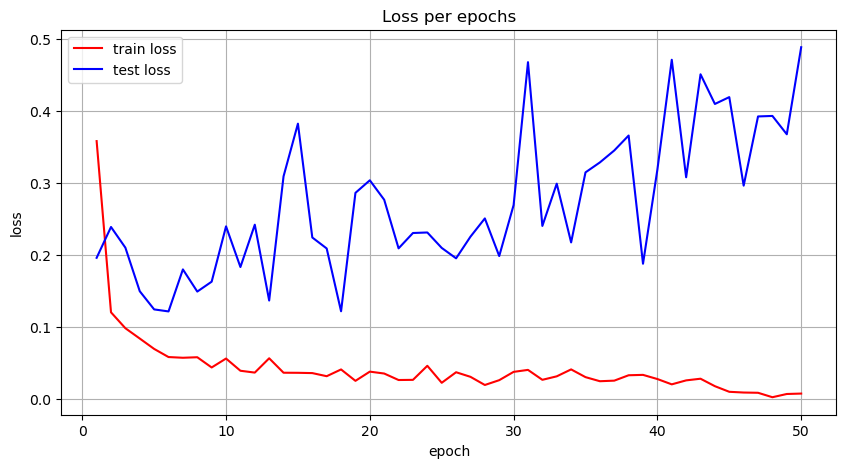

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_loss, 'r', label='train loss')
plt.plot(list(range(1, epochs+1)), test_list_loss, 'b', label='test loss')
plt.title('Loss per epochs')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.grid()
plt.show()

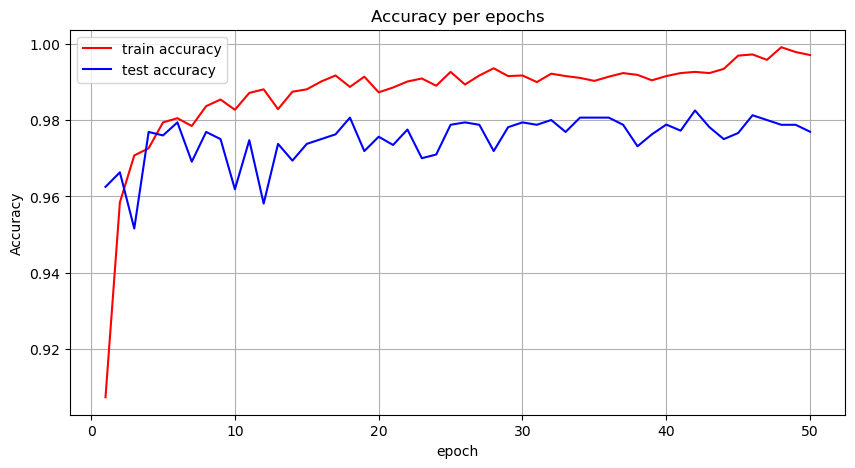

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_acc, 'r', label='train accuracy')
plt.plot(list(range(1, epochs+1)), test_list_acc, 'b', label='test accuracy')
plt.title('Accuracy per epochs')
plt.xlabel('epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

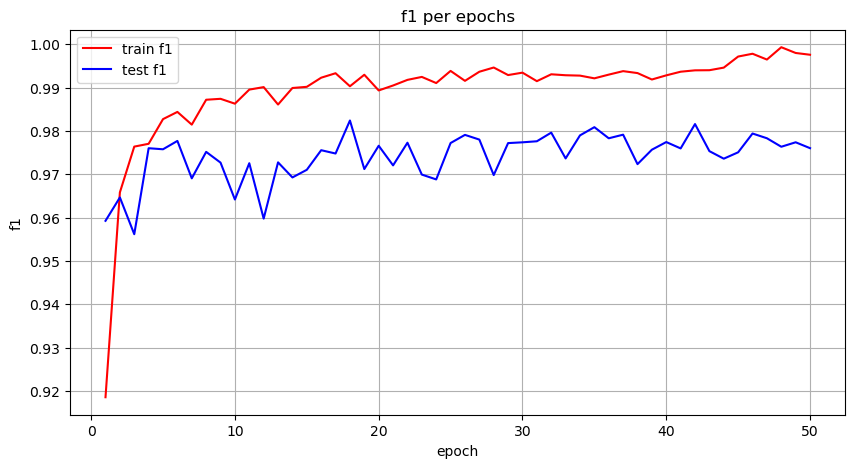

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_f1, 'r', label='train f1')
plt.plot(list(range(1, epochs+1)), test_list_f1, 'b', label='test f1')
plt.title('f1 per epochs')
plt.xlabel('epoch')
plt.ylabel('f1')
plt.legend()
plt.grid()
plt.show()

### Сохраним классификатор:

In [ ]:
torch.save(model, 'classification_model_landmarks.pth')

### ------ checkpoint ------

### Загрузим классификатор:

In [ ]:
classification_model_landmarks = torch.load('classification_model_landmarks.pth', map_location=torch.device('cuda')) 
classification_model_landmarks.eval()

Net_landmarks_classification(
  (linear_1): Linear(in_features=42, out_features=512, bias=True)
  (bn_1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_2): Linear(in_features=512, out_features=256, bias=True)
  (bn_2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_3): Linear(in_features=256, out_features=10, bias=True)
  (relu): ReLU()
  (dp): Dropout(p=0.2, inplace=False)
)

Функция детектирования руки

In [ ]:
def hand_landmarks_detect(image, hands, padding, hand_box_color, draw_landmarks = True, draw_bboxs = True, only_right = True,
                          thickness_boxes = 1):
    
    bboxs = []

    hand_landmarks = None
    handedness_index = None
    
    # Perform the Hands Landmarks Detection.
    results = hands.process(image)
    
    # Check if landmarks are found.
    if results.multi_hand_landmarks:
        
        hand_landmarks = []
        # Iterate over the found hands.
        for multi_hand_landmarks in results.multi_hand_landmarks:
            
            # Draw the hand landmarks on the copy of the input image.
            if draw_landmarks:
              mp.solutions.drawing_utils.draw_landmarks(image = image, landmark_list = multi_hand_landmarks,
                                  connections = mp.solutions.hands.HAND_CONNECTIONS) 
           
            # Собираем landmarks
            landmarks = []
            for landmark in multi_hand_landmarks.landmark:
                landmarks.append([landmark.x, landmark.y])
            landmarks = np.array(landmarks)

            # Границы bounding box
            x1, y1 = min(landmarks[:,0])*image.shape[1], min(landmarks[:,1])*image.shape[0]
            x2, y2 = max(landmarks[:,0])*image.shape[1], max(landmarks[:,1])*image.shape[0]
            # Добавляем padding относительно размеров bounding box
            x1, y1 = int(x1-(x2-x1)*padding), int(y1-(y2-y1)*padding)
            x2, y2 = int(x2+(x2-x1)*padding), int(y2+(y2-y1)*padding)
            # Если с padding box вылезает за изображение, то пускай границей box будет граница изображения
            x1, y1 = x1 if x1 > 0 else 0, y1 if y1 > 0 else 0
            x2, y2 = x2 if x2 < image.shape[1] else image.shape[1], y2 if y2 < image.shape[0] else image.shape[0]
            # Отрисовываем box
            if draw_bboxs:
              image = cv2.rectangle(image,(x1, y1),(x2, y2),hand_box_color,thickness=thickness_boxes)
            bboxs.append([x1, y1, x2, y2])

            # !!! Нормализуем данные от 0 до 1 (min-max normalisation) !!!
            landmarks[:,0] -= min(landmarks[:,0])
            landmarks[:,1] -= min(landmarks[:,1])
            landmarks[:,0] /= max(landmarks[:,0])
            landmarks[:,1] /= max(landmarks[:,1])
            hand_landmarks.append(landmarks)

        # Ориентация руки
        handedness_index = []
        for handedness in results.multi_handedness:
            handedness_index.append(handedness.classification[0].index)
        handedness_index = np.array(handedness_index)

        # ??? По какой-то причине, во время разработки этого проекта, mediapipe определяет руки с точность наоборот, 
        # поэтому временная(надеюсь) строчка, которая делает reverse данных ???
        handedness_index = (handedness_index-1)*(-1)

        hand_landmarks = np.array(hand_landmarks)
        # !!! Если рука левая, то отзеркаливаем landmarks путём: 1-x, так как в обучающих данных жесты показывались только правой рукой !!!
        if only_right:
          for i in range(len(handedness_index)):
            if not handedness_index[i]:
              hand_landmarks[i,:,0] = 1 - hand_landmarks[i,:,0]
        
    # Return the output bbox_array and results of hands landmarks detection.
    return image, hand_landmarks, handedness_index, bboxs

Функция выводящая результаты работы модели

In [ ]:
def print_output(bbox_array, output, max_scores, max_indexes, classes_data, handedness_index, 
                 x_padding, y_padding, step, output_color, output_font_scale, output_thickness):
    y_txt = int(y_padding * bbox_array.shape[0])
    step = int(step * bbox_array.shape[0])
    # Перебираем найденные руки
    for i in range(len(handedness_index)):
        # Если рука левая, ровняем по левому краю, если правая, по правому
        x_txt = int((1-x_padding-(1-2*x_padding)*handedness_index[i]) * bbox_array.shape[1])

        # Выводим score для каждого класса
        for j in range(len(classes_data)):
            text = f'{classes_data[j]}: {round(output[i][j].item(), 3)}'
            (width, height), baseline = cv2.getTextSize(text, cv2.FONT_HERSHEY_COMPLEX, output_font_scale, output_thickness-1)
            bbox_array = cv2.putText(bbox_array, text, (x_txt-width+width*handedness_index[i], y_txt+height+(height+step)*j), 
                               cv2.FONT_HERSHEY_COMPLEX, output_font_scale, output_color, 1, cv2.LINE_AA)
        
        # Выводим самый вероятный класс его вероятность
        text = f'{classes_data[max_indexes[i].item()]}: {round(max_scores[i].item()*100, 3)}%'
        (width, height), baseline = cv2.getTextSize(text, cv2.FONT_HERSHEY_COMPLEX, output_font_scale, output_thickness)
        bbox_array = cv2.putText(bbox_array, text, (x_txt-width+width*handedness_index[i], y_txt+height+(height+step)*len(classes_data)+3*step), 
                             cv2.FONT_HERSHEY_COMPLEX, output_font_scale, output_color, output_thickness, cv2.LINE_AA)    

        # Выводим ориентацию руки
        text = 'Right' if handedness_index[i] else 'Left'
        (width, height), baseline = cv2.getTextSize(text, cv2.FONT_HERSHEY_COMPLEX, output_font_scale, output_thickness)
        bbox_array = cv2.putText(bbox_array, text, (x_txt-width+width*handedness_index[i], y_txt+2*height+(height+step)*len(classes_data)+6*step), 
                             cv2.FONT_HERSHEY_COMPLEX, output_font_scale, output_color, output_thickness, cv2.LINE_AA) 
    return bbox_array

Определяем hands

In [ ]:
hands = mp.solutions.hands.Hands(
        static_image_mode=False,
        min_detection_confidence=0.9,
        min_tracking_confidence=0.9,
        max_num_hands=2) # Будем анализировать сразу 2 руки

## Pipeline

In [ ]:
def go_pipeline(classification_model_landmarks, hands, palm='HOW', l='ARE', fist='YOU', fist_moved='GOOD', thumb='I', 
        index='HE', ok=None, palm_moved='', c='VERY', down='', trashold=0.95, delay=3, step_message=0.02, x_start_message=0.4, 
        y_start_message=0.01, x_end_message=1, padding_landmarks_detect=0.1, x_padding_output=0.01, y_padding_output=0.01, 
        step_output=0.02, hand_box_color=(255,0,0), output_color=(0,255,0), message_color=(215,125,49), 
        text_font_scale=0.7, text_thickness=2, output_font_scale=0.7, output_thickness=2):
    
    cap = cv2.VideoCapture(0)
    # initialze bounding box to empty
    bbox = ''
    count = 0 
    # bbox_array_size
    bbox_array_size = [480,640,3]

    gestures = [palm, l, fist, fist_moved, thumb, index, ok, palm_moved, c, down]

    # Жест после которого сообщение стерается
    delete_index = gestures.index(None)

    # Это параметры для выводимого сообщения
    step = int(step_message * bbox_array_size[0])
    x_start = int(x_start_message * bbox_array_size[1])
    y_start = int(y_start_message * bbox_array_size[0])
    x_end = int(x_end_message * bbox_array_size[1])
    messages = ['']
    i_line_message = 0
    width_line_message = 0
    last_time = time.time()

    while True:
        ret, frame = cap.read()
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        # landmarks detect
        frame, hand_landmarks, handedness_index = hand_landmarks_detect(frame, hands, 
                                                                        padding_landmarks_detect, hand_box_color)[:-1]
        if hand_landmarks is not None:
            # landmarks to tensor
            tensor = torch.FloatTensor(hand_landmarks).to(device)

            # predict classification_model_landmarks
            classification_model_landmarks.eval()
            output = classification_model_landmarks(tensor) 
            
            max_scores, max_indexes = F.softmax(output, dim=1).max(dim=1)
            
            # print output classification_model_landmarks
            frame = print_output(frame, output, max_scores, max_indexes, classes_data, handedness_index, x_padding_output, 
                                 y_padding_output, step_output, output_color, output_font_scale, output_thickness)  

            # Сначала вводится жест левой руки
            if len(handedness_index) == 2:
                if handedness_index[0] == 1 and handedness_index[1] == 0:
                    torch.flip(output, dims=(0,))
            # Если прошло delay времени, то можно реагировать на новый жест
            if time.time() - last_time > delay:
                for out in output:
                    max_score = F.softmax(out, dim=0).max().item()
                    # Если max_score  > trashold, то происходит действие с сообщением
                    if max_score  > trashold:
                        max_name = out.argmax().item()
                        # Если delete_index, то удаляем сообщение и всё обнуляем
                        if max_name == delete_index:
                            messages = ['']
                            i_line_message = 0
                            width_line_message = 0
                        else:
                            # Ввод слова
                            word = ' ' + gestures[max_name]
                            (width, height), baseline = cv2.getTextSize(word, cv2.FONT_HERSHEY_COMPLEX, 
                                                                        text_font_scale, text_thickness)
                            # Здесь если длина строки сообщения превышает допустимую, то мы переходим на другую строку
                            if width_line_message + width > x_end - x_start:
                                i_line_message += 1
                                messages.append('')
                                width_line_message = 0
                            messages[i_line_message] += word
                            width_line_message += width
                last_time = time.time()

        # Пишем сообщение, даже если не показываем новые жесты
        for i in range(i_line_message+1):
            (width, height), baseline = cv2.getTextSize(messages[i], cv2.FONT_HERSHEY_COMPLEX, text_font_scale, text_thickness)
            frame = cv2.putText(frame, messages[i], (x_start, y_start+height+(height+step)*i), 
                                 cv2.FONT_HERSHEY_COMPLEX, text_font_scale, message_color, text_thickness, cv2.LINE_AA)  
            
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        cv2.imshow('frame', frame)
        if cv2.waitKey(1) == ord('1'):
            break
    cap.release()
    cv2.destroyAllWindows()

### Final result mediapipe

In [ ]:
go_pipeline(classification_model_landmarks, 
            hands,
            palm='HOW', 
            l='ARE', 
            fist='YOU', 
            fist_moved='GOOD', 
            thumb='I', 
            index='HE', 
            ok=None, 
            palm_moved='', 
            c='VERY', 
            down='', 
            trashold=0.95, 
            delay=3, 
            step_message=0.02, 
            x_start_message=0.4, 
            y_start_message=0.01, 
            x_end_message=1, 
            padding_landmarks_detect=0.1, 
            x_padding_output=0.01, 
            y_padding_output=0.01, 
            step_output=0.02, 
            hand_box_color=(255,0,0), 
            output_color=(0,255,0), 
            message_color=(0,230,250),
            text_font_scale=0.7, 
            text_thickness=2, 
            output_font_scale=0.7, 
            output_thickness=2)

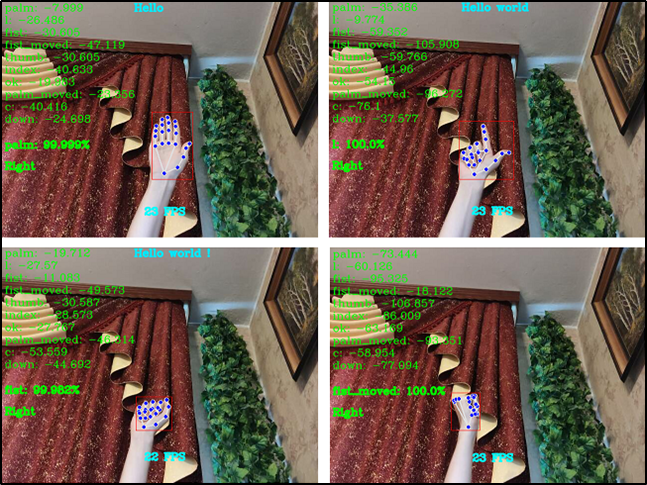

# -- Часть 3. Реализуем свой детектор руки и ключевых точек --

## Выберем архитектуру SSD

### Сначала опишем базовую модель VGG-16

Это модель, которая достаёт карты признаков из входного изображения, а дальше мы уже будем использовать эти карты признаков для детектора. Такие базовые модели содержат очень много параметров. Но так как они много где используются, то есть уже предтренированные варианты, откуда можно взять веса. Обучать предтренированную модель на какую-то задачу гораздо быстрее, чем обучать с нуля. А так как это не основная а только базовая модель, поверх которой будет еще много слоёв и параметров, то без предтренировочных весов само обучение заняло бы слишком много времени и мощностей.

В изначальном источнике используется модель VGG, так как на тот момент она была одной из лучших. Сейчас есть её предтренированный вариант, который решал задачу классификации на большой сборке изображений ImageNet.

In [ ]:
class VGGBase(nn.Module):
    """
    VGG base convolutions to produce lower-level feature maps.
    """

    def __init__(self):
        super().__init__()

        # Standard convolutional layers in VGG16
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)  # stride = 1, by default
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, ceil_mode=True)  # ceiling (not floor) here for even dims

        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.pool5 = nn.MaxPool2d(kernel_size=3, stride=1, padding=1)  # retains size because stride is 1 (and padding)

        # Replacements for FC6 and FC7 in VGG16
        self.conv6 = nn.Conv2d(512, 1024, kernel_size=3, padding=6, dilation=6)  # atrous convolution

        self.conv7 = nn.Conv2d(1024, 1024, kernel_size=1)

        # Load pretrained layers
        self.load_pretrained_layers()

    def forward(self, image):
        """
        Forward propagation.
        :param image: images, a tensor of dimensions (N, 3, 300, 300)
        :return: lower-level feature maps conv4_3 and conv7
        """
        out = F.relu(self.conv1_1(image))  # (N, 64, 300, 300)
        out = F.relu(self.conv1_2(out))  # (N, 64, 300, 300)
        out = self.pool1(out)  # (N, 64, 150, 150)

        out = F.relu(self.conv2_1(out))  # (N, 128, 150, 150)
        out = F.relu(self.conv2_2(out))  # (N, 128, 150, 150)
        out = self.pool2(out)  # (N, 128, 75, 75)

        out = F.relu(self.conv3_1(out))  # (N, 256, 75, 75)
        out = F.relu(self.conv3_2(out))  # (N, 256, 75, 75)
        out = F.relu(self.conv3_3(out))  # (N, 256, 75, 75)
        out = self.pool3(out)  # (N, 256, 38, 38), it would have been 37 if not for ceil_mode = True

        out = F.relu(self.conv4_1(out))  # (N, 512, 38, 38)
        out = F.relu(self.conv4_2(out))  # (N, 512, 38, 38)
        out = F.relu(self.conv4_3(out))  # (N, 512, 38, 38)
        conv4_3_feats = out  # (N, 512, 38, 38)
        out = self.pool4(out)  # (N, 512, 19, 19)

        out = F.relu(self.conv5_1(out))  # (N, 512, 19, 19)
        out = F.relu(self.conv5_2(out))  # (N, 512, 19, 19)
        out = F.relu(self.conv5_3(out))  # (N, 512, 19, 19)
        out = self.pool5(out)  # (N, 512, 19, 19), pool5 does not reduce dimensions

        out = F.relu(self.conv6(out))  # (N, 1024, 19, 19)

        conv7_feats = F.relu(self.conv7(out))  # (N, 1024, 19, 19)

        # Lower-level feature maps
        return conv4_3_feats, conv7_feats

    def load_pretrained_layers(self):
        """
        As in the paper, we use a VGG-16 pretrained on the ImageNet task as the base network.
        There's one available in PyTorch, see https://pytorch.org/docs/stable/torchvision/models.html#torchvision.models.vgg16
        We copy these parameters into our network. It's straightforward for conv1 to conv5.
        However, the original VGG-16 does not contain the conv6 and con7 layers.
        """
        # Current state of base
        state_dict = self.state_dict()
        param_names = list(state_dict.keys())

        # Pretrained VGG base
        pretrained_state_dict = torchvision.models.vgg16(pretrained=True).state_dict()
        pretrained_param_names = list(pretrained_state_dict.keys())

        # Transfer conv. parameters from pretrained model to current model
        for i, param in enumerate(param_names[:-4]):  # excluding conv6 and conv7 parameters
            state_dict[param] = pretrained_state_dict[pretrained_param_names[i]]

        self.load_state_dict(state_dict)

        print("\nLoaded base model.\n")


### Дополнительные слои для детектирования бОльших обьектов

In [ ]:
class ExtraLayers(nn.Module):
    """
    Additional convolutions to produce higher-level feature maps.
    """

    def __init__(self):
        super().__init__()

        # Additional convolutions on top of the VGG base
        self.conv8_1 = nn.Conv2d(1024, 256, kernel_size=1, padding=0)  # stride = 1, by default
        self.conv8_2 = nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1)  # dim. reduction because stride > 1

        self.conv9_1 = nn.Conv2d(512, 128, kernel_size=1, padding=0)
        self.conv9_2 = nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1)  # dim. reduction because stride > 1

        self.conv10_1 = nn.Conv2d(256, 128, kernel_size=1, padding=0)
        self.conv10_2 = nn.Conv2d(128, 256, kernel_size=3, padding=0)  # dim. reduction because padding = 0

        self.conv11_1 = nn.Conv2d(256, 128, kernel_size=1, padding=0)
        self.conv11_2 = nn.Conv2d(128, 256, kernel_size=3, padding=0)  # dim. reduction because padding = 0
        
    def forward(self, conv7_feats):
        """
        Forward propagation.
        :param conv7_feats: lower-level conv7 feature map, a tensor of dimensions (N, 1024, 19, 19)
        :return: higher-level feature maps conv8_2, conv9_2, conv10_2, and conv11_2
        """
        out = F.relu(self.conv8_1(conv7_feats))  # (N, 256, 19, 19)
        out = F.relu(self.conv8_2(out))  # (N, 512, 10, 10)
        conv8_2_feats = out  # (N, 512, 10, 10)

        out = F.relu(self.conv9_1(out))  # (N, 128, 10, 10)
        out = F.relu(self.conv9_2(out))  # (N, 256, 5, 5)
        conv9_2_feats = out  # (N, 256, 5, 5)

        out = F.relu(self.conv10_1(out))  # (N, 128, 5, 5)
        out = F.relu(self.conv10_2(out))  # (N, 256, 3, 3)
        conv10_2_feats = out  # (N, 256, 3, 3)

        out = F.relu(self.conv11_1(out))  # (N, 128, 3, 3)
        conv11_2_feats = F.relu(self.conv11_2(out))  # (N, 256, 1, 1)

        # Higher-level feature maps
        return conv8_2_feats, conv9_2_feats, conv10_2_feats, conv11_2_feats

### Слои для предсказания положения и классификации для каждых карт признаков

In [ ]:
class PredictionConvolutions(nn.Module):
    """
    Convolutions to predict class scores and bounding boxes using lower and higher-level feature maps.
    The bounding boxes (locations) are predicted as encoded offsets w.r.t each of the 8732 prior (default) boxes.
    The class scores represent the scores of each object class in each of the 8732 bounding boxes located.
    A high score for 'background' = no object.
    """

    def __init__(self, n_classes):
        """
        :param n_classes: number of different types of objects
        """
        super().__init__()

        self.n_classes = n_classes

        # Number of prior-boxes we are considering per position in each feature map
        n_boxes = {'conv4_3': 4,
                   'conv7': 6,
                   'conv8_2': 6,
                   'conv9_2': 6,
                   'conv10_2': 4,
                   'conv11_2': 4}
        # 4 prior-boxes implies we use 4 different aspect ratios, etc.

        # Localization prediction convolutions (predict offsets w.r.t prior-boxes)
        self.loc_conv4_3 = nn.Conv2d(512, n_boxes['conv4_3'] * 4, kernel_size=3, padding=1)
        self.loc_conv7 = nn.Conv2d(1024, n_boxes['conv7'] * 4, kernel_size=3, padding=1)
        self.loc_conv8_2 = nn.Conv2d(512, n_boxes['conv8_2'] * 4, kernel_size=3, padding=1)
        self.loc_conv9_2 = nn.Conv2d(256, n_boxes['conv9_2'] * 4, kernel_size=3, padding=1)
        self.loc_conv10_2 = nn.Conv2d(256, n_boxes['conv10_2'] * 4, kernel_size=3, padding=1)
        self.loc_conv11_2 = nn.Conv2d(256, n_boxes['conv11_2'] * 4, kernel_size=3, padding=1)

        # Class prediction convolutions (predict classes in localization boxes)
        self.cl_conv4_3 = nn.Conv2d(512, n_boxes['conv4_3'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv7 = nn.Conv2d(1024, n_boxes['conv7'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv8_2 = nn.Conv2d(512, n_boxes['conv8_2'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv9_2 = nn.Conv2d(256, n_boxes['conv9_2'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv10_2 = nn.Conv2d(256, n_boxes['conv10_2'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv11_2 = nn.Conv2d(256, n_boxes['conv11_2'] * n_classes, kernel_size=3, padding=1)

    def forward(self, conv4_3_feats, conv7_feats, conv8_2_feats, conv9_2_feats, conv10_2_feats, conv11_2_feats):
        """
        Forward propagation.
        :param conv4_3_feats: conv4_3 feature map, a tensor of dimensions (N, 512, 38, 38)
        :param conv7_feats: conv7 feature map, a tensor of dimensions (N, 1024, 19, 19)
        :param conv8_2_feats: conv8_2 feature map, a tensor of dimensions (N, 512, 10, 10)
        :param conv9_2_feats: conv9_2 feature map, a tensor of dimensions (N, 256, 5, 5)
        :param conv10_2_feats: conv10_2 feature map, a tensor of dimensions (N, 256, 3, 3)
        :param conv11_2_feats: conv11_2 feature map, a tensor of dimensions (N, 256, 1, 1)
        :return: 8732 locations and class scores (i.e. w.r.t each prior box) for each image
        """
        batch_size = conv4_3_feats.size(0)

        # Predict localization boxes' bounds (as offsets w.r.t prior-boxes)
        l_conv4_3 = self.loc_conv4_3(conv4_3_feats)  # (N, 16, 38, 38)
        l_conv4_3 = l_conv4_3.permute(0, 2, 3,
                                      1).contiguous()  # (N, 38, 38, 16), to match prior-box order (after .view())
        # (.contiguous() ensures it is stored in a contiguous chunk of memory, needed for .view() below)
        l_conv4_3 = l_conv4_3.view(batch_size, -1, 4)  # (N, 5776, 4), there are a total 5776 boxes on this feature map

        l_conv7 = self.loc_conv7(conv7_feats)  # (N, 24, 19, 19)
        l_conv7 = l_conv7.permute(0, 2, 3, 1).contiguous()  # (N, 19, 19, 24)
        l_conv7 = l_conv7.view(batch_size, -1, 4)  # (N, 2166, 4), there are a total 2116 boxes on this feature map

        l_conv8_2 = self.loc_conv8_2(conv8_2_feats)  # (N, 24, 10, 10)
        l_conv8_2 = l_conv8_2.permute(0, 2, 3, 1).contiguous()  # (N, 10, 10, 24)
        l_conv8_2 = l_conv8_2.view(batch_size, -1, 4)  # (N, 600, 4)

        l_conv9_2 = self.loc_conv9_2(conv9_2_feats)  # (N, 24, 5, 5)
        l_conv9_2 = l_conv9_2.permute(0, 2, 3, 1).contiguous()  # (N, 5, 5, 24)
        l_conv9_2 = l_conv9_2.view(batch_size, -1, 4)  # (N, 150, 4)

        l_conv10_2 = self.loc_conv10_2(conv10_2_feats)  # (N, 16, 3, 3)
        l_conv10_2 = l_conv10_2.permute(0, 2, 3, 1).contiguous()  # (N, 3, 3, 16)
        l_conv10_2 = l_conv10_2.view(batch_size, -1, 4)  # (N, 36, 4)

        l_conv11_2 = self.loc_conv11_2(conv11_2_feats)  # (N, 16, 1, 1)
        l_conv11_2 = l_conv11_2.permute(0, 2, 3, 1).contiguous()  # (N, 1, 1, 16)
        l_conv11_2 = l_conv11_2.view(batch_size, -1, 4)  # (N, 4, 4)

        # Predict classes in localization boxes
        c_conv4_3 = self.cl_conv4_3(conv4_3_feats)  # (N, 4 * n_classes, 38, 38)
        c_conv4_3 = c_conv4_3.permute(0, 2, 3,
                                      1).contiguous()  # (N, 38, 38, 4 * n_classes), to match prior-box order (after .view())
        c_conv4_3 = c_conv4_3.view(batch_size, -1,
                                   self.n_classes)  # (N, 5776, n_classes), there are a total 5776 boxes on this feature map

        c_conv7 = self.cl_conv7(conv7_feats)  # (N, 6 * n_classes, 19, 19)
        c_conv7 = c_conv7.permute(0, 2, 3, 1).contiguous()  # (N, 19, 19, 6 * n_classes)
        c_conv7 = c_conv7.view(batch_size, -1,
                               self.n_classes)  # (N, 2166, n_classes), there are a total 2116 boxes on this feature map

        c_conv8_2 = self.cl_conv8_2(conv8_2_feats)  # (N, 6 * n_classes, 10, 10)
        c_conv8_2 = c_conv8_2.permute(0, 2, 3, 1).contiguous()  # (N, 10, 10, 6 * n_classes)
        c_conv8_2 = c_conv8_2.view(batch_size, -1, self.n_classes)  # (N, 600, n_classes)

        c_conv9_2 = self.cl_conv9_2(conv9_2_feats)  # (N, 6 * n_classes, 5, 5)
        c_conv9_2 = c_conv9_2.permute(0, 2, 3, 1).contiguous()  # (N, 5, 5, 6 * n_classes)
        c_conv9_2 = c_conv9_2.view(batch_size, -1, self.n_classes)  # (N, 150, n_classes)

        c_conv10_2 = self.cl_conv10_2(conv10_2_feats)  # (N, 4 * n_classes, 3, 3)
        c_conv10_2 = c_conv10_2.permute(0, 2, 3, 1).contiguous()  # (N, 3, 3, 4 * n_classes)
        c_conv10_2 = c_conv10_2.view(batch_size, -1, self.n_classes)  # (N, 36, n_classes)

        c_conv11_2 = self.cl_conv11_2(conv11_2_feats)  # (N, 4 * n_classes, 1, 1)
        c_conv11_2 = c_conv11_2.permute(0, 2, 3, 1).contiguous()  # (N, 1, 1, 4 * n_classes)
        c_conv11_2 = c_conv11_2.view(batch_size, -1, self.n_classes)  # (N, 4, n_classes)

        # A total of 5776 + 2166 + 600 + 150 + 36 + 4 = 8732 boxes
        # Concatenate in this specific order (i.e. must match the order of the prior-boxes)
        locs = torch.cat([l_conv4_3, l_conv7, l_conv8_2, l_conv9_2, l_conv10_2, l_conv11_2], dim=1)  # (N, 8732, 4)
        classes_scores = torch.cat([c_conv4_3, c_conv7, c_conv8_2, c_conv9_2, c_conv10_2, c_conv11_2],
                                   dim=1)  # (N, 8732, n_classes)

        return locs, classes_scores

### Обьеденяя сети, которые были выше, получим SSD

Функции для преоброзования координат рамок

In [ ]:
def xy_to_cxcy(xy):
    """
    Convert bounding boxes from boundary coordinates (x_min, y_min, x_max, y_max) to center-size coordinates (c_x, c_y, w, h).
    :param xy: bounding boxes in boundary coordinates, a tensor of size (n_boxes, 4)
    :return: bounding boxes in center-size coordinates, a tensor of size (n_boxes, 4)
    """
    return torch.cat([(xy[:, 2:] + xy[:, :2]) / 2,  # c_x, c_y
                      xy[:, 2:] - xy[:, :2]], 1)  # w, h


def cxcy_to_xy(cxcy):
    """
    Convert bounding boxes from center-size coordinates (c_x, c_y, w, h) to boundary coordinates (x_min, y_min, x_max, y_max).
    :param cxcy: bounding boxes in center-size coordinates, a tensor of size (n_boxes, 4)
    :return: bounding boxes in boundary coordinates, a tensor of size (n_boxes, 4)
    """
    return torch.cat([cxcy[:, :2] - (cxcy[:, 2:] / 2),  # x_min, y_min
                      cxcy[:, :2] + (cxcy[:, 2:] / 2)], 1)  # x_max, y_max


def cxcy_to_gcxgcy(cxcy, priors_cxcy):
    """
    Encode bounding boxes (that are in center-size form) w.r.t. the corresponding prior boxes (that are in center-size form).
    For the center coordinates, find the offset with respect to the prior box, and scale by the size of the prior box.
    For the size coordinates, scale by the size of the prior box, and convert to the log-space.
    In the model, we are predicting bounding box coordinates in this encoded form.
    :param cxcy: bounding boxes in center-size coordinates, a tensor of size (n_priors, 4)
    :param priors_cxcy: prior boxes with respect to which the encoding must be performed, a tensor of size (n_priors, 4)
    :return: encoded bounding boxes, a tensor of size (n_priors, 4)
    """
    
    # The 10 and 5 below are referred to as 'variances' in the original Caffe repo, completely empirical
    # They are for some sort of numerical conditioning, for 'scaling the localization gradient'
    # See https://github.com/weiliu89/caffe/issues/155
    return torch.cat([(cxcy[:, :2] - priors_cxcy[:, :2]) / (priors_cxcy[:, 2:] / 10),  # g_c_x, g_c_y
                      torch.log(cxcy[:, 2:] / priors_cxcy[:, 2:]) * 5], 1)  # g_w, g_h


def gcxgcy_to_cxcy(gcxgcy, priors_cxcy):
    """
    Decode bounding box coordinates predicted by the model, since they are encoded in the form mentioned above.
    They are decoded into center-size coordinates.
    This is the inverse of the function above.
    :param gcxgcy: encoded bounding boxes, i.e. output of the model, a tensor of size (n_priors, 4)
    :param priors_cxcy: prior boxes with respect to which the encoding is defined, a tensor of size (n_priors, 4)
    :return: decoded bounding boxes in center-size form, a tensor of size (n_priors, 4)
    """

    return torch.cat([gcxgcy[:, :2] * priors_cxcy[:, 2:] / 10 + priors_cxcy[:, :2],  # c_x, c_y
                      torch.exp(gcxgcy[:, 2:] / 5) * priors_cxcy[:, 2:]], 1)  # w, h

Функции для нахождения метрики IoU

In [ ]:
def find_intersection(set_1, set_2):
    """
    Find the intersection of every box combination between two sets of boxes that are in boundary coordinates.
    :param set_1: set 1, a tensor of dimensions (n1, 4)
    :param set_2: set 2, a tensor of dimensions (n2, 4)
    :return: intersection of each of the boxes in set 1 with respect to each of the boxes in set 2, a tensor of dimensions (n1, n2)
    """

    # PyTorch auto-broadcasts singleton dimensions
    lower_bounds = torch.max(set_1[:, :2].unsqueeze(1), set_2[:, :2].unsqueeze(0))  # (n1, n2, 2)
    upper_bounds = torch.min(set_1[:, 2:].unsqueeze(1), set_2[:, 2:].unsqueeze(0))  # (n1, n2, 2)
    intersection_dims = torch.clamp(upper_bounds - lower_bounds, min=0)  # (n1, n2, 2)
    return intersection_dims[:, :, 0] * intersection_dims[:, :, 1]  # (n1, n2)


def find_jaccard_overlap(set_1, set_2):
    """
    Find the Jaccard Overlap (IoU) of every box combination between two sets of boxes that are in boundary coordinates.
    :param set_1: set 1, a tensor of dimensions (n1, 4)
    :param set_2: set 2, a tensor of dimensions (n2, 4)
    :return: Jaccard Overlap of each of the boxes in set 1 with respect to each of the boxes in set 2, a tensor of dimensions (n1, n2)
    """

    # Find intersections
    intersection = find_intersection(set_1, set_2)  # (n1, n2)

    # Find areas of each box in both sets
    areas_set_1 = (set_1[:, 2] - set_1[:, 0]) * (set_1[:, 3] - set_1[:, 1])  # (n1)
    areas_set_2 = (set_2[:, 2] - set_2[:, 0]) * (set_2[:, 3] - set_2[:, 1])  # (n2)

    # Find the union
    # PyTorch auto-broadcasts singleton dimensions
    union = areas_set_1.unsqueeze(1) + areas_set_2.unsqueeze(0) - intersection  # (n1, n2)

    return intersection / union  # (n1, n2)

Сама модель

In [ ]:
class SSD300(nn.Module):
    """
    The SSD300 network - unite the base VGG network, auxiliary, and prediction convolutions.
    """

    def __init__(self, n_classes):
        super().__init__()

        self.n_classes = n_classes

        self.base = VGGBase()
        self.aux_convs = ExtraLayers()
        self.pred_convs = PredictionConvolutions(n_classes)

        # Since lower level features (conv4_3_feats) have considerably larger scales, we take the L2 norm and rescale
        # Rescale factor is initially set at 20, but is learned for each channel during back-prop
        self.rescale_factors = nn.Parameter(torch.FloatTensor(1, 512, 1, 1))  # there are 512 channels in conv4_3_feats
        nn.init.constant_(self.rescale_factors, 20)

        # Prior boxes
        self.priors_cxcy = self.create_prior_boxes()

    def forward(self, image):
        """
        Forward propagation.
        :param image: images, a tensor of dimensions (N, 3, 300, 300)
        :return: 8732 locations and class scores (i.e. w.r.t each prior box) for each image
        """
        # Run VGG base network convolutions (lower level feature map generators)
        conv4_3_feats, conv7_feats = self.base(image)  # (N, 512, 38, 38), (N, 1024, 19, 19)

        # Rescale conv4_3 after L2 norm
        norm = conv4_3_feats.pow(2).sum(dim=1, keepdim=True).sqrt()  # (N, 1, 38, 38)
        conv4_3_feats = conv4_3_feats / norm  # (N, 512, 38, 38)
        conv4_3_feats = conv4_3_feats * self.rescale_factors  # (N, 512, 38, 38)
        # (PyTorch autobroadcasts singleton dimensions during arithmetic)

        # Run auxiliary convolutions (higher level feature map generators)
        conv8_2_feats, conv9_2_feats, conv10_2_feats, conv11_2_feats = \
            self.aux_convs(conv7_feats)  # (N, 512, 10, 10),  (N, 256, 5, 5), (N, 256, 3, 3), (N, 256, 1, 1)

        # Run prediction convolutions (predict offsets w.r.t prior-boxes and classes in each resulting localization box)
        locs, classes_scores = self.pred_convs(conv4_3_feats, conv7_feats, conv8_2_feats, conv9_2_feats, conv10_2_feats,
                                               conv11_2_feats)  # (N, 8732, 4), (N, 8732, n_classes)

        return locs, classes_scores

    def create_prior_boxes(self):
        """
        Create the 8732 prior (default) boxes for the SSD300, as defined in the paper.
        :return: prior boxes in center-size coordinates, a tensor of dimensions (8732, 4)
        """
        fmap_dims = {'conv4_3': 38,
                     'conv7': 19,
                     'conv8_2': 10,
                     'conv9_2': 5,
                     'conv10_2': 3,
                     'conv11_2': 1}

        obj_scales = {'conv4_3': 0.1,
                      'conv7': 0.2,
                      'conv8_2': 0.375,
                      'conv9_2': 0.55,
                      'conv10_2': 0.725,
                      'conv11_2': 0.9}

        aspect_ratios = {'conv4_3': [1., 2., 0.5],
                         'conv7': [1., 2., 3., 0.5, .333],
                         'conv8_2': [1., 2., 3., 0.5, .333],
                         'conv9_2': [1., 2., 3., 0.5, .333],
                         'conv10_2': [1., 2., 0.5],
                         'conv11_2': [1., 2., 0.5]}

        fmaps = list(fmap_dims.keys())

        prior_boxes = []

        for k, fmap in enumerate(fmaps):
            for i in range(fmap_dims[fmap]):
                for j in range(fmap_dims[fmap]):
                    cx = (j + 0.5) / fmap_dims[fmap]
                    cy = (i + 0.5) / fmap_dims[fmap]

                    for ratio in aspect_ratios[fmap]:
                        prior_boxes.append([cx, cy, obj_scales[fmap] * np.sqrt(ratio), obj_scales[fmap] / np.sqrt(ratio)])

                        # For an aspect ratio of 1, use an additional prior whose scale is the geometric mean of the
                        # scale of the current feature map and the scale of the next feature map
                        if ratio == 1.:
                            try:
                                additional_scale = np.sqrt(obj_scales[fmap] * obj_scales[fmaps[k + 1]])
                            # For the last feature map, there is no "next" feature map
                            except IndexError:
                                additional_scale = 1.
                            prior_boxes.append([cx, cy, additional_scale, additional_scale])

        prior_boxes = torch.FloatTensor(prior_boxes).to(device)  # (8732, 4)
        prior_boxes.clamp_(0, 1)  # (8732, 4)

        return prior_boxes
    
    def detect_objects(self, predicted_locs, predicted_scores, min_score, max_overlap, top_k):
        """
        Decipher the 8732 locations and class scores (output of ths SSD300) to detect objects.
        For each class, perform Non-Maximum Suppression (NMS) on boxes that are above a minimum threshold.
        :param predicted_locs: predicted locations/boxes w.r.t the 8732 prior boxes, a tensor of dimensions (N, 8732, 4)
        :param predicted_scores: class scores for each of the encoded locations/boxes, a tensor of dimensions (N, 8732, n_classes)
        :param min_score: minimum threshold for a box to be considered a match for a certain class
        :param max_overlap: maximum overlap two boxes can have so that the one with the lower score is not suppressed via NMS
        :param top_k: if there are a lot of resulting detection across all classes, keep only the top 'k'
        :return: detections (boxes, labels, and scores), lists of length batch_size
        """
        batch_size = predicted_locs.size(0)
        n_priors = self.priors_cxcy.size(0)
        predicted_scores = F.softmax(predicted_scores, dim=2)  # (N, 8732, n_classes)

        # Lists to store final predicted boxes, labels, and scores for all images
        all_images_boxes = list()
        all_images_labels = list()
        all_images_scores = list()

        assert n_priors == predicted_locs.size(1) == predicted_scores.size(1)

        for i in range(batch_size):
            # Decode object coordinates from the form we regressed predicted boxes to
            decoded_locs = cxcy_to_xy(gcxgcy_to_cxcy(predicted_locs[i], self.priors_cxcy))  # (8732, 4), these are fractional pt. coordinates

            # Lists to store boxes and scores for this image
            image_boxes = list()
            image_labels = list()
            image_scores = list()

            max_scores, best_label = predicted_scores[i].max(dim=1)  # (8732)

            # Check for each class
            for c in range(1, self.n_classes):
                # Keep only predicted boxes and scores where scores for this class are above the minimum score
                class_scores = predicted_scores[i][:, c]  # (8732)
                score_above_min_score = class_scores > min_score  # torch.uint8 (byte) tensor, for indexing
                n_above_min_score = score_above_min_score.sum().item()
                if n_above_min_score == 0:
                    continue
                class_scores = class_scores[score_above_min_score]  # (n_qualified), n_min_score <= 8732
                class_decoded_locs = decoded_locs[score_above_min_score]  # (n_qualified, 4)

                # Sort predicted boxes and scores by scores
                class_scores, sort_ind = class_scores.sort(dim=0, descending=True)  # (n_qualified), (n_min_score)
                class_decoded_locs = class_decoded_locs[sort_ind]  # (n_min_score, 4)

                # Find the overlap between predicted boxes
                overlap = find_jaccard_overlap(class_decoded_locs, class_decoded_locs)  # (n_qualified, n_min_score)

                # Non-Maximum Suppression (NMS)

                # A torch.uint8 (byte) tensor to keep track of which predicted boxes to suppress
                # 1 implies suppress, 0 implies don't suppress
                suppress = torch.zeros((n_above_min_score), dtype=torch.uint8).to(device)  # (n_qualified)

                # Consider each box in order of decreasing scores
                for box in range(class_decoded_locs.size(0)):
                    # If this box is already marked for suppression
                    if suppress[box] == 1:
                        continue

                    # Suppress boxes whose overlaps (with this box) are greater than maximum overlap
                    # Find such boxes and update suppress indices
                    suppress = torch.max(suppress, overlap[box] > max_overlap)
                    # The max operation retains previously suppressed boxes, like an 'OR' operation

                    # Don't suppress this box, even though it has an overlap of 1 with itself
                    suppress[box] = 0

                # Store only unsuppressed boxes for this class
                
                image_boxes.append(class_decoded_locs[suppress == 0])
                image_labels.append(torch.LongTensor((1 - suppress).sum().item() * [c]).to(device))
                image_scores.append(class_scores[suppress == 0])

            # If no object in any class is found, store a placeholder for 'background'
            if len(image_boxes) == 0:
                image_boxes.append(torch.FloatTensor([[0., 0., 1., 1.]]).to(device))
                image_labels.append(torch.LongTensor([0]).to(device))
                image_scores.append(torch.FloatTensor([0.]).to(device))

            # Concatenate into single tensors
            image_boxes = torch.clip(torch.cat(image_boxes, dim=0), 0, 1)  # (n_objects, 4)
            image_labels = torch.cat(image_labels, dim=0)  # (n_objects)
            image_scores = torch.cat(image_scores, dim=0)  # (n_objects)
            n_objects = image_scores.size(0)

            # Keep only the top k objects
            if n_objects > top_k:
                image_scores, sort_ind = image_scores.sort(dim=0, descending=True)
                image_scores = image_scores[:top_k]  # (top_k)
                image_boxes = image_boxes[sort_ind][:top_k]  # (top_k, 4)
                image_labels = image_labels[sort_ind][:top_k]  # (top_k)

            # Append to lists that store predicted boxes and scores for all images
            all_images_boxes.append(image_boxes)
            all_images_labels.append(image_labels)
            all_images_scores.append(image_scores)

        return all_images_boxes, all_images_labels, all_images_scores  # lists of length batch_size

### Зададим ошибку, через которую будем обучать детектор

In [ ]:
class MultiBoxLoss(nn.Module):
    """
    The MultiBox loss, a loss function for object detection.
    This is a combination of:
    (1) a localization loss for the predicted locations of the boxes, and
    (2) a confidence loss for the predicted class scores.
    """

    def __init__(self, priors_cxcy, threshold=0.5, neg_pos_ratio=3, alpha=1.):
        super(MultiBoxLoss, self).__init__()
        self.priors_cxcy = priors_cxcy
        self.priors_xy = cxcy_to_xy(priors_cxcy)
        self.threshold = threshold
        self.neg_pos_ratio = neg_pos_ratio
        self.alpha = alpha

        self.smooth_l1 = nn.SmoothL1Loss()
        self.cross_entropy = nn.CrossEntropyLoss(reduction='none')

    def forward(self, predicted_locs, predicted_scores, boxes, labels):
        """
        Forward propagation.
        :param predicted_locs: predicted locations/boxes w.r.t the 8732 prior boxes, a tensor of dimensions (N, 8732, 4)
        :param predicted_scores: class scores for each of the encoded locations/boxes, a tensor of dimensions (N, 8732, n_classes)
        :param boxes: true  object bounding boxes in boundary coordinates, a list of N tensors
        :param labels: true object labels, a list of N tensors
        :return: multibox loss, a scalar
        """
        batch_size = predicted_locs.size(0)
        n_priors = self.priors_cxcy.size(0)
        n_classes = predicted_scores.size(2)

        assert n_priors == predicted_locs.size(1) == predicted_scores.size(1)

        true_locs = torch.zeros((batch_size, n_priors, 4), dtype=torch.float).to(device)  # (N, 8732, 4)
        true_classes = torch.zeros((batch_size, n_priors), dtype=torch.long).to(device)  # (N, 8732)

        # For each image
        for i in range(batch_size):
            n_objects = boxes[i].size(0)

            overlap = find_jaccard_overlap(boxes[i],
                                           self.priors_xy)  # (n_objects, 8732)

            # For each prior, find the object that has the maximum overlap
            overlap_for_each_prior, object_for_each_prior = overlap.max(dim=0)  # (8732)

            # We don't want a situation where an object is not represented in our positive (non-background) priors -
            # 1. An object might not be the best object for all priors, and is therefore not in object_for_each_prior.
            # 2. All priors with the object may be assigned as background based on the threshold (0.5).

            # To remedy this -
            # First, find the prior that has the maximum overlap for each object.
            _, prior_for_each_object = overlap.max(dim=1)  # (N_o)

            # Then, assign each object to the corresponding maximum-overlap-prior. (This fixes 1.)
            object_for_each_prior[prior_for_each_object] = torch.LongTensor(range(n_objects)).to(device)

            # To ensure these priors qualify, artificially give them an overlap of greater than 0.5. (This fixes 2.)
            overlap_for_each_prior[prior_for_each_object] = 1.

            # Labels for each prior
            label_for_each_prior = labels[i][object_for_each_prior]  # (8732)
            # Set priors whose overlaps with objects are less than the threshold to be background (no object)
            label_for_each_prior[overlap_for_each_prior < self.threshold] = 0  # (8732)

            # Store
            true_classes[i] = label_for_each_prior
            
            # Encode center-size object coordinates into the form we regressed predicted boxes to
            true_locs[i] = cxcy_to_gcxgcy(xy_to_cxcy(boxes[i][object_for_each_prior]), self.priors_cxcy)  # (8732, 4)

        # Identify priors that are positive (object/non-background)
        positive_priors = true_classes != 0  # (N, 8732)

        # LOCALIZATION LOSS

        # Localization loss is computed only over positive (non-background) priors
        loc_loss = self.smooth_l1(predicted_locs[positive_priors], true_locs[positive_priors])  # (), scalar
        
        # Note: indexing with a torch.uint8 (byte) tensor flattens the tensor when indexing is across multiple dimensions (N & 8732)
        # So, if predicted_locs has the shape (N, 8732, 4), predicted_locs[positive_priors] will have (total positives, 4)

        # CONFIDENCE LOSS

        # Confidence loss is computed over positive priors and the most difficult (hardest) negative priors in each image
        # That is, FOR EACH IMAGE,
        # we will take the hardest (neg_pos_ratio * n_positives) negative priors, i.e where there is maximum loss
        # This is called Hard Negative Mining - it concentrates on hardest negatives in each image, and also minimizes pos/neg imbalance

        # Number of positive and hard-negative priors per image
        n_positives = positive_priors.sum(dim=1)  # (N)
        n_hard_negatives = self.neg_pos_ratio * n_positives  # (N)

        # First, find the loss for all priors
        conf_loss_all = self.cross_entropy(predicted_scores.view(-1, n_classes), true_classes.view(-1))  # (N * 8732)
        conf_loss_all = conf_loss_all.view(batch_size, n_priors)  # (N, 8732)

        # We already know which priors are positive
        conf_loss_pos = conf_loss_all[positive_priors]  # (sum(n_positives))

        # Next, find which priors are hard-negative
        # To do this, sort ONLY negative priors in each image in order of decreasing loss and take top n_hard_negatives
        conf_loss_neg = conf_loss_all.clone()  # (N, 8732)
        conf_loss_neg[positive_priors] = 0.  # (N, 8732), positive priors are ignored (never in top n_hard_negatives)
        conf_loss_neg, _ = conf_loss_neg.sort(dim=1, descending=True)  # (N, 8732), sorted by decreasing hardness
        hardness_ranks = torch.LongTensor(range(n_priors)).unsqueeze(0).expand_as(conf_loss_neg).to(device)  # (N, 8732)
        hard_negatives = hardness_ranks < n_hard_negatives.unsqueeze(1)  # (N, 8732)
        conf_loss_hard_neg = conf_loss_neg[hard_negatives]  # (sum(n_hard_negatives))

        # As in the paper, averaged over positive priors only, although computed over both positive and hard-negative priors
        conf_loss = (conf_loss_hard_neg.sum() + conf_loss_pos.sum()) / n_positives.sum().float()  # (), scalar

        # TOTAL LOSS

        return conf_loss + self.alpha * loc_loss

### Данные

HAnd Gesture Recognition Image Dataset

https://sc.link/AO5l

In [ ]:
!unzip -qq '/content/gdrive/MyDrive/Colab Notebooks/ann_subsample'
!unzip -qq '/content/gdrive/MyDrive/Colab Notebooks/subsample' -d '/content/subsample'

In [ ]:
data_dataset_hagrid = dict()
for gesture in os.listdir("./ann_subsample"):
    gesture_name = gesture.split('.')[0]
    with open(f"./ann_subsample/{gesture}") as json_data:
        data_dataset_hagrid[gesture_name] = json.load(json_data)
    for image_name in data_dataset_hagrid[gesture_name].keys():
        data_dataset_hagrid[gesture_name][image_name]['image'] = f"./subsample/{gesture_name}/{image_name}.jpg"

In [ ]:
len(data_dataset_hagrid['call'].keys())

100

In [ ]:
len(data_dataset_hagrid.keys())

18

У каждого жеста 100 примеров. Всего жестов 18, получаем 1800 примеров. Оставим 20% для теста, на остальном будем обучаться. 

In [ ]:
test_size = 0.2

In [ ]:
data_train_hagrid = dict()
data_test_hagrid = dict()
for gesture in data_dataset_hagrid.keys():
    data_train_hagrid[gesture] = list(data_dataset_hagrid[gesture].values())[:int((1 - test_size) * len(data_dataset_hagrid[gesture].keys()))]
    data_test_hagrid[gesture] = list(data_dataset_hagrid[gesture].values())[int((1 - test_size) * len(data_dataset_hagrid[gesture].keys())):]

In [ ]:
len(data_train_hagrid['call'])

80

In [ ]:
len(data_test_hagrid['call'])

20

### Dataset

In [ ]:
class Dataset_detector(Dataset):
    def __init__(self, data, tfms):
        
        data = copy.deepcopy(data)
        self.data = []
        for gesture in data.keys():
            self.data.extend(data[gesture])
        
        # приводим координаты к виду x_min, y_min, x_max, y_max от вида x_min, y_min, w, h
        for k in self.data:
            for bbox in k['bboxes']:
                bbox[2] = bbox[0] + bbox[2]
                bbox[3] = bbox[1] + bbox[3]
        
        # максимальное количество жестов на изображении
        self.max_ges = max(len(k['bboxes']) for k in self.data)
        
        self.tfms = tfms

    def __getitem__(self, index):

        img = cv2.imread(self.data[index]['image'])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = self.tfms(img)
        
        bboxes = torch.tensor(self.data[index]['bboxes'] + [[0, 0, 1, 1]] * (self.max_ges-len(self.data[index]['bboxes'])))
        labels = torch.tensor([1] * len(self.data[index]['bboxes']) + [0] * (self.max_ges-len(self.data[index]['bboxes'])))

        return img, bboxes, labels

    def __len__(self):
        return len(self.data)

In [ ]:
SIZE = (300, 300)

In [ ]:
train_tfms = tt.Compose([tt.ToTensor(),
                         tt.Resize(SIZE, antialias=False)])
test_tfms = tt.Compose([tt.ToTensor(),
                        tt.Resize(SIZE, antialias=False)])

In [ ]:
train_dataset = Dataset_detector(data_train_hagrid, train_tfms)
test_dataset = Dataset_detector(data_test_hagrid, test_tfms)

### DataLoader

In [ ]:
BATCH_SIZE = 16

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)
test_loader= DataLoader(test_dataset, BATCH_SIZE, shuffle=True)

### Пример изображения

In [ ]:
def draw_boxes(in_img, boxes, labels, box_color=(255.,0.,0.), box_thickness=1):
    img = np.ascontiguousarray(in_img, dtype=np.uint8)
    box_color = np.array(box_color)
    # Отрисовываем boxs
    for i in range(boxes.shape[0]):
        if labels[i].item():
            x1 = int(boxes[i][0].item() * (SIZE[0] - 1))
            y1 = int(boxes[i][1].item() * (SIZE[1] - 1))
            x2 = int(boxes[i][2].item() * (SIZE[0] - 1))
            y2 = int(boxes[i][3].item() * (SIZE[1] - 1))
            img = cv2.rectangle(img, (x1, y1), (x2, y2), color=box_color, thickness=box_thickness)
    return img

In [ ]:
indx = 0
for img, bboxes, labels in test_loader:
    example_img, example_bboxes, example_labels = ((torch.permute(img[indx], (1, 2, 0)).numpy() * 255).astype(int), 
                                                    bboxes[indx], labels[indx])
    break

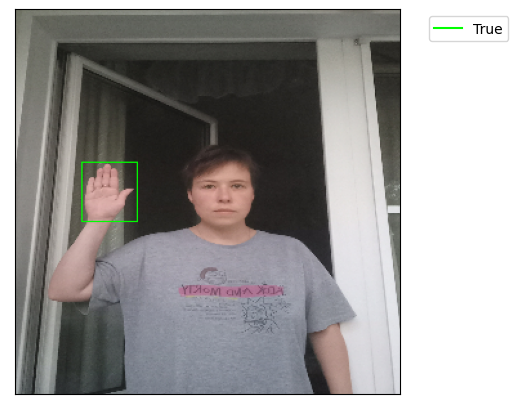

In [ ]:
plt.figure(figsize=(5, 5))
plt.imshow(draw_boxes(example_img, example_bboxes, example_labels, box_color=(0., 255., 0.)))
plt.xticks([])
plt.yticks([])
plt.xlim([0, SIZE[0] - 1])
plt.ylim([SIZE[0] - 1, 0])
plt.plot([-10, -9], [-10, -9], color=(0,1,0), label='True')
plt.legend(bbox_to_anchor=(1.3, 1.))
plt.show()

Узнаем метрику решения от mediapipe на тестовой выборке

Сопоставим реальные боксы с предсказанными по максимальной метрике IoU, лишние или недостающие предсказанные боксы будут давать метрику IoU = 0.

In [ ]:
def get_IoU(bboxs_orig, bboxs_pred):
  IoU = 0
  mask_orig = np.array([True] * len(bboxs_orig))
  mask_pred = np.array([True] * len(bboxs_pred))
  for _ in range(min(len(bboxs_orig), len(bboxs_pred))):
    IoU_max_orig, index_max_orig = find_jaccard_overlap(bboxs_orig[mask_orig], bboxs_pred[mask_pred]).max(0)
    IoU_max, index_max = IoU_max_orig.max(0)
    IoU += IoU_max.item() / max(len(bboxs_orig), len(bboxs_pred))
    mask_orig[index_max_orig[index_max]] = False
    mask_pred[index_max] = False
  return IoU

In [ ]:
hands = mp.solutions.hands.Hands(
        static_image_mode=False,
        min_detection_confidence=0.5,
        min_tracking_confidence=0.5,
        max_num_hands=10)
mediapipe_test_IoU = 0
for imgs, boxes, labels in tqdm(train_loader):
  test_IoU_n = 0
  for n in range(len(labels)):
    img = (torch.permute(imgs[n], (1,2,0)).numpy() * 255).astype(np.uint8).copy()
    image, hand_landmarks, handedness_index, bboxs_pred = hand_landmarks_detect(img, hands, 0.1, (255.,0.,0.), 
                                                            draw_landmarks = False, draw_bboxs = False, only_right = False)
    test_IoU_n += get_IoU(boxes[n][labels[n] == 1], torch.tensor(bboxs_pred) / (SIZE[0] - 1))
  mediapipe_test_IoU += test_IoU_n / len(labels)
mediapipe_test_IoU = round(mediapipe_test_IoU / len(train_loader), 6)
print("\nTest IoU (mediapipe):", mediapipe_test_IoU)

100%|██████████| 90/90 [03:03<00:00,  2.03s/it]


Test IoU (mediapipe): 0.611833


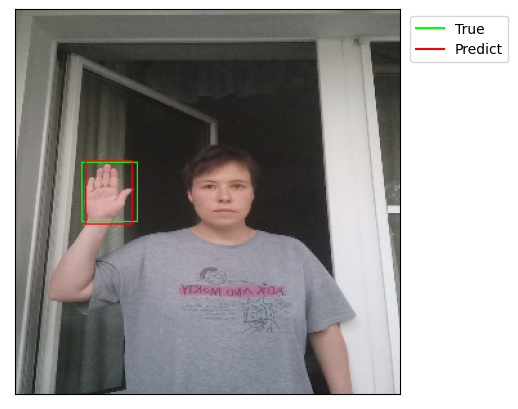

In [ ]:
img = draw_boxes(example_img, example_bboxes, example_labels, box_color=(0.,255.,0.))
img_mp = np.ascontiguousarray(img, dtype=np.uint8)
img, hand_landmarks, handedness_index, bboxs_pred = hand_landmarks_detect(img_mp, hands, 0.1, (255.,0.,0.), 
                                                        draw_landmarks = False, draw_bboxs = True, 
                                                            only_right = False, thickness_boxes = 1)
plt.figure(figsize=(5, 5))
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.xlim([0, SIZE[0] - 1])
plt.ylim([SIZE[0] - 1, 0])
plt.plot([-10, -9], [-10, -9], color=(0,1,0), label='True')
plt.plot([-10, -9], [-10, -9], color=(1,0,0), label='Predict')
plt.legend(bbox_to_anchor=(1.3, 1.))
plt.show()

### Обучение

Модель

In [ ]:
model = SSD300(n_classes = 2)
model = model.to(device)
model.train()

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Loaded base model.



SSD300(
  (base): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512, kernel_size=(3, 3), 

In [ ]:
print("Количество параметров: ", sum([param.numel() for param in model.parameters()]))

Количество параметров:  23745908


Оптимизатор и ошибка

In [ ]:
# Initialize the optimizer, with twice the default learning rate for biases, as in the original Caffe repo
biases = list()
not_biases = list()
for param_name, param in model.named_parameters():
    if param.requires_grad:
        if param_name.endswith('.bias'):
            biases.append(param)
        else:
            not_biases.append(param)
optimizer = torch.optim.SGD(params=[{'params': biases, 'lr': 2 * 0.001}, {'params': not_biases}],
                                    lr=0.001, momentum=0.9, weight_decay=0.0005)
criterion = MultiBoxLoss(priors_cxcy = model.priors_cxcy, threshold=0.5, neg_pos_ratio=3, alpha=20.)

Обучение

100%|██████████| 90/90 [02:12<00:00,  1.48s/it]


Epochs: 1 | Train Loss:  14.078131         | Train IoU:  0.208759         | Test Loss:  13.048200         | Test IoU:  0.325291


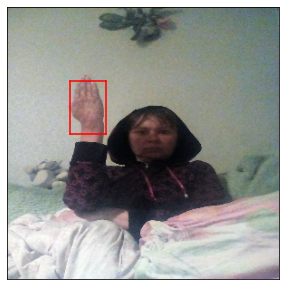

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 2 | Train Loss:  11.319381         | Train IoU:  0.360280         | Test Loss:  11.085026         | Test IoU:  0.369466


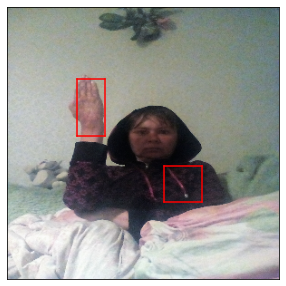

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 3 | Train Loss:  9.310585         | Train IoU:  0.424778         | Test Loss:  10.323057         | Test IoU:  0.393444


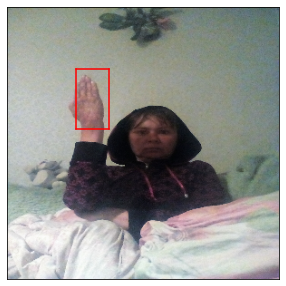

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 4 | Train Loss:  7.645678         | Train IoU:  0.478446         | Test Loss:  9.271589         | Test IoU:  0.449442


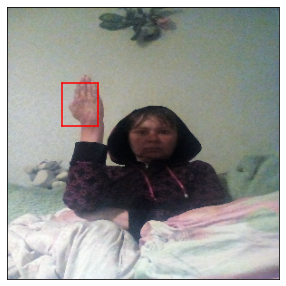

100%|██████████| 90/90 [02:05<00:00,  1.40s/it]


Epochs: 5 | Train Loss:  6.206832         | Train IoU:  0.526287         | Test Loss:  8.532517         | Test IoU:  0.479869


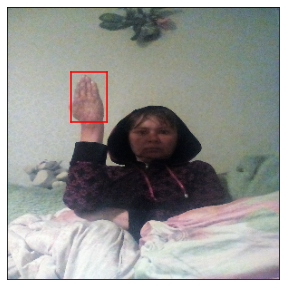

100%|██████████| 90/90 [02:08<00:00,  1.43s/it]


Epochs: 6 | Train Loss:  5.239365         | Train IoU:  0.559694         | Test Loss:  7.860538         | Test IoU:  0.512986


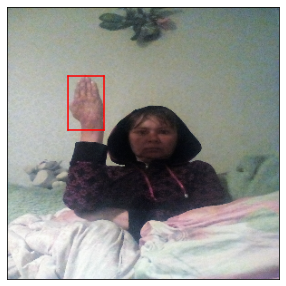

100%|██████████| 90/90 [02:05<00:00,  1.40s/it]


Epochs: 7 | Train Loss:  4.372688         | Train IoU:  0.606762         | Test Loss:  7.001181         | Test IoU:  0.532772


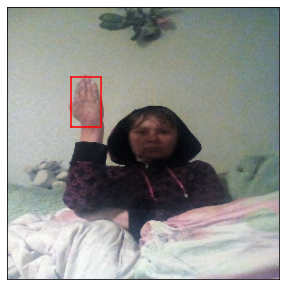

100%|██████████| 90/90 [02:04<00:00,  1.39s/it]


Epochs: 8 | Train Loss:  3.589704         | Train IoU:  0.634705         | Test Loss:  6.520823         | Test IoU:  0.550232


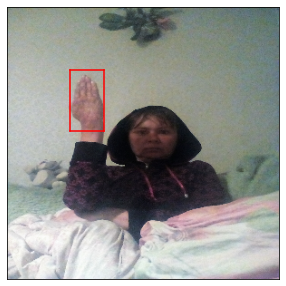

100%|██████████| 90/90 [02:05<00:00,  1.39s/it]


Epochs: 9 | Train Loss:  3.191634         | Train IoU:  0.657409         | Test Loss:  6.462485         | Test IoU:  0.564075


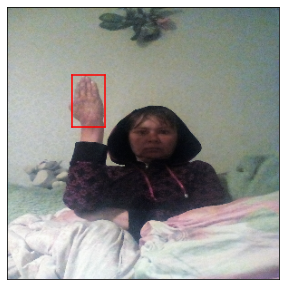

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 10 | Train Loss:  3.100429         | Train IoU:  0.672381         | Test Loss:  6.399247         | Test IoU:  0.545138


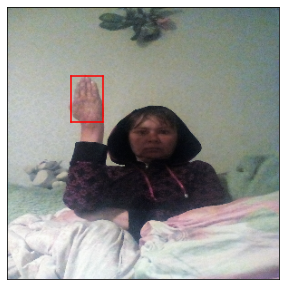

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 11 | Train Loss:  2.705641         | Train IoU:  0.693301         | Test Loss:  6.209903         | Test IoU:  0.568058


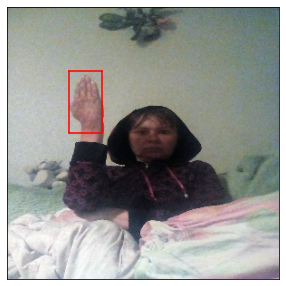

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 12 | Train Loss:  2.268206         | Train IoU:  0.719164         | Test Loss:  6.202179         | Test IoU:  0.571097


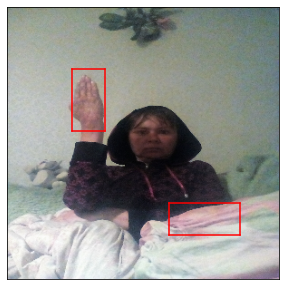

100%|██████████| 90/90 [02:05<00:00,  1.39s/it]


Epochs: 13 | Train Loss:  2.011692         | Train IoU:  0.731421         | Test Loss:  5.908752         | Test IoU:  0.574256


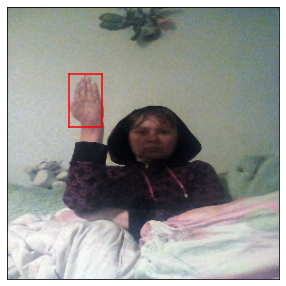

100%|██████████| 90/90 [02:05<00:00,  1.40s/it]


Epochs: 14 | Train Loss:  1.724519         | Train IoU:  0.749276         | Test Loss:  6.155248         | Test IoU:  0.574256


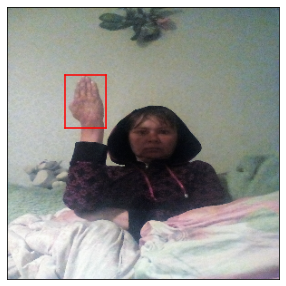

100%|██████████| 90/90 [02:05<00:00,  1.40s/it]


Epochs: 15 | Train Loss:  1.501307         | Train IoU:  0.771237         | Test Loss:  5.863719         | Test IoU:  0.592392


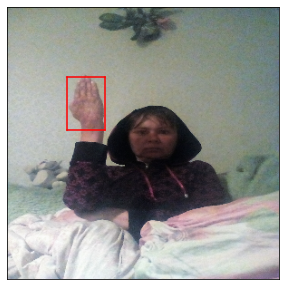

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 16 | Train Loss:  1.353596         | Train IoU:  0.785913         | Test Loss:  5.902365         | Test IoU:  0.590714


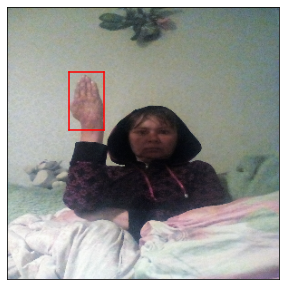

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 17 | Train Loss:  1.215300         | Train IoU:  0.798923         | Test Loss:  5.912610         | Test IoU:  0.590517


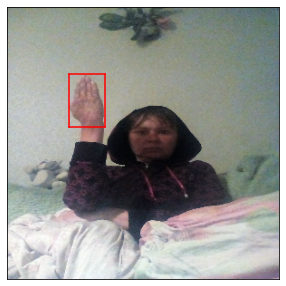

100%|██████████| 90/90 [02:05<00:00,  1.39s/it]


Epochs: 18 | Train Loss:  1.084062         | Train IoU:  0.809791         | Test Loss:  5.968979         | Test IoU:  0.593901


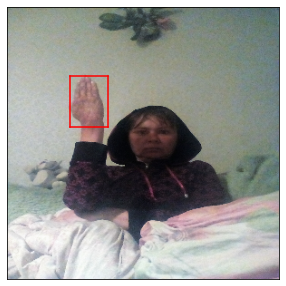

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 19 | Train Loss:  1.004070         | Train IoU:  0.824673         | Test Loss:  5.961918         | Test IoU:  0.592210


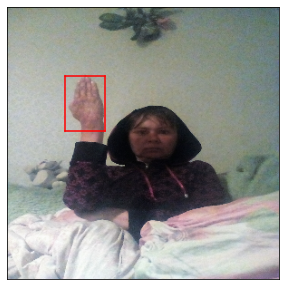

100%|██████████| 90/90 [02:05<00:00,  1.40s/it]


Epochs: 20 | Train Loss:  0.913700         | Train IoU:  0.834151         | Test Loss:  6.016657         | Test IoU:  0.590956


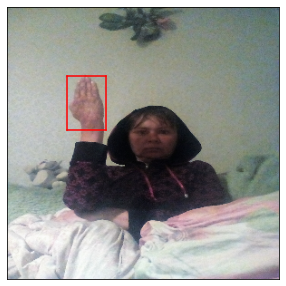

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 21 | Train Loss:  0.832775         | Train IoU:  0.839978         | Test Loss:  6.196920         | Test IoU:  0.592585


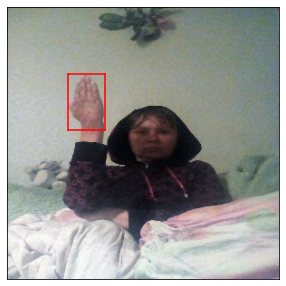

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 22 | Train Loss:  0.800716         | Train IoU:  0.859726         | Test Loss:  6.005386         | Test IoU:  0.594047


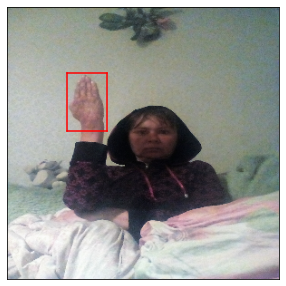

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 23 | Train Loss:  0.781881         | Train IoU:  0.866484         | Test Loss:  6.172930         | Test IoU:  0.598119


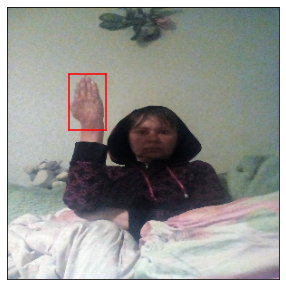

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 24 | Train Loss:  0.795257         | Train IoU:  0.870420         | Test Loss:  6.150829         | Test IoU:  0.593525


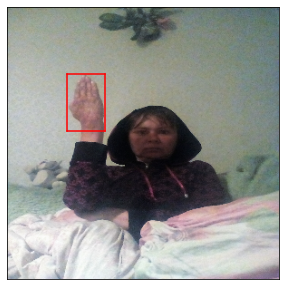

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 25 | Train Loss:  0.658534         | Train IoU:  0.885240         | Test Loss:  6.167609         | Test IoU:  0.596428


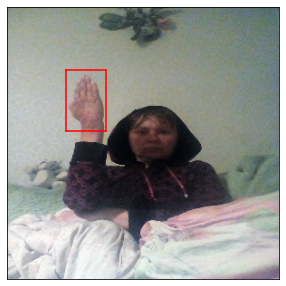

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 26 | Train Loss:  0.570668         | Train IoU:  0.898820         | Test Loss:  6.147944         | Test IoU:  0.602470


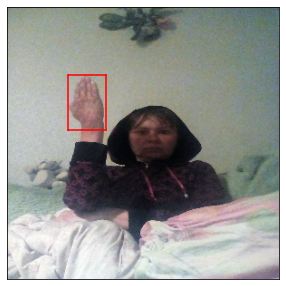

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 27 | Train Loss:  0.492675         | Train IoU:  0.912716         | Test Loss:  6.220973         | Test IoU:  0.599092


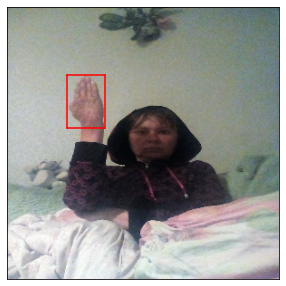

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 28 | Train Loss:  0.418085         | Train IoU:  0.922463         | Test Loss:  6.156863         | Test IoU:  0.599813


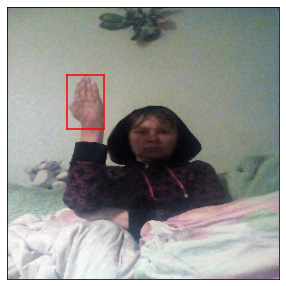

100%|██████████| 90/90 [02:05<00:00,  1.39s/it]


Epochs: 29 | Train Loss:  0.365380         | Train IoU:  0.931100         | Test Loss:  6.246978         | Test IoU:  0.600985


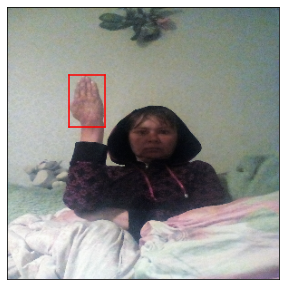

100%|██████████| 90/90 [02:06<00:00,  1.41s/it]


Epochs: 30 | Train Loss:  0.356085         | Train IoU:  0.933765         | Test Loss:  6.351999         | Test IoU:  0.600042


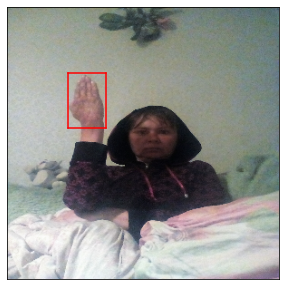

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 31 | Train Loss:  0.340687         | Train IoU:  0.936194         | Test Loss:  6.306978         | Test IoU:  0.603032


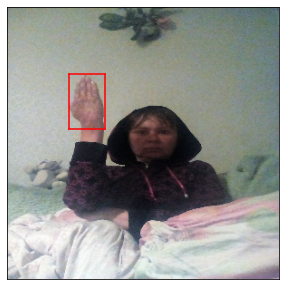

100%|██████████| 90/90 [02:07<00:00,  1.41s/it]


Epochs: 32 | Train Loss:  0.330464         | Train IoU:  0.939321         | Test Loss:  6.424237         | Test IoU:  0.601546


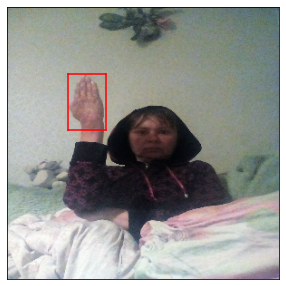

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 33 | Train Loss:  0.339797         | Train IoU:  0.939863         | Test Loss:  6.470657         | Test IoU:  0.595559


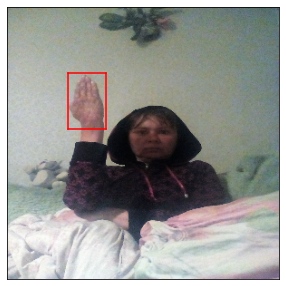

100%|██████████| 90/90 [02:06<00:00,  1.40s/it]


Epochs: 34 | Train Loss:  0.334433         | Train IoU:  0.940188         | Test Loss:  6.537955         | Test IoU:  0.603824


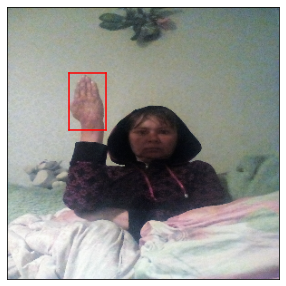

100%|██████████| 90/90 [02:07<00:00,  1.41s/it]


Epochs: 35 | Train Loss:  0.342492         | Train IoU:  0.937499         | Test Loss:  6.479896         | Test IoU:  0.602405


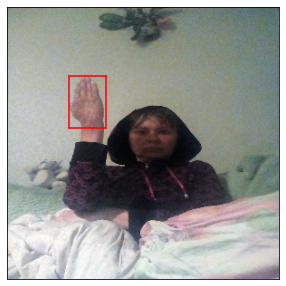

100%|██████████| 90/90 [02:07<00:00,  1.41s/it]


Epochs: 36 | Train Loss:  0.348577         | Train IoU:  0.937798         | Test Loss:  6.581215         | Test IoU:  0.599865


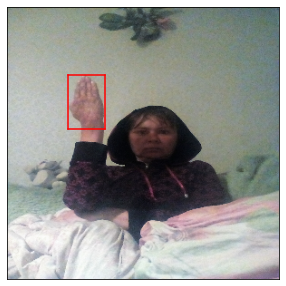

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 37 | Train Loss:  0.348634         | Train IoU:  0.938414         | Test Loss:  6.696874         | Test IoU:  0.600240


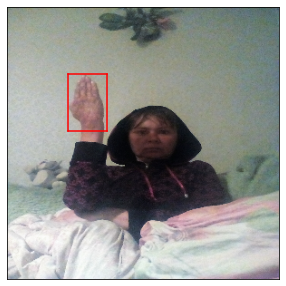

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 38 | Train Loss:  0.319780         | Train IoU:  0.939624         | Test Loss:  6.549403         | Test IoU:  0.598712


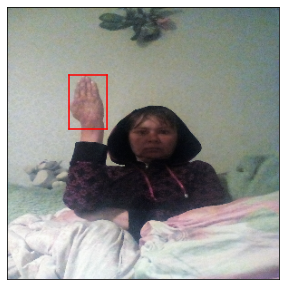

100%|██████████| 90/90 [02:08<00:00,  1.43s/it]


Epochs: 39 | Train Loss:  0.282796         | Train IoU:  0.942055         | Test Loss:  6.575957         | Test IoU:  0.601262


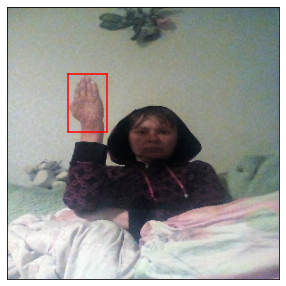

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 40 | Train Loss:  0.244499         | Train IoU:  0.949050         | Test Loss:  6.685611         | Test IoU:  0.595031


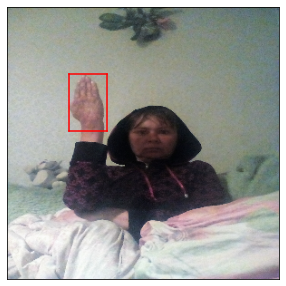

100%|██████████| 90/90 [02:08<00:00,  1.43s/it]


Epochs: 41 | Train Loss:  0.217201         | Train IoU:  0.954483         | Test Loss:  6.652968         | Test IoU:  0.605812


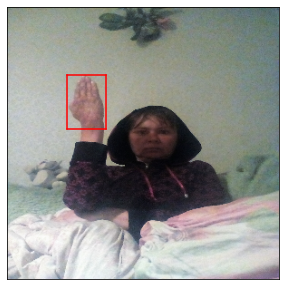

100%|██████████| 90/90 [02:09<00:00,  1.44s/it]


Epochs: 42 | Train Loss:  0.212342         | Train IoU:  0.955747         | Test Loss:  6.588115         | Test IoU:  0.604839


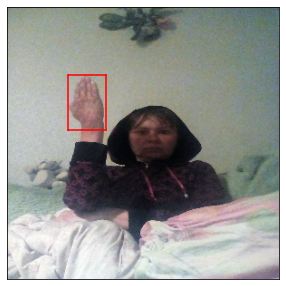

100%|██████████| 90/90 [02:08<00:00,  1.43s/it]


Epochs: 43 | Train Loss:  0.192848         | Train IoU:  0.958771         | Test Loss:  6.786775         | Test IoU:  0.593965


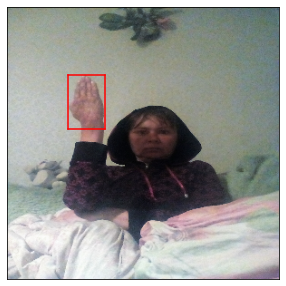

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 44 | Train Loss:  0.180519         | Train IoU:  0.960653         | Test Loss:  6.780627         | Test IoU:  0.599028


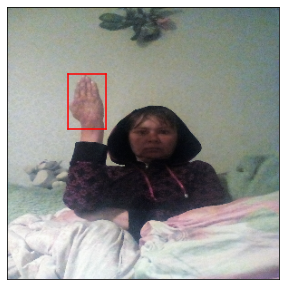

100%|██████████| 90/90 [02:07<00:00,  1.41s/it]


Epochs: 45 | Train Loss:  0.233458         | Train IoU:  0.958572         | Test Loss:  6.665489         | Test IoU:  0.600391


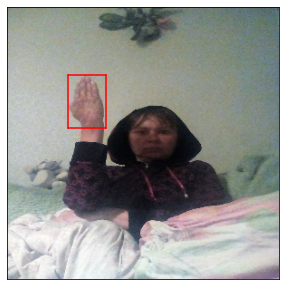

100%|██████████| 90/90 [02:07<00:00,  1.41s/it]


Epochs: 46 | Train Loss:  0.192134         | Train IoU:  0.959483         | Test Loss:  6.845901         | Test IoU:  0.598237


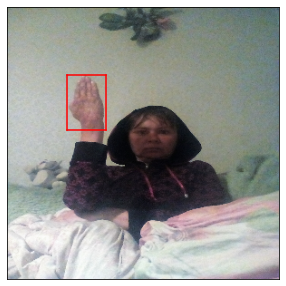

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 47 | Train Loss:  0.179918         | Train IoU:  0.960157         | Test Loss:  6.721030         | Test IoU:  0.603161


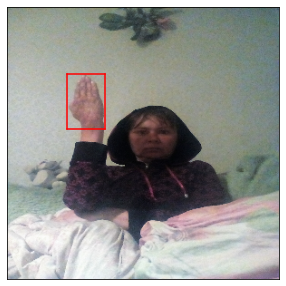

100%|██████████| 90/90 [02:08<00:00,  1.43s/it]


Epochs: 48 | Train Loss:  0.178966         | Train IoU:  0.959497         | Test Loss:  6.758680         | Test IoU:  0.605222


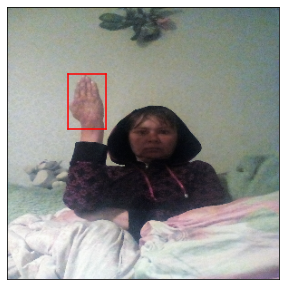

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 49 | Train Loss:  0.205654         | Train IoU:  0.955766         | Test Loss:  6.730703         | Test IoU:  0.602973


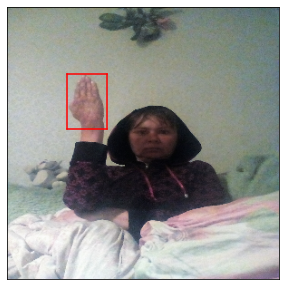

100%|██████████| 90/90 [02:07<00:00,  1.42s/it]


Epochs: 50 | Train Loss:  0.195172         | Train IoU:  0.955131         | Test Loss:  6.929831         | Test IoU:  0.597900


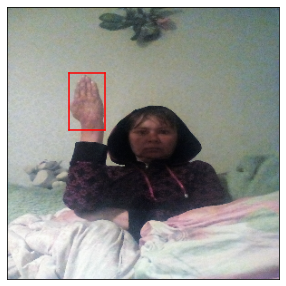

CPU times: user 2h 10min 11s, sys: 3min 9s, total: 2h 13min 21s
Wall time: 2h 11min 21s


In [ ]:
%%time

epochs = 50

train_list_loss = []
test_list_loss = []
train_list_IoU = []
test_list_IoU = []

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    train_IoU = 0
    test_IoU = 0
    
    model.train()  
    for img, boxes, labels in tqdm(train_loader):
        img = img.to(device)
        boxes = boxes.to(device)
        labels = labels.to(device)

        locs, classes_scores = model(img)
                
        loss = criterion(locs, classes_scores, boxes, labels)
        train_loss += loss.item()

        # IoU (Intersection over Union)
        train_IoU_n = 0
        pred_boxes, pred_labels, pred_scores = model.detect_objects(locs, classes_scores, min_score=0.5, max_overlap=0.1, top_k=10)
        for n in range(len(labels)):
          train_IoU_n += get_IoU(boxes[n][labels[n] == 1], pred_boxes[n][pred_labels[n] == 1])
        train_IoU += train_IoU_n / len(labels)
        
        model.zero_grad()
        loss.backward()
        optimizer.step()
        
    model.eval()
    for img, boxes, labels in test_loader:
        img = img.to(device)
        boxes = boxes.to(device)
        labels = labels.to(device)

        locs, classes_scores = model(img)
                
        loss = criterion(locs, classes_scores, boxes, labels)
        test_loss += loss.item()

        # IoU (Intersection over Union)
        test_IoU_n = 0
        pred_boxes, pred_labels, pred_scores = model.detect_objects(locs, classes_scores, min_score=0.5, max_overlap=0.1, top_k=10)
        for n in range(len(labels)):
          test_IoU_n += get_IoU(boxes[n][labels[n] == 1], pred_boxes[n][pred_labels[n] == 1])
        test_IoU += test_IoU_n / len(labels)
    
    print(
        f'Epochs: {epoch_num + 1} | Train Loss: {train_loss / len(train_loader): .6f} \
        | Train IoU: {train_IoU / len(train_loader): .6f} \
        | Test Loss: {test_loss / len(test_loader): .6f} \
        | Test IoU: {test_IoU / len(test_loader): .6f}')
    
    train_list_loss.append(round(train_loss / len(train_loader), 6))
    train_list_IoU.append(round(train_IoU / len(train_loader), 6))
    test_list_loss.append(round(test_loss / len(test_loader), 6))
    test_list_IoU.append(round(test_IoU / len(test_loader), 6))
    # пример
    example_img_tensor = torch.permute(torch.Tensor(example_img / 255), (2, 0, 1))[None, ..., ..., ...].to(device)
    locs, classes_scores = model(example_img_tensor)
    pred_boxes, pred_labels, pred_scores = model.detect_objects(locs, classes_scores, min_score=0.5, max_overlap=0.1, top_k=10)
    img = draw_boxes(example_img, example_bboxes, example_labels, box_color=(0,255,0))
    img = draw_boxes(img, pred_boxes[0], pred_labels[0], box_color=(255,0,0))
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.xlim([0, SIZE[0] - 1])
    plt.ylim([SIZE[0] - 1, 0])
    plt.plot([-10, -9], [-10, -9], color=(0,1,0), label='True')
    plt.plot([-10, -9], [-10, -9], color=(1,0,0), label='Predict')
    plt.legend(bbox_to_anchor=(1.3, 1.))
    plt.show()

### Визуализация обучения

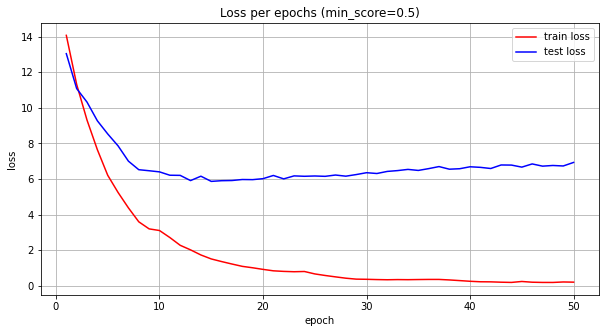

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_loss, 'r', label='train loss')
plt.plot(list(range(1, epochs+1)), test_list_loss, 'b', label='test loss')
plt.title('Loss per epochs (min_score=0.5)')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.grid()
plt.show()

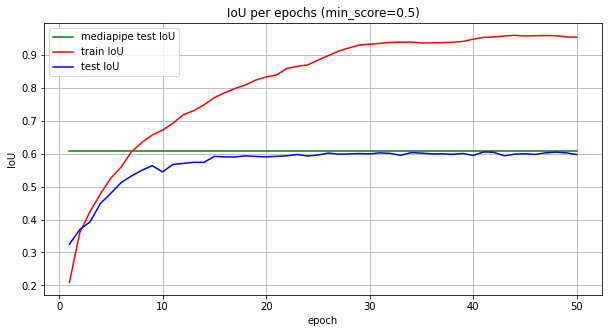

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), [mediapipe_test_IoU] * epochs, 'g', label='mediapipe test IoU')
plt.plot(list(range(1, epochs+1)), train_list_IoU, 'r', label='train IoU')
plt.plot(list(range(1, epochs+1)), test_list_IoU, 'b', label='test IoU')
plt.title('IoU per epochs (min_score=0.5)')
plt.xlabel('epoch')
plt.ylabel('IoU')
plt.legend()
plt.grid()
plt.show()

### Сохраним детектор:

In [ ]:
torch.save(model, '/content/gdrive/MyDrive/Colab Notebooks/hand_detector.pth')

### ------ checkpoint ------

### Загрузим детектор:

In [ ]:
hand_detector = torch.load('hand_detector.pth', map_location=torch.device('cuda')) 
hand_detector.eval()

SSD300(
  (base): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512, kernel_size=(3, 3), 

## Определение ключевых точек

### Данные

Hand Keypoint Detection in Single Images
using Multiview Bootstrapping
(Dataset)

In [ ]:
!unzip -qq '/content/gdrive/MyDrive/Colab Notebooks/hand_labels_synth'
!unzip -qq '/content/gdrive/MyDrive/Colab Notebooks/hand_labels'

In [ ]:
data_dataset_landmarks = []
stop_list = ['Ricki_unit_8.flv_000002_l.jpg', 'Ricki_unit_8.flv_000003_l.jpg']

Синтетические данные

Синтетические данные помогают лучше находить ветора пальцев, так как хоть они обычно и находятся в малореалистичном положении, но это положение очень информативно для нейронной сети, что помогает не переобучаться на определённые жесты

In [ ]:
for i in range(2, 5):
  data_scr = sorted(os.listdir(f"./hand_labels_synth/synth{i}"))
  for j in range(0, len(data_scr), 2):
    with open(f"./hand_labels_synth/synth{i}/" + data_scr[j+1]) as json_data:
      landmarks = json.load(json_data)['hand_pts']
      landmarks = np.array(landmarks)[:,:2]
      if data_scr[j] not in stop_list:
        data_dataset_landmarks.append([f"./hand_labels_synth/synth{i}/" + data_scr[j], landmarks])

Пример:

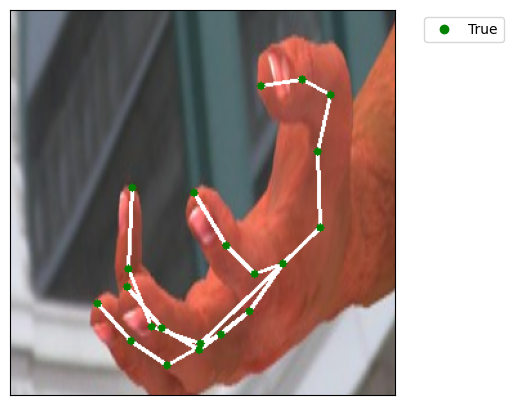

Реальные данные

In [ ]:
data_scr = sorted(os.listdir("./hand_labels/manual_train"))
for i in range(0, len(data_scr), 2):
  with open("./hand_labels/manual_train/" + data_scr[i+1]) as json_data:
    landmarks = json.load(json_data)['hand_pts']
    landmarks = np.array(landmarks)[:,:2]
    if data_scr[i] not in stop_list:
      data_dataset_landmarks.append(["./hand_labels/manual_train/" + data_scr[i], landmarks])

In [ ]:
data_scr = sorted(os.listdir("./hand_labels/manual_test"))
for i in range(0, len(data_scr), 2):
  with open("./hand_labels/manual_test/" + data_scr[i+1]) as json_data:
    landmarks = json.load(json_data)['hand_pts']
    landmarks = np.array(landmarks)[:,:2]
    if data_scr[i] not in stop_list:
      data_dataset_landmarks.append(["./hand_labels/manual_test/" + data_scr[i], landmarks])

In [ ]:
for gesture in data_train_hagrid.keys():
  for k in data_train_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        data_dataset_landmarks.append([k['image'], k['landmarks'][i]])

Для теста будем исспользовать только реальные данные

In [ ]:
test_hagrid = []
for gesture in data_test_hagrid.keys():
  for k in data_test_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        test_hagrid.append([k['image'], k['landmarks'][i]])

### Dataset

In [ ]:
class Dataset_landmarks(Dataset):
    def __init__(self, data, size, tfms, noise_v=(-0.2, 0.2), up_v=0.3):
        
        data = copy.deepcopy(data)
        self.size = size
        self.data = data
        self.noise_v = noise_v
        self.up_v = up_v
        
        self.tfms = tfms

    def __getitem__(self, index):
        # читаем изображение
        img = cv2.imread(self.data[index][0])
        shp = img.shape
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        landmarks = torch.Tensor(self.data[index][1])
        # приводим метки от 0 до 1
        if self.data[index][0][2] == 'h':
          landmarks[:,0] /= shp[1]
          landmarks[:,1] /= shp[0]
        # находим по ним box
        x_min_old = landmarks[:,0].min()
        y_min_old = landmarks[:,1].min()
        w = landmarks[:,0].max() - x_min_old
        h = landmarks[:,1].max() - y_min_old
        # random crop
        noise = np.random.randint(int(self.noise_v[0]*1000), int(self.noise_v[1]*1000), size=4)/1000
        x_min = np.clip(x_min_old + w*noise[0] - w*self.up_v, 0, 1)
        y_min = np.clip(y_min_old + h*noise[1] - h*(self.up_v), 0, 1)
        x_max = np.clip((x_min_old + w) + w*noise[2] + w*self.up_v, 0, 1)
        y_max = np.clip((y_min_old + h) + h*noise[3] + h*self.up_v, 0, 1)
        # приводим метки от -0.5 до 0.5
        landmarks[:,0] = (landmarks[:,0] - x_min)/(x_max - x_min) - 0.5
        landmarks[:,1] = (landmarks[:,1] - y_min)/(y_max - y_min) - 0.5
        x_min, y_min, x_max, y_max = (int(shp[1] * x_min), int(shp[0] * y_min), 
                                      int(shp[1] * x_max), int(shp[0] * y_max))
        # вырезаем box
        img = img[y_min:y_max, x_min:x_max]
        # приводим к одному размеру
        img = self.tfms(img)
        # horizontal flip
        rand_horizontal = np.random.randint(2)
        if rand_horizontal:
          img = img.flip(2)
          landmarks[:,0] = landmarks[:,0] * (-1)
        # vertical flip
        rand_vertical = np.random.randint(2)
        if rand_vertical:
          img = img.flip(1)
          landmarks[:,1] = landmarks[:,1] * (-1)
        # rotation and flip
        rand_rotation = np.random.randint(2)
        if rand_rotation:
          img = torch.permute(img, (0, 2, 1))
          landmarks_cl = landmarks.clone()
          landmarks[:,0] = landmarks_cl[:,1]
          landmarks[:,1] = landmarks_cl[:,0]

        return img, landmarks

    def __len__(self):
        return len(self.data)

In [ ]:
SIZE = (300, 300)

In [ ]:
train_tfms = tt.Compose([tt.ToTensor(),
                         tt.Resize(SIZE, antialias=False)])
test_tfms = tt.Compose([tt.ToTensor(),
                        tt.Resize(SIZE, antialias=False)])

In [ ]:
train_dataset = Dataset_landmarks(data_dataset_landmarks, SIZE, train_tfms)
test_dataset = Dataset_landmarks(test_hagrid, SIZE, test_tfms)

### DataLoader

In [ ]:
BATCH_SIZE = 16

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, BATCH_SIZE, shuffle=False)

### Пример изображения

In [ ]:
def draw_landmarks(in_img, landmarks, point_color=(0.,0.,255.), draw_skeleton=True, draw_points=True,
                   skeleton_color=(255.,255.,255.), skeleton_thickness=2, point_radius=3, size=SIZE):
    
    img = np.ascontiguousarray(in_img).astype(np.uint8)
    landmarks = np.array([[(l[0].item()+0.5)*size[0], (l[1].item()+0.5)*size[1]] for l in landmarks]).astype(int)
  
    # draw skeleton
    if draw_skeleton:
        for i in range(0, 4):
            img = cv2.line(img, landmarks[i], landmarks[i+1], color=skeleton_color, thickness=skeleton_thickness)
        img = cv2.line(img, landmarks[0], landmarks[5], color=skeleton_color, thickness=skeleton_thickness)
        for i in range(5, 8):
            img = cv2.line(img, landmarks[i], landmarks[i+1], color=skeleton_color, thickness=skeleton_thickness)
        img = cv2.line(img, landmarks[5], landmarks[9], color=skeleton_color, thickness=skeleton_thickness)
        for i in range(9, 12):
            img = cv2.line(img, landmarks[i], landmarks[i+1], color=skeleton_color, thickness=skeleton_thickness)
        img = cv2.line(img, landmarks[9], landmarks[13], color=skeleton_color, thickness=skeleton_thickness)
        for i in range(13, 16):
            img = cv2.line(img, landmarks[i], landmarks[i+1], color=skeleton_color, thickness=skeleton_thickness)
        img = cv2.line(img, landmarks[13], landmarks[17], color=skeleton_color, thickness=skeleton_thickness)
        for i in range(17, 20):
            img = cv2.line(img, landmarks[i], landmarks[i+1], color=skeleton_color, thickness=skeleton_thickness)
        img = cv2.line(img, landmarks[17], landmarks[0], color=skeleton_color, thickness=skeleton_thickness)

    # draw points
    if draw_points:
        for i in range(len(landmarks)):
            img = cv2.circle(img, landmarks[i], radius=point_radius, color=point_color, thickness=-1)
    
    return img

In [ ]:
indx = 0
for img, landmarks in test_loader:
    example_img, example_landmarks = (torch.permute(img[indx], (1, 2, 0)).numpy() * 255).astype(int), landmarks[indx]
    break

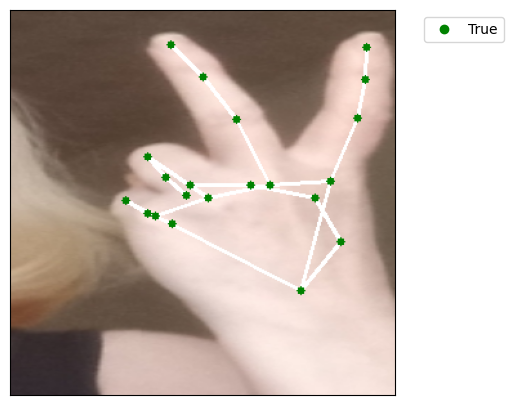

In [ ]:
plt.figure(figsize=(5, 5))
plt.imshow(draw_landmarks(example_img, example_landmarks, point_color=(0.,130.,0.)))
plt.xticks([])
plt.yticks([])
plt.xlim([0, SIZE[0] - 1])
plt.ylim([SIZE[0] - 1, 0])
plt.plot(-10, -10, 'o', color=(0,130/255,0), label='True')
plt.legend(bbox_to_anchor=(1.3, 1.))
plt.show()

### Модель

Будем использовать ту же предобученную модель, что использовали для детектора, VGG-16

In [ ]:
class Net_landmarks_detector(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        
        self.base_model = VGGBase()

        self.pool = nn.MaxPool2d(19)
        self.lin = nn.Linear(1024, num_classes*2, bias=False)
        
    def forward(self, x):

        _, out = self.base_model(x) # (N, 1024, 19, 19)
        out = self.pool(out) # (N, 1024, 1, 1)
        out = out.view(out.shape[0], -1) # (N, 1024)
        out = self.lin(out) # (N, 42)
        out = out.view(out.shape[0], -1, 2) # (N, 21, 2)

        return out

Узнаем MSE решения от mediapipe на тестовой выборке

In [ ]:
criterion = nn.MSELoss()
hands = mp.solutions.hands.Hands(
        static_image_mode=False,
        min_detection_confidence=0.9,
        min_tracking_confidence=0.9,
        max_num_hands=10)
mediapipe_test_mse = 0
num = 0
for imgs, landmarks in tqdm(test_loader):
  for n in range(len(landmarks)): 
    img = (torch.permute(imgs[n], (1,2,0)).numpy() * 255).astype(np.uint8).copy()
    image, pred_landmarks, handedness_index, bboxs_pred = hand_landmarks_detect(img, hands, 0.0, (255,0,0), draw_landmarks = True, draw_bboxs = False, only_right = False)
    if pred_landmarks is not None:
      pred_landmarks_list = []
      for landmark in pred_landmarks[0]:
        # убираю нормализацию landmarks
        x = (landmark[0] * (bboxs_pred[0][2] - bboxs_pred[0][0]) + bboxs_pred[0][0]) / SIZE[0] - 0.5
        y = (landmark[1] * (bboxs_pred[0][3] - bboxs_pred[0][1]) + bboxs_pred[0][1]) / SIZE[1] - 0.5
        pred_landmarks_list.append([x, y])
      mediapipe_test_mse += criterion(torch.Tensor(pred_landmarks_list), landmarks[n])
      num += 1
      """print(criterion(torch.Tensor(pred_landmarks_list), landmarks[n]))
      plt.imshow(image)
      # draw points
      for i in range(len(landmarks[n])):
        x = landmarks[n][i][0].item() * SIZE[0]
        y = landmarks[n][i][1].item() * SIZE[1]
        plt.plot(x, y, 'og')
      plt.show()"""
mediapipe_test_mse = round((mediapipe_test_mse / num).item(), 6)
print("\nTest MSE (mediapipe):", mediapipe_test_mse)
print(f"На {num} примерах")

100%|██████████| 31/31 [01:01<00:00,  1.98s/it]


Test MSE (mediapipe): 0.006928
На 204 примерах


(300, 300, 3)


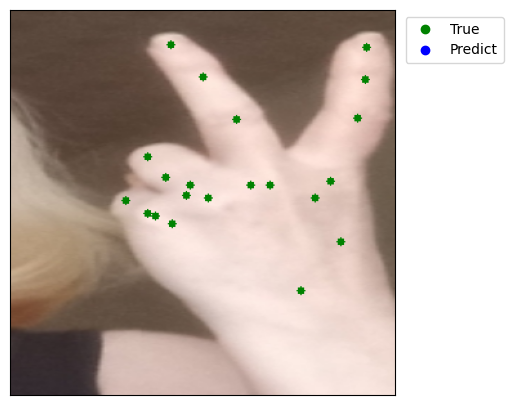

In [ ]:
print(example_img.shape)
plt.figure(figsize=(5, 5))

# draw points
img = draw_landmarks(example_img, example_landmarks, point_color=(0.,130.,0.), draw_skeleton=False)
img, hand_landmarks, handedness_index, bboxs_pred = hand_landmarks_detect(img.astype(np.uint8), hands, 0.1, (255,0,0), 
                                                        draw_landmarks = True, draw_bboxs = False, only_right = False)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.xlim([0, SIZE[0] - 1])
plt.ylim([SIZE[0] - 1, 0])
plt.plot(-10, -10, 'o', color=(0,130/255,0), label='True')
plt.plot(-10, -10, 'o', color=(0,0,1), label='Predict')
plt.legend(bbox_to_anchor=(1.3, 1.))
plt.show()

### Обучение

Модель

In [ ]:
model = Net_landmarks_detector(num_classes = 21)
model = model.to(device)
model.train()

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 143MB/s]



Loaded base model.



Net_landmarks_detector(
  (base_model): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512

In [ ]:
print("Количество параметров: ", sum([param.numel() for param in model.parameters()]))

Количество параметров:  20526912


In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=10**(-4))
criterion = nn.MSELoss()

Обучение

Сначала обучим общую базовую модель, которая научиться решать задачу вообщем понимании

100%|██████████| 779/779 [05:56<00:00,  2.19it/s]


Epochs: 1 | Train MSE:  0.025335         | Test MSE:  0.026192


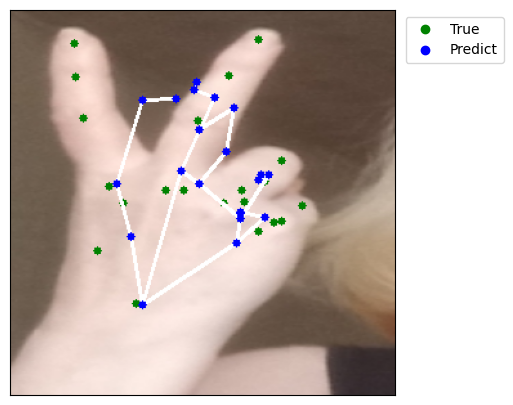

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 2 | Train MSE:  0.016538         | Test MSE:  0.021130


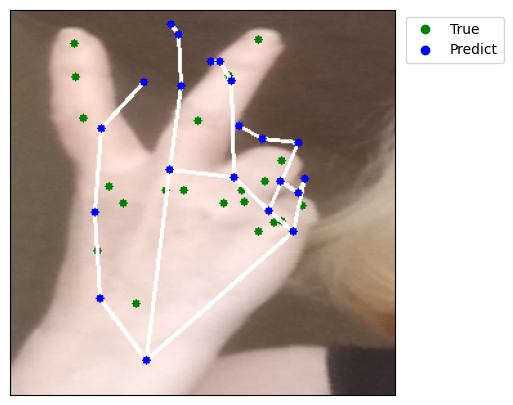

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 3 | Train MSE:  0.014249         | Test MSE:  0.018282


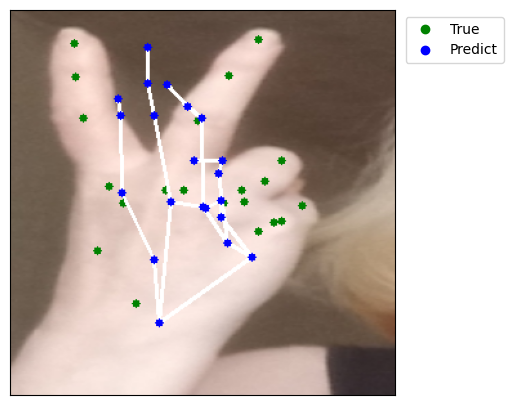

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 4 | Train MSE:  0.012741         | Test MSE:  0.016828


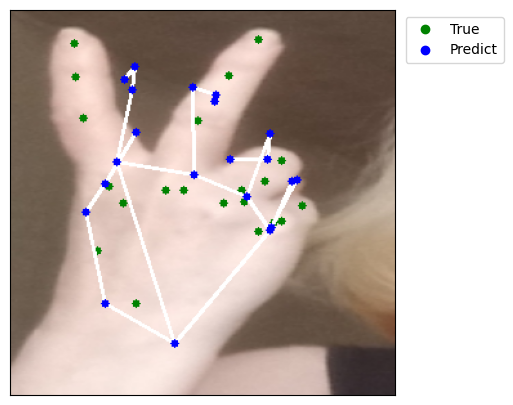

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 5 | Train MSE:  0.011859         | Test MSE:  0.015589


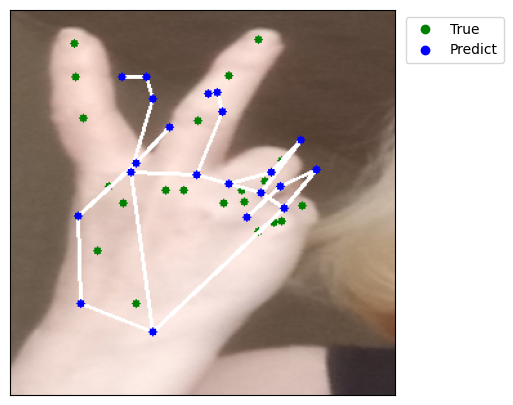

100%|██████████| 779/779 [05:56<00:00,  2.18it/s]


Epochs: 6 | Train MSE:  0.010870         | Test MSE:  0.013988


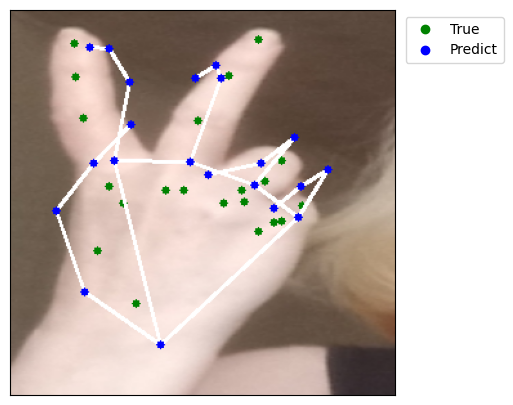

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 7 | Train MSE:  0.010164         | Test MSE:  0.012164


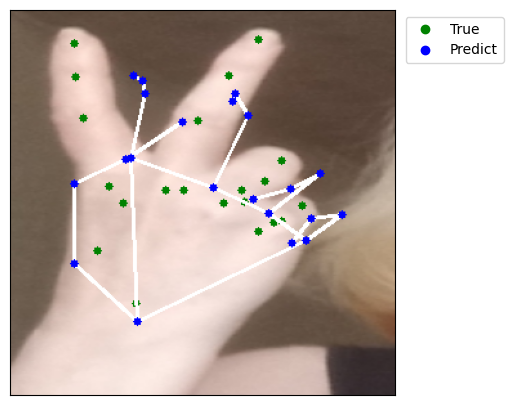

100%|██████████| 779/779 [05:57<00:00,  2.18it/s]


Epochs: 8 | Train MSE:  0.009817         | Test MSE:  0.011070


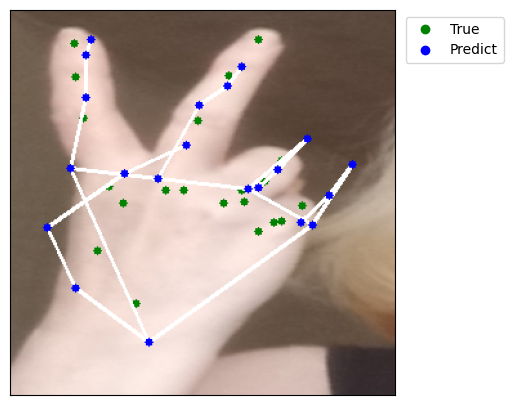

100%|██████████| 779/779 [06:00<00:00,  2.16it/s]


Epochs: 9 | Train MSE:  0.009294         | Test MSE:  0.010994


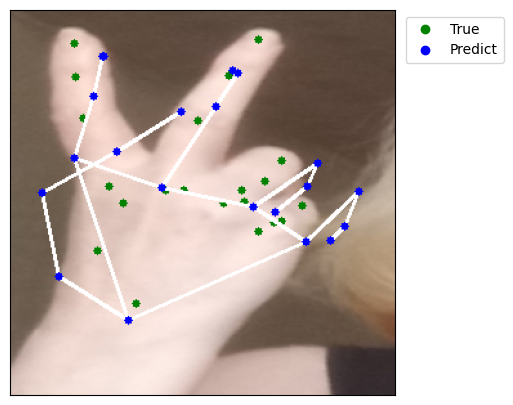

100%|██████████| 779/779 [06:00<00:00,  2.16it/s]


Epochs: 10 | Train MSE:  0.008855         | Test MSE:  0.010979


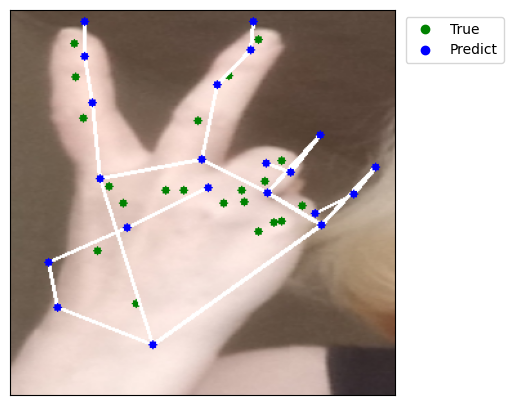

100%|██████████| 779/779 [05:57<00:00,  2.18it/s]


Epochs: 11 | Train MSE:  0.008547         | Test MSE:  0.010859


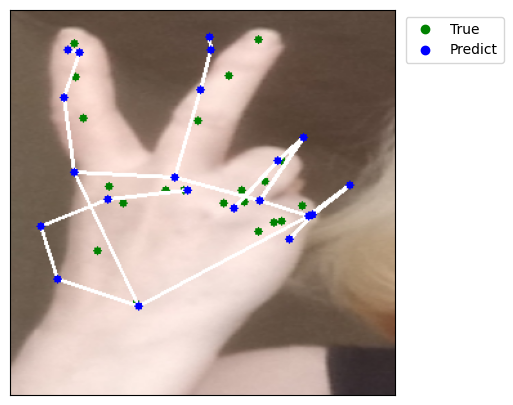

100%|██████████| 779/779 [05:58<00:00,  2.17it/s]


Epochs: 12 | Train MSE:  0.008353         | Test MSE:  0.011008


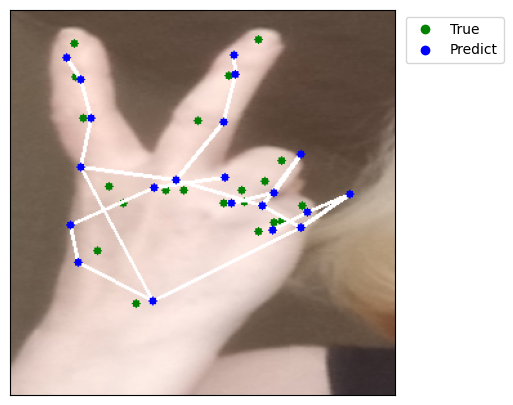

100%|██████████| 779/779 [05:57<00:00,  2.18it/s]


Epochs: 13 | Train MSE:  0.008130         | Test MSE:  0.010335


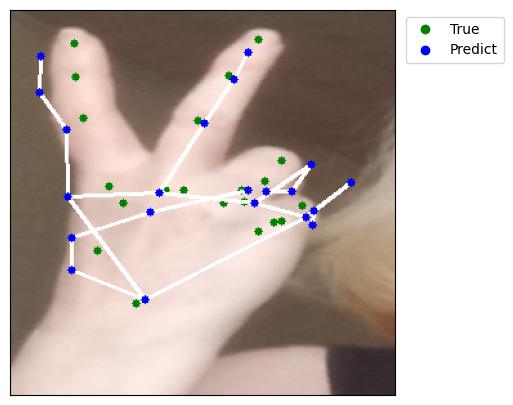

100%|██████████| 779/779 [05:59<00:00,  2.17it/s]


Epochs: 14 | Train MSE:  0.007765         | Test MSE:  0.009534


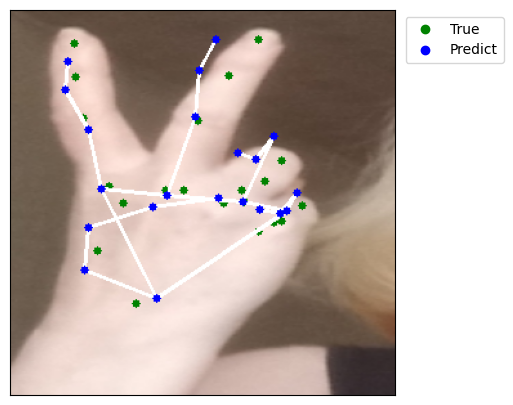

100%|██████████| 779/779 [06:00<00:00,  2.16it/s]


Epochs: 15 | Train MSE:  0.007614         | Test MSE:  0.009471


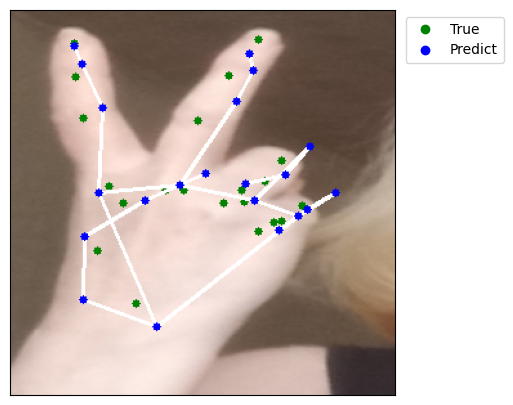

100%|██████████| 779/779 [05:53<00:00,  2.20it/s]


Epochs: 16 | Train MSE:  0.007622         | Test MSE:  0.008072


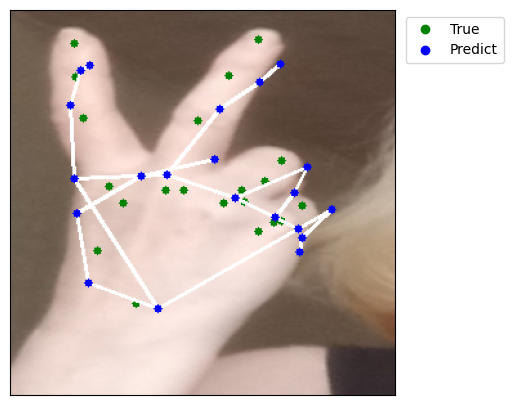

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 17 | Train MSE:  0.007118         | Test MSE:  0.008178


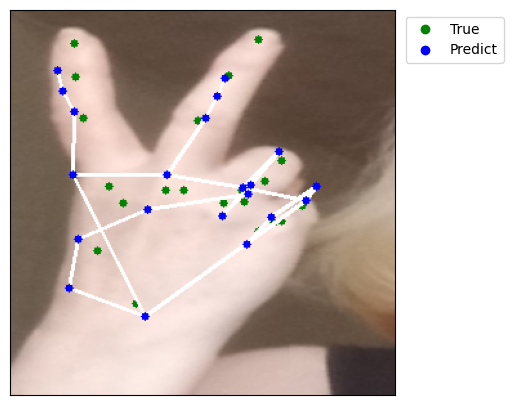

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 18 | Train MSE:  0.007284         | Test MSE:  0.008820


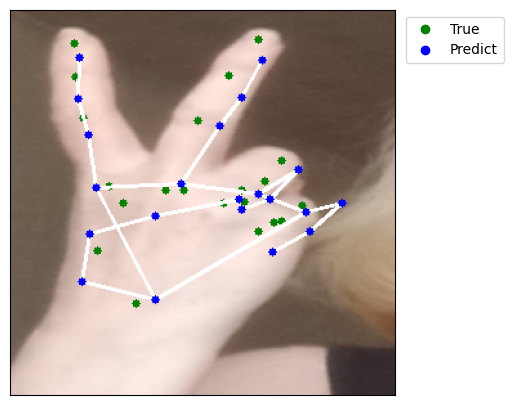

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 19 | Train MSE:  0.006918         | Test MSE:  0.007913


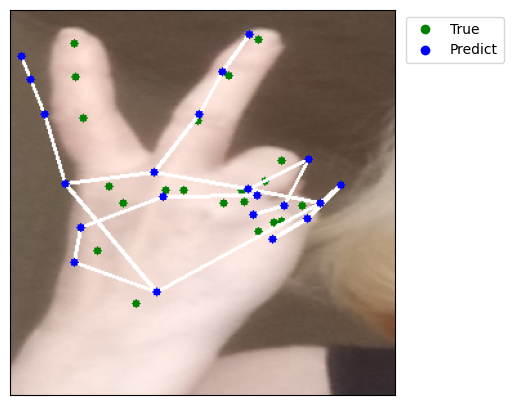

100%|██████████| 779/779 [05:53<00:00,  2.20it/s]


Epochs: 20 | Train MSE:  0.006662         | Test MSE:  0.007969


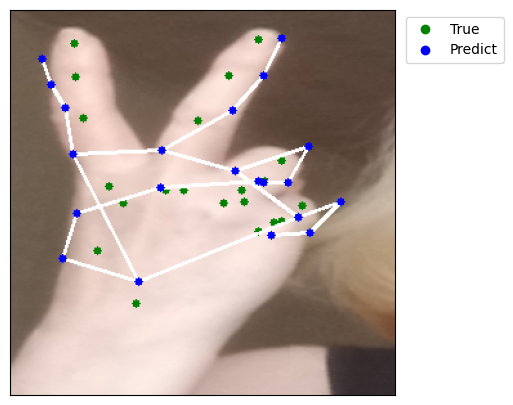

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 21 | Train MSE:  0.006582         | Test MSE:  0.008399


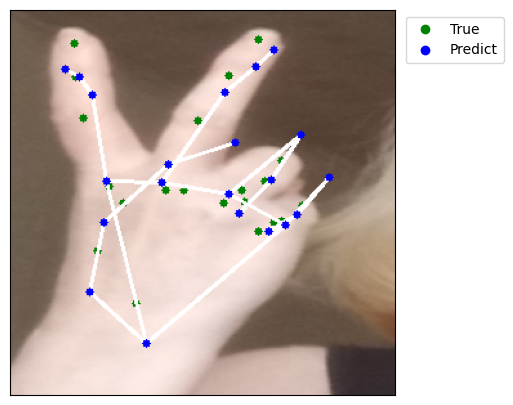

100%|██████████| 779/779 [05:52<00:00,  2.21it/s]


Epochs: 22 | Train MSE:  0.006466         | Test MSE:  0.007664


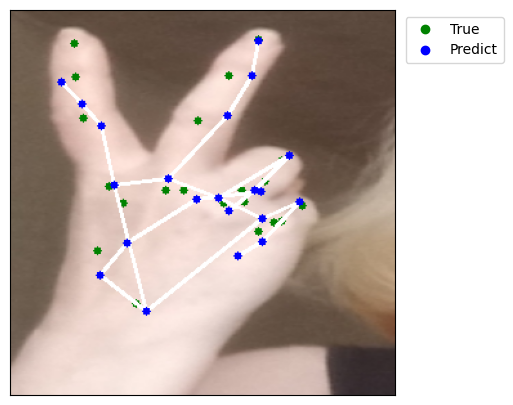

100%|██████████| 779/779 [05:51<00:00,  2.22it/s]


Epochs: 23 | Train MSE:  0.006417         | Test MSE:  0.007673


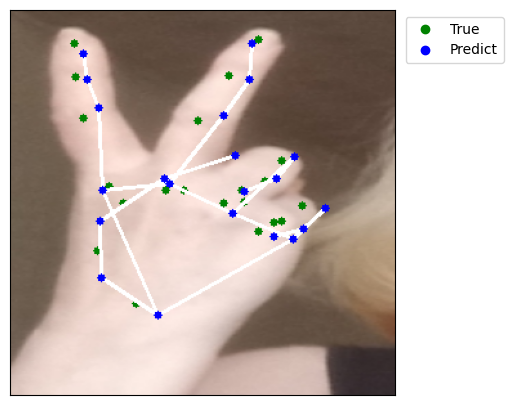

100%|██████████| 779/779 [05:51<00:00,  2.21it/s]


Epochs: 24 | Train MSE:  0.006451         | Test MSE:  0.007508


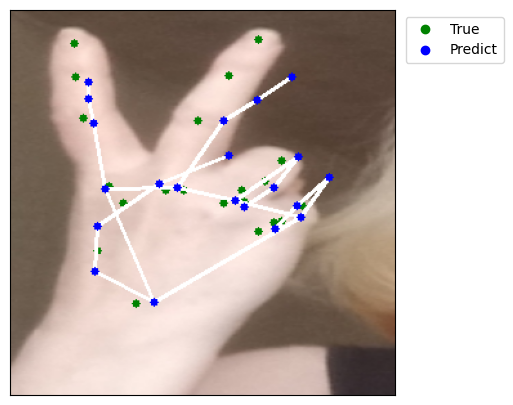

100%|██████████| 779/779 [05:53<00:00,  2.20it/s]


Epochs: 25 | Train MSE:  0.006239         | Test MSE:  0.007002


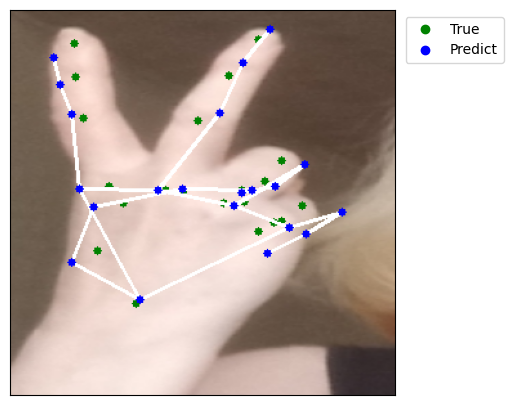

CPU times: user 1h 31min 49s, sys: 2min 34s, total: 1h 34min 23s
Wall time: 2h 39min 2s


In [ ]:
%%time

epochs = 25

train_list_loss = []
test_list_loss = []

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    
    model.train() 
    for img, landmarks in tqdm(train_loader):
        img = img.to(device)
        landmarks = landmarks.to(device)

        pred_landmarks = model(img)
             
        loss = criterion(pred_landmarks, landmarks)
        train_loss += loss.item()
        
        model.zero_grad()
        loss.backward()
        optimizer.step()
        
    model.eval()
    for img, landmarks in test_loader:
        img = img.to(device)
        landmarks = landmarks.to(device)

        pred_landmarks = model(img)
        
        loss = criterion(pred_landmarks, landmarks)
        test_loss += loss.item()
    
    print(
        f'Epochs: {epoch_num + 1} | Train MSE: {train_loss / len(train_loader): .6f} \
        | Test MSE: {test_loss / len(test_loader): .6f}')
    
    train_list_loss.append(round(train_loss / len(train_loader), 6))
    test_list_loss.append(round(test_loss / len(test_loader), 6))

    # Пример
    example_img_tensor = torch.permute(torch.Tensor(example_img / 255), (2, 0, 1))[None, ..., ..., ...].to(device)
    landmarks = model(example_img_tensor)
    plt.figure(figsize=(5, 5))
    img = draw_landmarks(example_img, example_landmarks, point_color=(0.,130.,0.), draw_skeleton=False)
    img = draw_landmarks(img, landmarks[0], point_color=(0.,0.,255.), draw_skeleton=True)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.xlim([0, SIZE[0] - 1])
    plt.ylim([SIZE[0] - 1, 0])
    plt.plot(-10, -10, 'o', color=(0,130/255,0), label='True')
    plt.plot(-10, -10, 'o', color=(0,0,1), label='Predict')
    plt.legend(bbox_to_anchor=(1.3, 1.))
    plt.show()

    # Динамически меняем lr в зависимости от ошибки
    opt_loss = round(train_loss / len(train_loader), 6)
    if opt_loss < 0.002:
        optimizer.param_groups[0]['lr'] = 10**(-5)
    else:
        optimizer.param_groups[0]['lr'] = 10**(-4)

### Визуализация обучения

Так как я тренировал модель 3-мя подходами из-за долгого времени обучения, то решил оставить данные только первого подхода, так как они наиболее информативные

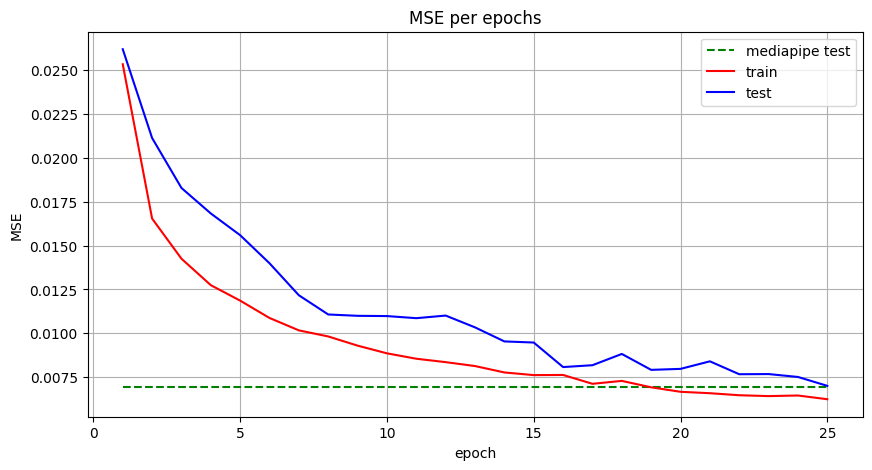

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), [mediapipe_test_mse] * epochs, 'g--', label='mediapipe test')
plt.plot(list(range(1, epochs+1)), train_list_loss, 'r', label='train')
plt.plot(list(range(1, epochs+1)), test_list_loss, 'b', label='test')
plt.title('MSE per epochs')
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.legend()
plt.grid()
plt.show()

### Сохраним модель:

In [ ]:
torch.save(model, '/content/gdrive/MyDrive/Colab Notebooks/landmarks_detector.pth')

### ------ checkpoint ------

### Загрузим модель:

In [ ]:
landmarks_detector = torch.load('landmarks_detector.pth', map_location=torch.device('cuda')) 
landmarks_detector.eval()

Net_landmarks_detector(
  (base_model): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512

Теперь дообучим модель на концретно нашу задачу, распознование жестов

In [ ]:
data_dataset_landmarks_good = []
for gesture in data_train_hagrid.keys():
  for k in data_train_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        data_dataset_landmarks_good.append([k['image'], k['landmarks'][i]])

In [ ]:
train_dataset = Dataset_landmarks(data_dataset_landmarks_good, SIZE, train_tfms, noise_v=(-0.01, 0.01), up_v=0.1)

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=10**(-5))
criterion = nn.MSELoss()

100%|██████████| 125/125 [02:08<00:00,  1.03s/it]


Epochs: 1 | Train MSE:  0.001838         | Test MSE:  0.005701


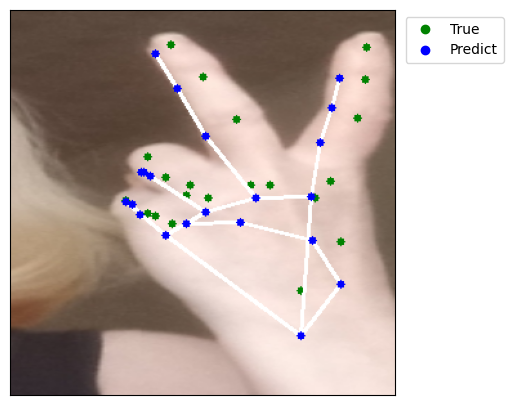

100%|██████████| 125/125 [02:09<00:00,  1.03s/it]


Epochs: 2 | Train MSE:  0.001657         | Test MSE:  0.005747


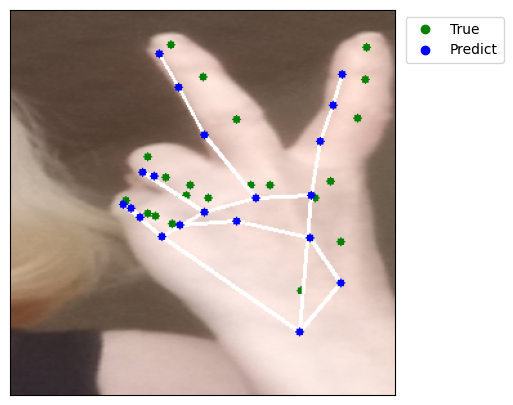

100%|██████████| 125/125 [02:09<00:00,  1.03s/it]


Epochs: 3 | Train MSE:  0.001576         | Test MSE:  0.005211


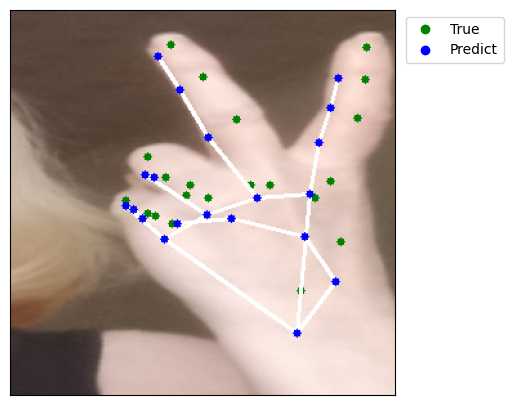

100%|██████████| 125/125 [02:10<00:00,  1.05s/it]


Epochs: 4 | Train MSE:  0.001457         | Test MSE:  0.005527


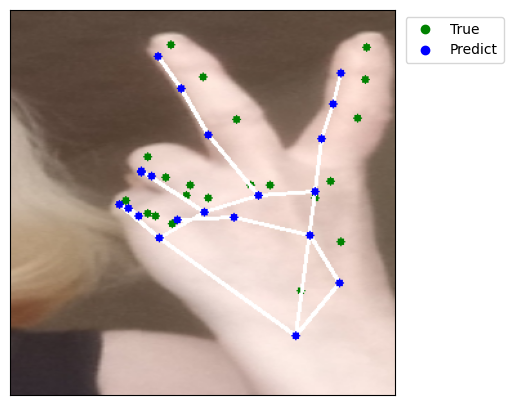

100%|██████████| 125/125 [02:09<00:00,  1.03s/it]


Epochs: 5 | Train MSE:  0.001419         | Test MSE:  0.005704


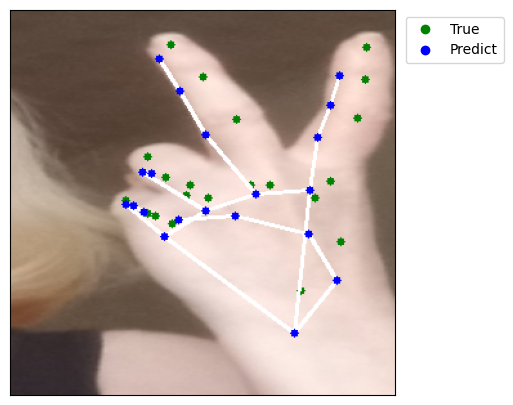

100%|██████████| 125/125 [02:09<00:00,  1.04s/it]


Epochs: 6 | Train MSE:  0.001464         | Test MSE:  0.005052


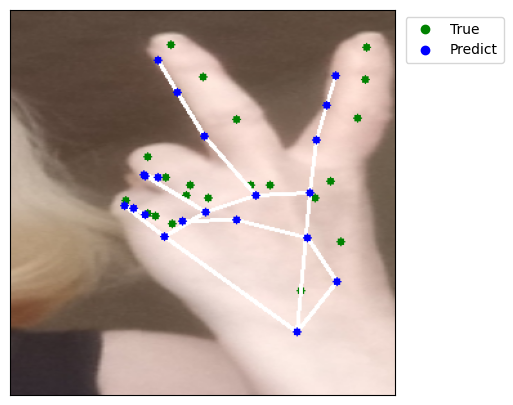

100%|██████████| 125/125 [02:07<00:00,  1.02s/it]


Epochs: 7 | Train MSE:  0.001346         | Test MSE:  0.005200


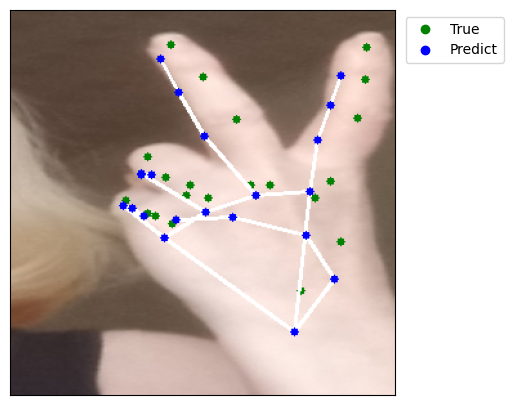

100%|██████████| 125/125 [02:10<00:00,  1.04s/it]


Epochs: 8 | Train MSE:  0.001248         | Test MSE:  0.005231


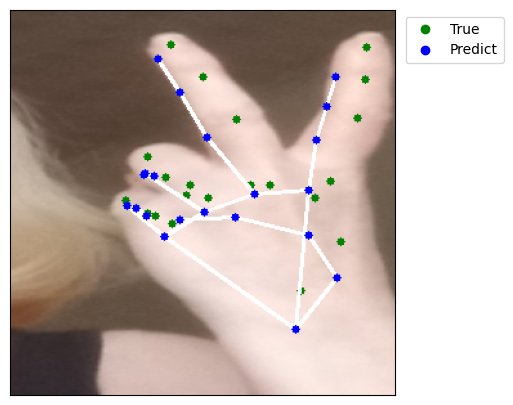

100%|██████████| 125/125 [02:09<00:00,  1.04s/it]


Epochs: 9 | Train MSE:  0.001270         | Test MSE:  0.005287


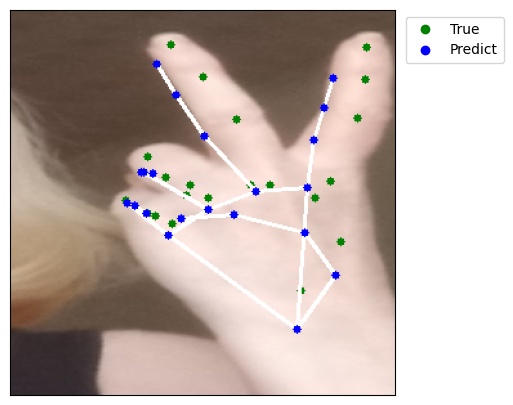

100%|██████████| 125/125 [02:10<00:00,  1.04s/it]


Epochs: 10 | Train MSE:  0.001272         | Test MSE:  0.005723


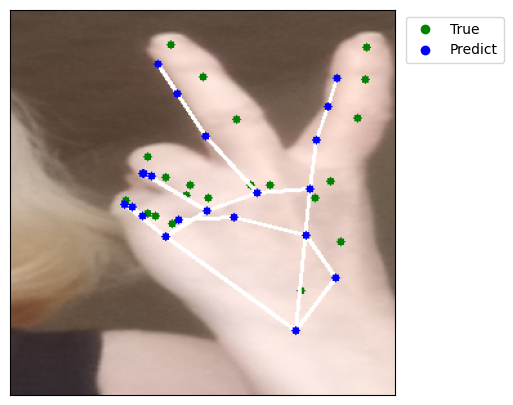

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 11 | Train MSE:  0.001227         | Test MSE:  0.005780


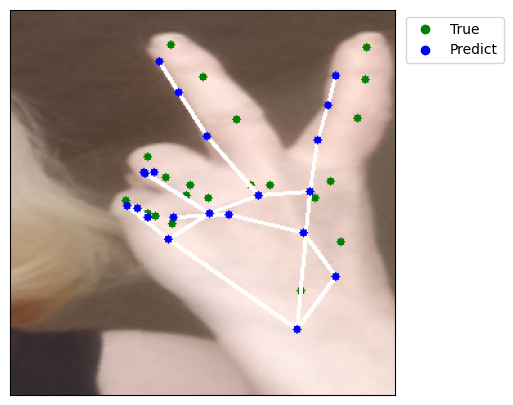

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 12 | Train MSE:  0.001171         | Test MSE:  0.005150


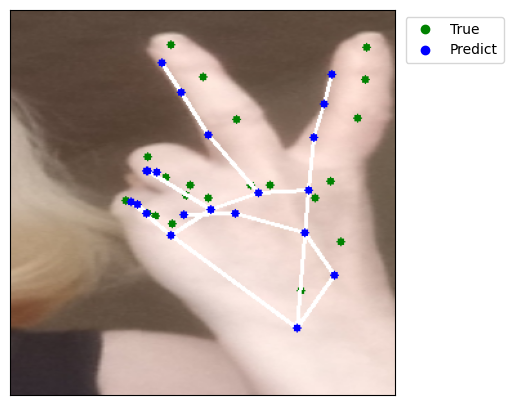

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 13 | Train MSE:  0.001189         | Test MSE:  0.005071


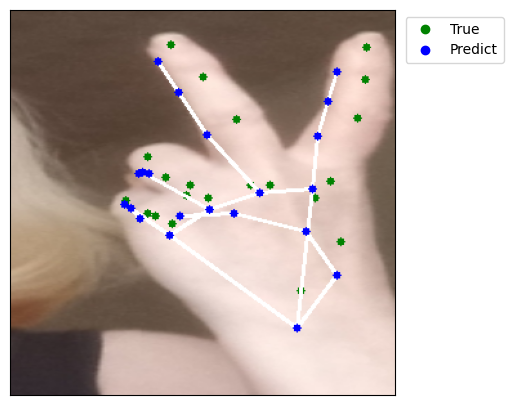

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 14 | Train MSE:  0.001109         | Test MSE:  0.005146


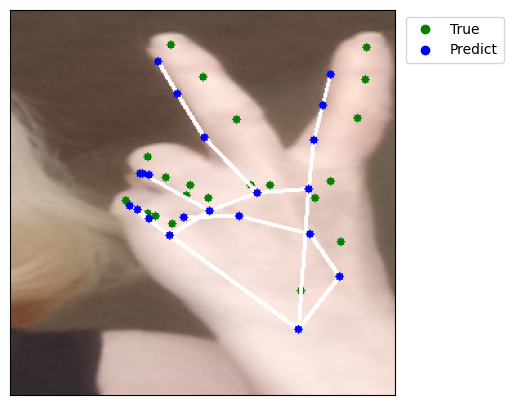

100%|██████████| 125/125 [02:10<00:00,  1.05s/it]


Epochs: 15 | Train MSE:  0.001120         | Test MSE:  0.005365


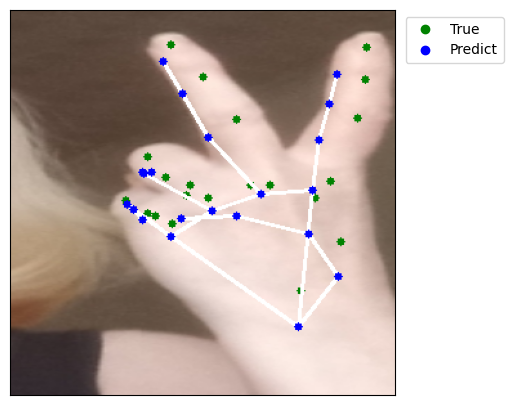

100%|██████████| 125/125 [02:11<00:00,  1.06s/it]


Epochs: 16 | Train MSE:  0.001123         | Test MSE:  0.005540


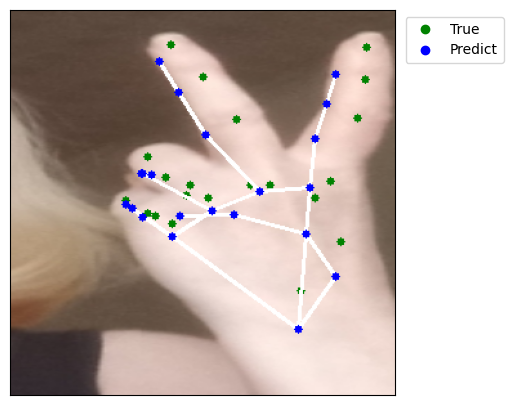

100%|██████████| 125/125 [02:10<00:00,  1.04s/it]


Epochs: 17 | Train MSE:  0.001037         | Test MSE:  0.005083


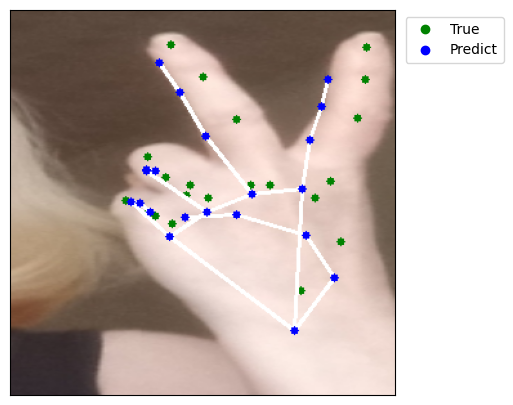

100%|██████████| 125/125 [02:10<00:00,  1.04s/it]


Epochs: 18 | Train MSE:  0.001027         | Test MSE:  0.005895


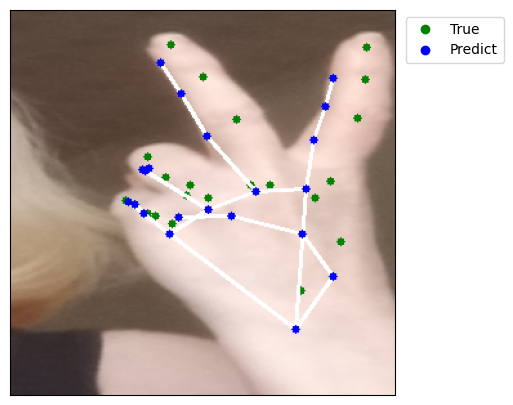

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 19 | Train MSE:  0.001004         | Test MSE:  0.005198


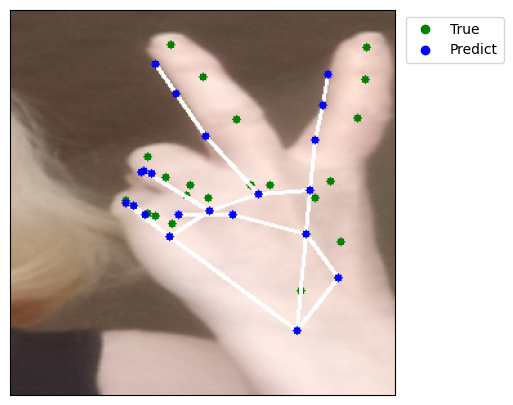

100%|██████████| 125/125 [02:09<00:00,  1.04s/it]


Epochs: 20 | Train MSE:  0.001026         | Test MSE:  0.005353


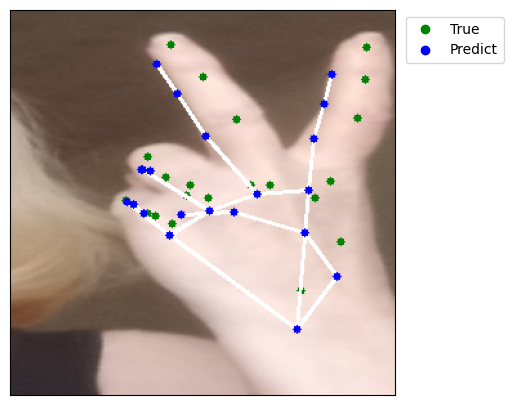

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 21 | Train MSE:  0.001010         | Test MSE:  0.005358


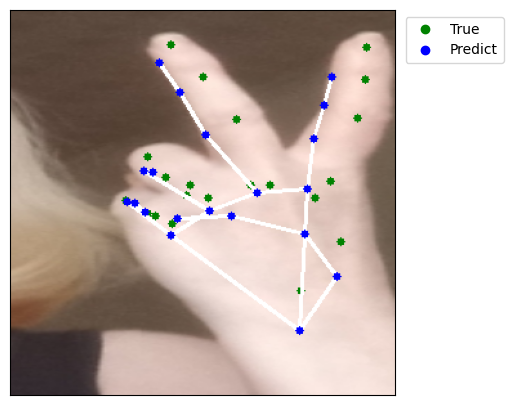

100%|██████████| 125/125 [02:10<00:00,  1.04s/it]


Epochs: 22 | Train MSE:  0.000992         | Test MSE:  0.004652


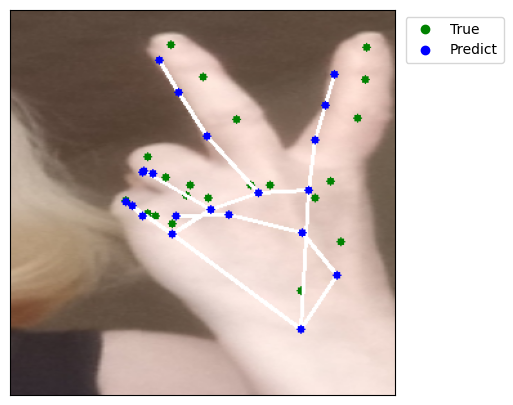

100%|██████████| 125/125 [02:10<00:00,  1.05s/it]


Epochs: 23 | Train MSE:  0.000982         | Test MSE:  0.005214


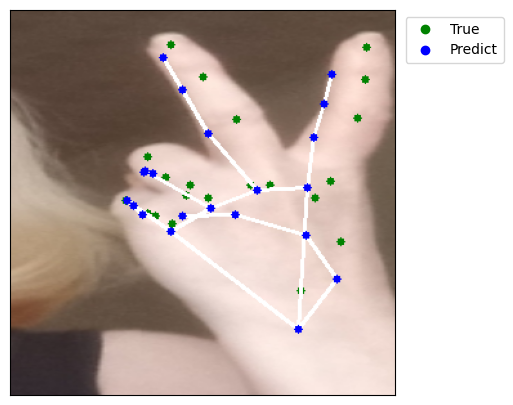

100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


Epochs: 24 | Train MSE:  0.000978         | Test MSE:  0.005250


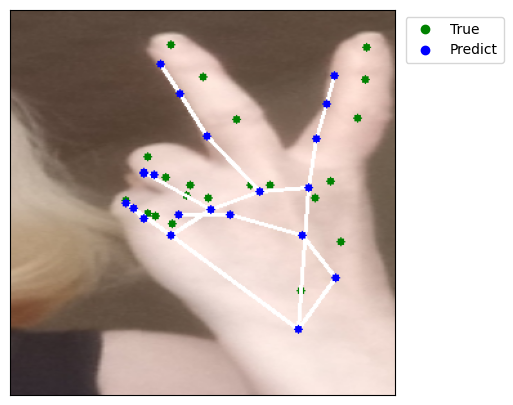

100%|██████████| 125/125 [02:10<00:00,  1.05s/it]


Epochs: 25 | Train MSE:  0.000935         | Test MSE:  0.005382


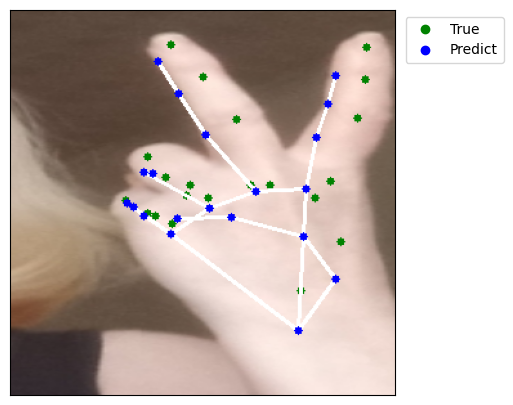

CPU times: user 1h 7min 23s, sys: 58.7 s, total: 1h 8min 22s
Wall time: 1h 7min 46s


In [ ]:
%%time

epochs = 25

train_list_loss = []
test_list_loss = []

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    
    model.train() 
    for img, landmarks in tqdm(train_loader):
        img = img.to(device)
        landmarks = landmarks.to(device)

        pred_landmarks = model(img)
             
        loss = criterion(pred_landmarks, landmarks)
        train_loss += loss.item()
        
        model.zero_grad()
        loss.backward()
        optimizer.step()
        
    model.eval()
    for img, landmarks in test_loader:
        img = img.to(device)
        landmarks = landmarks.to(device)

        pred_landmarks = model(img)
        
        loss = criterion(pred_landmarks, landmarks)
        test_loss += loss.item()
    
    print(
        f'Epochs: {epoch_num + 1} | Train MSE: {train_loss / len(train_loader): .6f} \
        | Test MSE: {test_loss / len(test_loader): .6f}')
    
    train_list_loss.append(round(train_loss / len(train_loader), 6))
    test_list_loss.append(round(test_loss / len(test_loader), 6))

    # Пример
    example_img_tensor = torch.permute(torch.Tensor(example_img / 255), (2, 0, 1))[None, ..., ..., ...].to(device)
    landmarks = model(example_img_tensor)
    plt.figure(figsize=(5, 5))
    img = draw_landmarks(example_img, example_landmarks, point_color=(0.,130.,0.), draw_skeleton=False)
    img = draw_landmarks(img, landmarks[0], point_color=(0.,0.,255.), draw_skeleton=True)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.xlim([0, SIZE[0] - 1])
    plt.ylim([SIZE[0] - 1, 0])
    plt.plot(-10, -10, 'o', color=(0,130/255,0), label='True')
    plt.plot(-10, -10, 'o', color=(0,0,1), label='Predict')
    plt.legend(bbox_to_anchor=(1.3, 1.))
    plt.show()

### Визуализация обучения

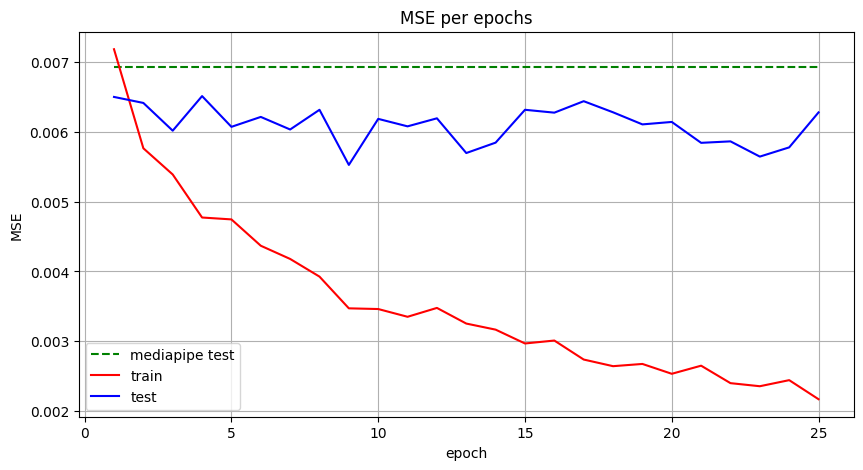

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), [mediapipe_test_mse] * epochs, 'g--', label='mediapipe test')
plt.plot(list(range(1, epochs+1)), train_list_loss, 'r', label='train')
plt.plot(list(range(1, epochs+1)), test_list_loss, 'b', label='test')
plt.title('MSE per epochs')
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.legend()
plt.grid()
plt.show()

### Сохраним модель:

In [ ]:
torch.save(model, '/content/gdrive/MyDrive/Colab Notebooks/landmarks_detector_good.pth')

### ------ checkpoint ------

### Загрузим модель:

In [ ]:
landmarks_detector_good = torch.load('landmarks_detector_good.pth', map_location=torch.device('cuda')) 
landmarks_detector_good.eval()

Net_landmarks_detector(
  (base_model): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512

## Классификация по ключевым точкам

### Данные

Возьмём простые для детектирования жесты рук из датасета hagrid такие как: four, palm, peace, rock, three, three2. А также добавим категорию no_gest которая будет означать, что нужно жеста на изображении нету.

In [ ]:
good_gestures = ['no_gest', 'four', 'palm', 'peace', 'rock', 'three', 'three2']
gestures2num = dict(zip(good_gestures, range(len(good_gestures))))
num2gestures = {j:i for i, j in gestures2num.items()}

In [ ]:
data_train_class = []
for gesture in data_train_hagrid.keys():
  for k in data_train_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        data_train_class.append([k['landmarks'][i], 
                                 gestures2num[(k['labels'][i] if k['labels'][i] in good_gestures else 'no_gest')]])

In [ ]:
data_test_class = []
for gesture in data_test_hagrid.keys():
  for k in data_test_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        data_test_class.append([k['landmarks'][i], 
                                 gestures2num[(k['labels'][i] if k['labels'][i] in good_gestures else 'no_gest')]])

In [ ]:
disbalance = [0]*len(good_gestures)
for k in data_train_class:
    disbalance[k[1]] += 1
disbalance = max(disbalance) / np.array(disbalance)
disbalance

array([ 1.        , 18.9375    , 19.17721519, 20.47297297, 19.17721519,
       18.9375    , 18.9375    ])

### Dataset

In [ ]:
class Dataset_landmarks_classification(Dataset):
    def __init__(self, data, noise_v=(-0.01, 0.01)):
        
        data = copy.deepcopy(data)
        self.data = data
        self.noise_v = noise_v

    def __getitem__(self, index):
        # cчитываем данные
        landmarks = torch.tensor(self.data[index][0])
        label = torch.tensor(self.data[index][1])
        # random noise
        noise = np.random.randint(int(self.noise_v[0]*10000), int(self.noise_v[1]*10000), size=(21, 2))/10000
        
        # приводим метки от 0 до 1
        x_min = landmarks[:,0].min()
        y_min = landmarks[:,1].min()
        w = landmarks[:,0].max() - x_min
        h = landmarks[:,1].max() - y_min
        landmarks[:,0] = (landmarks[:,0] - x_min)/w
        landmarks[:,1] = (landmarks[:,1] - y_min)/h
        landmarks = np.clip(landmarks + noise, 0, 1)
        
        """# horizontal flip
        rand_horizontal = np.random.randint(2)
        if rand_horizontal:
          landmarks[:,0] = landmarks[:,0] * (-1)
        # vertical flip
        rand_vertical = np.random.randint(2)
        if rand_vertical:
          landmarks[:,1] = landmarks[:,1] * (-1)
        # rotation and flip
        rand_rotation = np.random.randint(2)
        if rand_rotation:
          landmarks_cl = landmarks.clone()
          landmarks[:,0] = landmarks_cl[:,1]
          landmarks[:,1] = landmarks_cl[:,0]"""
        
        return landmarks.to(torch.float32), label

    def __len__(self):
        return len(self.data)

In [ ]:
train_dataset = Dataset_landmarks_classification(data_train_class)
test_dataset = Dataset_landmarks_classification(data_test_class)

### DataLoader

In [ ]:
BATCH_SIZE = 16

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, BATCH_SIZE, shuffle=False)

### Обучение

In [ ]:
model = Net_landmarks_classification(in_channel=2, length=21, hidden_dim=512, num_classes=len(good_gestures), dropout=0.2)
model = model.to(device)

In [ ]:
print("Количество параметров: ", sum([param.numel() for param in model.parameters()]))

Количество параметров:  156679


In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss(weight=torch.FloatTensor(disbalance).to(device))

Так как классы несбалансированны, то accuracy не является хорошей метрикой, поэтому будем использовать f1_score

In [ ]:
%%time

epochs = 100

train_list_loss = []
test_list_loss = []
train_list_acc = []
test_list_acc = []
train_list_f1 = []
test_list_f1 = []

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    train_acc = 0
    test_acc = 0
    train_f1 = 0
    test_f1 = 0
    
    model.train()
    for landmarks, labels in tqdm(train_loader):
        landmarks = landmarks.to(device)
        labels = labels.to(device)

        output = model(landmarks)
        
        loss = criterion(output, labels)
        train_loss += loss.item()
                
        train_acc += (output.argmax(dim=1) == labels).sum().item() / len(labels)
        
        train_f1 += f1_score(labels.detach().cpu().numpy().astype(int), 
                             (output.detach().cpu().numpy().argmax(1)).astype(int), average='weighted')

        model.zero_grad()
        loss.backward()
        optimizer.step()
            
    model.eval()
    for landmarks, labels in test_loader:
        landmarks = landmarks.to(device)
        labels = labels.to(device)

        output = model(landmarks)

        loss = criterion(output, labels)
        test_loss += loss.item()
                    
        test_acc += (output.argmax(dim=1) == labels).sum().item() / len(labels)

        test_f1 += f1_score(labels.detach().cpu().numpy().astype(int), 
                            (output.detach().cpu().numpy().argmax(1)).astype(int), average='weighted')
        
    train_list_loss.append(round(train_loss / len(train_loader), 6))
    test_list_loss.append(round(test_loss / len(test_loader), 6))
    train_list_acc.append(round(train_acc / len(train_loader), 6))
    test_list_acc.append(round(test_acc / len(test_loader), 6))
    train_list_f1.append(round(train_f1 / len(train_loader), 6))
    test_list_f1.append(round(test_f1 / len(test_loader), 6))
            
    print(
        f"Epochs: {epoch_num + 1} | Train Loss: {train_loss / len(train_loader): .6f} \
        | Train Accuracy: {train_acc / len(train_loader): .6f} \
        | Train_f1: {train_f1 / len(train_loader): .6f}" + "\n" + " "*len(str(epoch_num + 1)) +
f"         | Test Loss: {test_loss / len(test_loader): .6f} \
         | Test Accuracy: {test_acc / len(test_loader): .6f} \
         | Test_f1: {test_f1 / len(test_loader): .6f}")
    
    # Динамически меняем lr в зависимости от ошибки
    opt_loss = round(train_loss / len(train_loader), 6)
    if opt_loss < 0.2:
        optimizer.param_groups[0]['lr'] = 10**(-4)
    else:
        optimizer.param_groups[0]['lr'] = 10**(-3)

100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 152.63it/s]


Epochs: 1 | Train Loss:  0.757304         | Train Accuracy:  0.677667         | Train_f1:  0.747986
          | Test Loss:  0.457818          | Test Accuracy:  0.783199          | Test_f1:  0.841842


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 159.85it/s]


Epochs: 2 | Train Loss:  0.314765         | Train Accuracy:  0.826833         | Train_f1:  0.877696
          | Test Loss:  0.298591          | Test Accuracy:  0.838441          | Test_f1:  0.885063


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 170.77it/s]


Epochs: 3 | Train Loss:  0.209724         | Train Accuracy:  0.883500         | Train_f1:  0.921749
          | Test Loss:  0.210680          | Test Accuracy:  0.913306          | Test_f1:  0.941239


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 149.16it/s]


Epochs: 4 | Train Loss:  0.209936         | Train Accuracy:  0.871500         | Train_f1:  0.912226
          | Test Loss:  0.346000          | Test Accuracy:  0.820430          | Test_f1:  0.870162


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 169.15it/s]


Epochs: 5 | Train Loss:  0.232295         | Train Accuracy:  0.882167         | Train_f1:  0.915638
          | Test Loss:  0.274299          | Test Accuracy:  0.862634          | Test_f1:  0.904353


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 176.31it/s]


Epochs: 6 | Train Loss:  0.183781         | Train Accuracy:  0.893500         | Train_f1:  0.927907
          | Test Loss:  0.179912          | Test Accuracy:  0.919355          | Test_f1:  0.942390


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.16it/s]


Epochs: 7 | Train Loss:  0.139810         | Train Accuracy:  0.929000         | Train_f1:  0.952311
          | Test Loss:  0.152304          | Test Accuracy:  0.935484          | Test_f1:  0.956014


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.91it/s]


Epochs: 8 | Train Loss:  0.121477         | Train Accuracy:  0.934000         | Train_f1:  0.956473
          | Test Loss:  0.158340          | Test Accuracy:  0.923253          | Test_f1:  0.949073


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 155.39it/s]


Epochs: 9 | Train Loss:  0.119019         | Train Accuracy:  0.928500         | Train_f1:  0.951472
          | Test Loss:  0.157148          | Test Accuracy:  0.927419          | Test_f1:  0.949117


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 169.15it/s]


Epochs: 10 | Train Loss:  0.113392         | Train Accuracy:  0.941500         | Train_f1:  0.960179
           | Test Loss:  0.162553          | Test Accuracy:  0.919220          | Test_f1:  0.945371


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 166.89it/s]


Epochs: 11 | Train Loss:  0.155327         | Train Accuracy:  0.945333         | Train_f1:  0.962521
           | Test Loss:  0.147992          | Test Accuracy:  0.933468          | Test_f1:  0.953691


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 148.28it/s]


Epochs: 12 | Train Loss:  0.109812         | Train Accuracy:  0.943000         | Train_f1:  0.962359
           | Test Loss:  0.145881          | Test Accuracy:  0.929435          | Test_f1:  0.952139


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 170.07it/s]


Epochs: 13 | Train Loss:  0.111711         | Train Accuracy:  0.937000         | Train_f1:  0.956811
           | Test Loss:  0.131332          | Test Accuracy:  0.935484          | Test_f1:  0.957139


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 179.34it/s]


Epochs: 14 | Train Loss:  0.111192         | Train Accuracy:  0.943000         | Train_f1:  0.961170
           | Test Loss:  0.144700          | Test Accuracy:  0.929435          | Test_f1:  0.951652


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 171.94it/s]


Epochs: 15 | Train Loss:  0.127912         | Train Accuracy:  0.937167         | Train_f1:  0.954590
           | Test Loss:  0.138334          | Test Accuracy:  0.935484          | Test_f1:  0.957789


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 168.24it/s]


Epochs: 16 | Train Loss:  0.115201         | Train Accuracy:  0.941000         | Train_f1:  0.960650
           | Test Loss:  0.119891          | Test Accuracy:  0.945565          | Test_f1:  0.964376


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 184.09it/s]


Epochs: 17 | Train Loss:  0.105399         | Train Accuracy:  0.938000         | Train_f1:  0.957964
           | Test Loss:  0.138878          | Test Accuracy:  0.935484          | Test_f1:  0.957208


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 154.51it/s]


Epochs: 18 | Train Loss:  0.115083         | Train Accuracy:  0.946000         | Train_f1:  0.964792
           | Test Loss:  0.118919          | Test Accuracy:  0.941532          | Test_f1:  0.959547


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 171.70it/s]


Epochs: 19 | Train Loss:  0.093679         | Train Accuracy:  0.944500         | Train_f1:  0.961395
           | Test Loss:  0.121276          | Test Accuracy:  0.943548          | Test_f1:  0.961840


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 171.23it/s]


Epochs: 20 | Train Loss:  0.093329         | Train Accuracy:  0.952000         | Train_f1:  0.967242
           | Test Loss:  0.146026          | Test Accuracy:  0.929435          | Test_f1:  0.952893


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 157.43it/s]


Epochs: 21 | Train Loss:  0.089952         | Train Accuracy:  0.951500         | Train_f1:  0.966828
           | Test Loss:  0.127219          | Test Accuracy:  0.939516          | Test_f1:  0.959631


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 170.07it/s]


Epochs: 22 | Train Loss:  0.152799         | Train Accuracy:  0.945833         | Train_f1:  0.961218
           | Test Loss:  0.105188          | Test Accuracy:  0.951613          | Test_f1:  0.968543


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 173.85it/s]


Epochs: 23 | Train Loss:  0.087503         | Train Accuracy:  0.953500         | Train_f1:  0.966860
           | Test Loss:  0.137517          | Test Accuracy:  0.931452          | Test_f1:  0.954260


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 169.38it/s]


Epochs: 24 | Train Loss:  0.091742         | Train Accuracy:  0.954000         | Train_f1:  0.969533
           | Test Loss:  0.128901          | Test Accuracy:  0.935484          | Test_f1:  0.956356


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 178.06it/s]


Epochs: 25 | Train Loss:  0.082644         | Train Accuracy:  0.947500         | Train_f1:  0.965362
           | Test Loss:  0.141611          | Test Accuracy:  0.929435          | Test_f1:  0.951133


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 180.12it/s]


Epochs: 26 | Train Loss:  0.092890         | Train Accuracy:  0.942833         | Train_f1:  0.960377
           | Test Loss:  0.126272          | Test Accuracy:  0.935484          | Test_f1:  0.956524


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 171.47it/s]


Epochs: 27 | Train Loss:  0.084937         | Train Accuracy:  0.944000         | Train_f1:  0.961384
           | Test Loss:  0.094944          | Test Accuracy:  0.955645          | Test_f1:  0.969692


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 176.30it/s]


Epochs: 28 | Train Loss:  0.088520         | Train Accuracy:  0.959000         | Train_f1:  0.972702
           | Test Loss:  0.110236          | Test Accuracy:  0.941532          | Test_f1:  0.959972


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 177.94it/s]


Epochs: 29 | Train Loss:  0.081155         | Train Accuracy:  0.954833         | Train_f1:  0.968919
           | Test Loss:  0.111852          | Test Accuracy:  0.939516          | Test_f1:  0.961460


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 175.81it/s]


Epochs: 30 | Train Loss:  0.093488         | Train Accuracy:  0.941667         | Train_f1:  0.957773
           | Test Loss:  0.119339          | Test Accuracy:  0.951613          | Test_f1:  0.968699


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 166.44it/s]


Epochs: 31 | Train Loss:  0.090021         | Train Accuracy:  0.946500         | Train_f1:  0.963845
           | Test Loss:  0.115592          | Test Accuracy:  0.941532          | Test_f1:  0.962570


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 173.85it/s]


Epochs: 32 | Train Loss:  0.088268         | Train Accuracy:  0.953000         | Train_f1:  0.967306
           | Test Loss:  0.113942          | Test Accuracy:  0.939516          | Test_f1:  0.961460


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.47it/s]


Epochs: 33 | Train Loss:  0.079302         | Train Accuracy:  0.958000         | Train_f1:  0.971780
           | Test Loss:  0.111394          | Test Accuracy:  0.941532          | Test_f1:  0.961364


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 153.94it/s]


Epochs: 34 | Train Loss:  0.077966         | Train Accuracy:  0.965000         | Train_f1:  0.974948
           | Test Loss:  0.117096          | Test Accuracy:  0.945565          | Test_f1:  0.964867


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 189.68it/s]


Epochs: 35 | Train Loss:  0.081472         | Train Accuracy:  0.954500         | Train_f1:  0.968915
           | Test Loss:  0.113570          | Test Accuracy:  0.945565          | Test_f1:  0.963108


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 180.38it/s]


Epochs: 36 | Train Loss:  0.073950         | Train Accuracy:  0.965500         | Train_f1:  0.976378
           | Test Loss:  0.141712          | Test Accuracy:  0.933468          | Test_f1:  0.956563


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 184.64it/s]


Epochs: 37 | Train Loss:  0.094281         | Train Accuracy:  0.950000         | Train_f1:  0.964783
           | Test Loss:  0.129218          | Test Accuracy:  0.943548          | Test_f1:  0.963067


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 171.00it/s]


Epochs: 38 | Train Loss:  0.078410         | Train Accuracy:  0.957833         | Train_f1:  0.970571
           | Test Loss:  0.101741          | Test Accuracy:  0.953629          | Test_f1:  0.970293


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 178.83it/s]


Epochs: 39 | Train Loss:  0.075033         | Train Accuracy:  0.955333         | Train_f1:  0.969623
           | Test Loss:  0.095603          | Test Accuracy:  0.949597          | Test_f1:  0.968745


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 161.08it/s]


Epochs: 40 | Train Loss:  0.088024         | Train Accuracy:  0.961833         | Train_f1:  0.973514
           | Test Loss:  0.110895          | Test Accuracy:  0.945565          | Test_f1:  0.964867


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 179.08it/s]


Epochs: 41 | Train Loss:  0.090956         | Train Accuracy:  0.954333         | Train_f1:  0.965800
           | Test Loss:  0.099722          | Test Accuracy:  0.951613          | Test_f1:  0.968768


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 189.68it/s]


Epochs: 42 | Train Loss:  0.077837         | Train Accuracy:  0.961000         | Train_f1:  0.973733
           | Test Loss:  0.111456          | Test Accuracy:  0.939516          | Test_f1:  0.960700


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 189.11it/s]


Epochs: 43 | Train Loss:  0.064592         | Train Accuracy:  0.966000         | Train_f1:  0.977418
           | Test Loss:  0.098541          | Test Accuracy:  0.947581          | Test_f1:  0.967473


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 191.42it/s]


Epochs: 44 | Train Loss:  0.065368         | Train Accuracy:  0.959500         | Train_f1:  0.971349
           | Test Loss:  0.109211          | Test Accuracy:  0.949597          | Test_f1:  0.967727


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 183.82it/s]


Epochs: 45 | Train Loss:  0.075965         | Train Accuracy:  0.961500         | Train_f1:  0.973444
           | Test Loss:  0.100126          | Test Accuracy:  0.949597          | Test_f1:  0.967271


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 183.28it/s]


Epochs: 46 | Train Loss:  0.073843         | Train Accuracy:  0.968000         | Train_f1:  0.978933
           | Test Loss:  0.107462          | Test Accuracy:  0.949597          | Test_f1:  0.967442


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 162.97it/s]


Epochs: 47 | Train Loss:  0.099056         | Train Accuracy:  0.951167         | Train_f1:  0.962614
           | Test Loss:  0.080033          | Test Accuracy:  0.967742          | Test_f1:  0.978595


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 162.34it/s]


Epochs: 48 | Train Loss:  0.083182         | Train Accuracy:  0.966500         | Train_f1:  0.975762
           | Test Loss:  0.090647          | Test Accuracy:  0.957661          | Test_f1:  0.972414


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.26it/s]


Epochs: 49 | Train Loss:  0.052935         | Train Accuracy:  0.967000         | Train_f1:  0.977798
           | Test Loss:  0.091461          | Test Accuracy:  0.955645          | Test_f1:  0.972013


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 162.35it/s]


Epochs: 50 | Train Loss:  0.076008         | Train Accuracy:  0.965500         | Train_f1:  0.977267
           | Test Loss:  0.101038          | Test Accuracy:  0.949597          | Test_f1:  0.967018


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 163.40it/s]


Epochs: 51 | Train Loss:  0.070908         | Train Accuracy:  0.965500         | Train_f1:  0.975234
           | Test Loss:  0.120919          | Test Accuracy:  0.945565          | Test_f1:  0.964817


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.04it/s]


Epochs: 52 | Train Loss:  0.085848         | Train Accuracy:  0.965333         | Train_f1:  0.973857
           | Test Loss:  0.102588          | Test Accuracy:  0.951613          | Test_f1:  0.968768


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 175.32it/s]


Epochs: 53 | Train Loss:  0.059175         | Train Accuracy:  0.965500         | Train_f1:  0.976843
           | Test Loss:  0.125268          | Test Accuracy:  0.943548          | Test_f1:  0.963757


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 166.67it/s]


Epochs: 54 | Train Loss:  0.073728         | Train Accuracy:  0.963500         | Train_f1:  0.975370
           | Test Loss:  0.099292          | Test Accuracy:  0.951613          | Test_f1:  0.969252


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 161.50it/s]


Epochs: 55 | Train Loss:  0.060587         | Train Accuracy:  0.970500         | Train_f1:  0.979167
           | Test Loss:  0.093891          | Test Accuracy:  0.955645          | Test_f1:  0.971373


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 160.46it/s]


Epochs: 56 | Train Loss:  0.051718         | Train Accuracy:  0.964000         | Train_f1:  0.975176
           | Test Loss:  0.106313          | Test Accuracy:  0.955645          | Test_f1:  0.971789


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 174.09it/s]


Epochs: 57 | Train Loss:  0.066901         | Train Accuracy:  0.966000         | Train_f1:  0.975717
           | Test Loss:  0.095087          | Test Accuracy:  0.955645          | Test_f1:  0.971789


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 180.90it/s]


Epochs: 58 | Train Loss:  0.063617         | Train Accuracy:  0.970500         | Train_f1:  0.978998
           | Test Loss:  0.092515          | Test Accuracy:  0.959677          | Test_f1:  0.975097


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 155.47it/s]


Epochs: 59 | Train Loss:  0.057973         | Train Accuracy:  0.960000         | Train_f1:  0.973653
           | Test Loss:  0.094520          | Test Accuracy:  0.955645          | Test_f1:  0.971789


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 165.13it/s]


Epochs: 60 | Train Loss:  0.061791         | Train Accuracy:  0.966833         | Train_f1:  0.973744
           | Test Loss:  0.115114          | Test Accuracy:  0.949597          | Test_f1:  0.967838


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 173.61it/s]


Epochs: 61 | Train Loss:  0.060808         | Train Accuracy:  0.966000         | Train_f1:  0.978042
           | Test Loss:  0.107762          | Test Accuracy:  0.949597          | Test_f1:  0.967838


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 179.60it/s]


Epochs: 62 | Train Loss:  0.057470         | Train Accuracy:  0.968500         | Train_f1:  0.977660
           | Test Loss:  0.104043          | Test Accuracy:  0.951613          | Test_f1:  0.968768


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 189.97it/s]


Epochs: 63 | Train Loss:  0.059319         | Train Accuracy:  0.973000         | Train_f1:  0.980672
           | Test Loss:  0.089777          | Test Accuracy:  0.957661          | Test_f1:  0.973509


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 175.57it/s]


Epochs: 64 | Train Loss:  0.068587         | Train Accuracy:  0.969000         | Train_f1:  0.978262
           | Test Loss:  0.102903          | Test Accuracy:  0.949597          | Test_f1:  0.966898


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 159.24it/s]


Epochs: 65 | Train Loss:  0.061031         | Train Accuracy:  0.966500         | Train_f1:  0.977262
           | Test Loss:  0.084227          | Test Accuracy:  0.959677          | Test_f1:  0.974550


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 169.61it/s]


Epochs: 66 | Train Loss:  0.075661         | Train Accuracy:  0.970000         | Train_f1:  0.978659
           | Test Loss:  0.086389          | Test Accuracy:  0.961694          | Test_f1:  0.975966


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 189.39it/s]


Epochs: 67 | Train Loss:  0.069084         | Train Accuracy:  0.961500         | Train_f1:  0.972413
           | Test Loss:  0.091849          | Test Accuracy:  0.959677          | Test_f1:  0.975242


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 186.57it/s]


Epochs: 68 | Train Loss:  0.066034         | Train Accuracy:  0.965500         | Train_f1:  0.976418
           | Test Loss:  0.089878          | Test Accuracy:  0.957661          | Test_f1:  0.973509


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 190.55it/s]


Epochs: 69 | Train Loss:  0.068992         | Train Accuracy:  0.966333         | Train_f1:  0.975621
           | Test Loss:  0.097041          | Test Accuracy:  0.955645          | Test_f1:  0.970959


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 189.68it/s]


Epochs: 70 | Train Loss:  0.058824         | Train Accuracy:  0.961500         | Train_f1:  0.972930
           | Test Loss:  0.092309          | Test Accuracy:  0.955645          | Test_f1:  0.972469


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 184.91it/s]


Epochs: 71 | Train Loss:  0.059929         | Train Accuracy:  0.967500         | Train_f1:  0.978262
           | Test Loss:  0.093149          | Test Accuracy:  0.963710          | Test_f1:  0.977878


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 163.61it/s]


Epochs: 72 | Train Loss:  0.068234         | Train Accuracy:  0.969000         | Train_f1:  0.979112
           | Test Loss:  0.084069          | Test Accuracy:  0.963710          | Test_f1:  0.978120


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 170.76it/s]


Epochs: 73 | Train Loss:  0.066442         | Train Accuracy:  0.970500         | Train_f1:  0.978944
           | Test Loss:  0.090131          | Test Accuracy:  0.957661          | Test_f1:  0.973267


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 158.84it/s]


Epochs: 74 | Train Loss:  0.062240         | Train Accuracy:  0.972833         | Train_f1:  0.980195
           | Test Loss:  0.092011          | Test Accuracy:  0.957661          | Test_f1:  0.973815


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 158.43it/s]


Epochs: 75 | Train Loss:  0.073968         | Train Accuracy:  0.966333         | Train_f1:  0.975074
           | Test Loss:  0.099981          | Test Accuracy:  0.955645          | Test_f1:  0.971789


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 162.76it/s]


Epochs: 76 | Train Loss:  0.055611         | Train Accuracy:  0.970000         | Train_f1:  0.979660
           | Test Loss:  0.102091          | Test Accuracy:  0.953629          | Test_f1:  0.971180


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 162.76it/s]


Epochs: 77 | Train Loss:  0.055423         | Train Accuracy:  0.973500         | Train_f1:  0.982852
           | Test Loss:  0.090369          | Test Accuracy:  0.951613          | Test_f1:  0.969322


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.26it/s]


Epochs: 78 | Train Loss:  0.056859         | Train Accuracy:  0.971833         | Train_f1:  0.980759
           | Test Loss:  0.103227          | Test Accuracy:  0.949597          | Test_f1:  0.968598


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 166.44it/s]


Epochs: 79 | Train Loss:  0.058616         | Train Accuracy:  0.969333         | Train_f1:  0.976991
           | Test Loss:  0.088074          | Test Accuracy:  0.967742          | Test_f1:  0.980632


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 166.67it/s]


Epochs: 80 | Train Loss:  0.068015         | Train Accuracy:  0.967333         | Train_f1:  0.975766
           | Test Loss:  0.096038          | Test Accuracy:  0.957661          | Test_f1:  0.973941


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 170.31it/s]


Epochs: 81 | Train Loss:  0.049003         | Train Accuracy:  0.972500         | Train_f1:  0.980928
           | Test Loss:  0.085607          | Test Accuracy:  0.969758          | Test_f1:  0.981286


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 165.35it/s]


Epochs: 82 | Train Loss:  0.070002         | Train Accuracy:  0.972833         | Train_f1:  0.979867
           | Test Loss:  0.102602          | Test Accuracy:  0.959677          | Test_f1:  0.975354


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 157.04it/s]


Epochs: 83 | Train Loss:  0.063556         | Train Accuracy:  0.965333         | Train_f1:  0.974256
           | Test Loss:  0.096974          | Test Accuracy:  0.957661          | Test_f1:  0.972830


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 168.46it/s]


Epochs: 84 | Train Loss:  0.058366         | Train Accuracy:  0.968500         | Train_f1:  0.980134
           | Test Loss:  0.097005          | Test Accuracy:  0.955645          | Test_f1:  0.971403


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 151.51it/s]


Epochs: 85 | Train Loss:  0.070485         | Train Accuracy:  0.972000         | Train_f1:  0.981711
           | Test Loss:  0.094583          | Test Accuracy:  0.961694          | Test_f1:  0.976499


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 171.47it/s]


Epochs: 86 | Train Loss:  0.065970         | Train Accuracy:  0.972333         | Train_f1:  0.978441
           | Test Loss:  0.095321          | Test Accuracy:  0.953629          | Test_f1:  0.971520


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 164.91it/s]


Epochs: 87 | Train Loss:  0.057909         | Train Accuracy:  0.965667         | Train_f1:  0.973427
           | Test Loss:  0.083282          | Test Accuracy:  0.969758          | Test_f1:  0.981286


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 169.15it/s]


Epochs: 88 | Train Loss:  0.049061         | Train Accuracy:  0.971000         | Train_f1:  0.980646
           | Test Loss:  0.082151          | Test Accuracy:  0.973790          | Test_f1:  0.985449


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 190.84it/s]


Epochs: 89 | Train Loss:  0.055125         | Train Accuracy:  0.964333         | Train_f1:  0.972396
           | Test Loss:  0.080514          | Test Accuracy:  0.965726          | Test_f1:  0.979672


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 184.37it/s]


Epochs: 90 | Train Loss:  0.041810         | Train Accuracy:  0.967000         | Train_f1:  0.978804
           | Test Loss:  0.094563          | Test Accuracy:  0.957661          | Test_f1:  0.973373


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 186.01it/s]


Epochs: 91 | Train Loss:  0.043519         | Train Accuracy:  0.970833         | Train_f1:  0.980122
           | Test Loss:  0.097952          | Test Accuracy:  0.959677          | Test_f1:  0.975409


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 179.08it/s]


Epochs: 92 | Train Loss:  0.054074         | Train Accuracy:  0.973833         | Train_f1:  0.982549
           | Test Loss:  0.099933          | Test Accuracy:  0.961694          | Test_f1:  0.976191


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 157.23it/s]


Epochs: 93 | Train Loss:  0.054809         | Train Accuracy:  0.977500         | Train_f1:  0.983449
           | Test Loss:  0.092723          | Test Accuracy:  0.965726          | Test_f1:  0.980827


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 175.07it/s]


Epochs: 94 | Train Loss:  0.060340         | Train Accuracy:  0.968500         | Train_f1:  0.979763
           | Test Loss:  0.093352          | Test Accuracy:  0.961694          | Test_f1:  0.976964


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 185.19it/s]


Epochs: 95 | Train Loss:  0.044542         | Train Accuracy:  0.976000         | Train_f1:  0.983512
           | Test Loss:  0.105874          | Test Accuracy:  0.947581          | Test_f1:  0.965857


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 159.44it/s]


Epochs: 96 | Train Loss:  0.057916         | Train Accuracy:  0.974500         | Train_f1:  0.983579
           | Test Loss:  0.087239          | Test Accuracy:  0.953629          | Test_f1:  0.970488


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 160.46it/s]


Epochs: 97 | Train Loss:  0.070900         | Train Accuracy:  0.970333         | Train_f1:  0.977691
           | Test Loss:  0.093298          | Test Accuracy:  0.957661          | Test_f1:  0.972206


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 163.83it/s]


Epochs: 98 | Train Loss:  0.042292         | Train Accuracy:  0.974500         | Train_f1:  0.984362
           | Test Loss:  0.085266          | Test Accuracy:  0.967742          | Test_f1:  0.980201


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 174.58it/s]


Epochs: 99 | Train Loss:  0.040167         | Train Accuracy:  0.977000         | Train_f1:  0.984199
           | Test Loss:  0.109275          | Test Accuracy:  0.961694          | Test_f1:  0.975361


100%|███████████████████████████████████████████████████████████████████████████████| 125/125 [00:00<00:00, 179.60it/s]


Epochs: 100 | Train Loss:  0.063246         | Train Accuracy:  0.975000         | Train_f1:  0.984068
            | Test Loss:  0.095349          | Test Accuracy:  0.963710          | Test_f1:  0.978508
Wall time: 1min 27s


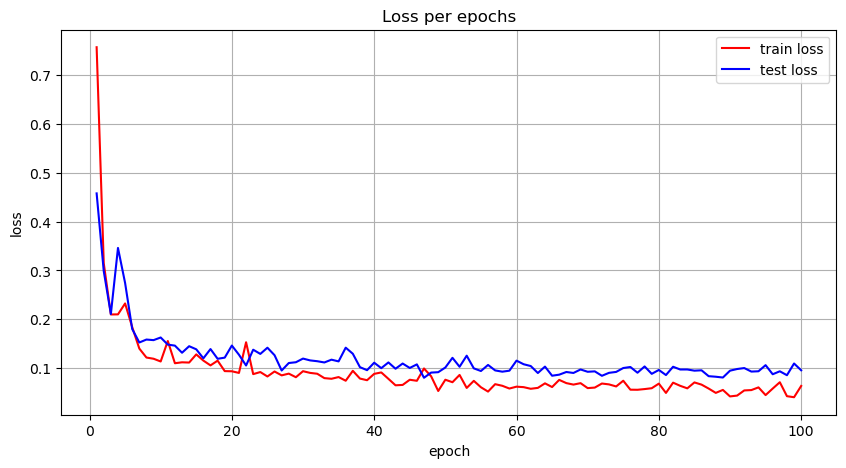

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_loss, 'r', label='train loss')
plt.plot(list(range(1, epochs+1)), test_list_loss, 'b', label='test loss')
plt.title('Loss per epochs')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.grid()
plt.show()

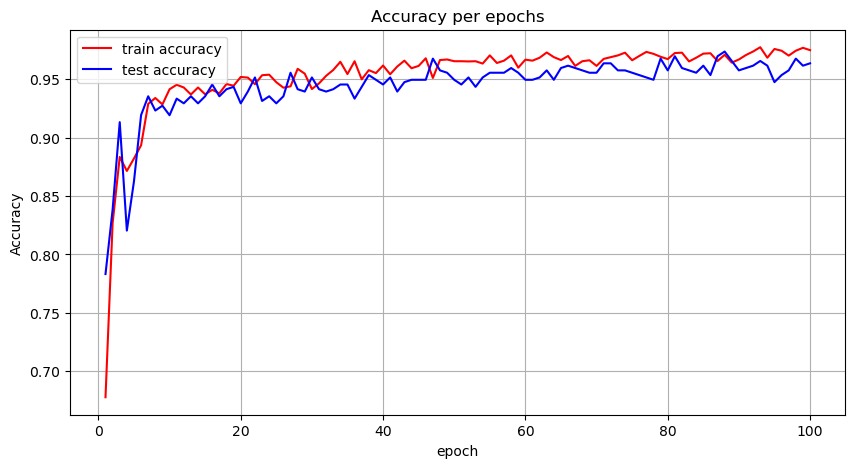

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_acc, 'r', label='train accuracy')
plt.plot(list(range(1, epochs+1)), test_list_acc, 'b', label='test accuracy')
plt.title('Accuracy per epochs')
plt.xlabel('epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

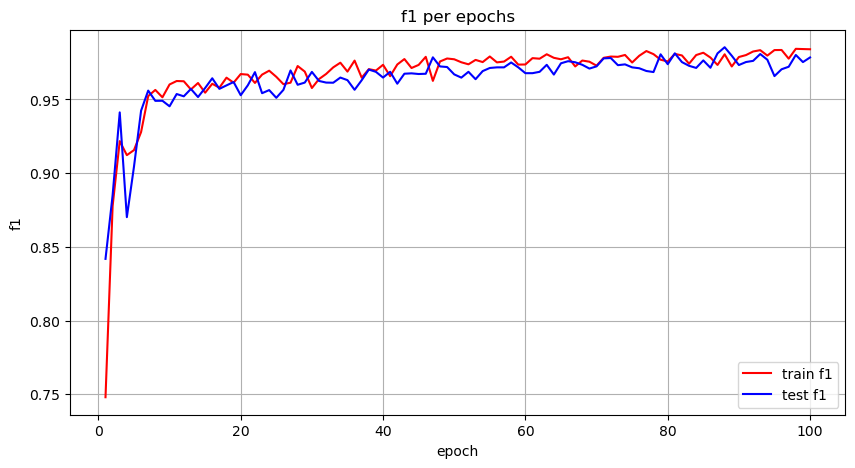

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_f1, 'r', label='train f1')
plt.plot(list(range(1, epochs+1)), test_list_f1, 'b', label='test f1')
plt.title('f1 per epochs')
plt.xlabel('epoch')
plt.ylabel('f1')
plt.legend()
plt.grid()
plt.show()

### Сохраним модель:

In [ ]:
torch.save(model, 'good_classification_model_landmarks.pth')

### ------ checkpoint ------

### Загрузим модель:

In [ ]:
good_classification_model_landmarks = torch.load('good_classification_model_landmarks.pth', map_location=torch.device('cuda')) 
good_classification_model_landmarks.eval()

Net_landmarks_classification(
  (linear_1): Linear(in_features=42, out_features=512, bias=True)
  (bn_1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_2): Linear(in_features=512, out_features=256, bias=True)
  (bn_2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_3): Linear(in_features=256, out_features=7, bias=True)
  (relu): ReLU()
  (dp): Dropout(p=0.2, inplace=False)
)

## Определение левой и правой руки

### Данные

In [ ]:
data_train_index = []
for gesture in good_gestures[1:]:
  for k in data_train_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        if k['labels'][i] != 'no_gesture':
          hand_index = 1 if k['leading_hand'] == 'right' else 0
          data_train_index.append([k['landmarks'][i], hand_index, k['leading_conf']])

In [ ]:
data_test_index = []
for gesture in good_gestures[1:]:
  for k in data_test_hagrid[gesture]:
    for i in range(len(k['landmarks'])):
      if len(k['landmarks'][i]) > 0:
        if k['labels'][i] != 'no_gesture':
          hand_index = 1 if k['leading_hand'] == 'right' else 0
          data_test_index.append([k['landmarks'][i], hand_index, k['leading_conf']])

### Dataset

In [ ]:
class Dataset_index(Dataset):
    def __init__(self, data, noise_v=(-0.03, 0.03)):
        
        data = copy.deepcopy(data)
        self.data = data
        self.noise_v = noise_v

    def __getitem__(self, index):
        # cчитываем данные
        landmarks = torch.tensor(self.data[index][0])
        hand_index = self.data[index][1]
        hand_conf = self.data[index][2]
        
        # приводим метки от 0 до 1
        x_min = landmarks[:,0].min()
        y_min = landmarks[:,1].min()
        w = landmarks[:,0].max() - x_min
        h = landmarks[:,1].max() - y_min
        landmarks[:,0] = (landmarks[:,0] - x_min)/w
        landmarks[:,1] = (landmarks[:,1] - y_min)/h
        
        """# random noise
        noise = np.random.randint(int(self.noise_v[0]*10000), int(self.noise_v[1]*10000), size=(21, 2))/10000
        landmarks = np.clip(landmarks + noise, 0, 1)"""
        
        # horizontal flip
        rand_horizontal = np.random.randint(2)
        if rand_horizontal:
          hand_index = abs(hand_index - 1)
          landmarks[:,0] = landmarks[:,0] * (-1)
        """
        # vertical flip
        rand_vertical = np.random.randint(2)
        if rand_vertical:
          hand_index = abs(hand_index - 1)
          landmarks[:,1] = landmarks[:,1] * (-1)
        # rotation and flip
        rand_rotation = np.random.randint(2)
        if rand_rotation:
          hand_index = abs(hand_index - 1)
          landmarks_cl = landmarks.clone()
          landmarks[:,0] = landmarks_cl[:,1]
          landmarks[:,1] = landmarks_cl[:,0]"""
        
        if hand_index:
            hand_index = torch.tensor([0., hand_conf])
        else:
            hand_index = torch.tensor([hand_conf, 0.])
        
        return landmarks.to(torch.float32), hand_index

    def __len__(self):
        return len(self.data)

In [ ]:
train_dataset = Dataset_index(data_train_index)
test_dataset = Dataset_index(data_test_index)

### DataLoader

In [ ]:
BATCH_SIZE = 16

In [ ]:
train_loader = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, BATCH_SIZE, shuffle=False)

### Обучение

In [ ]:
model = Net_landmarks_classification(in_channel=2, length=21, hidden_dim=512, num_classes=2, dropout=0.2)
model = model.to(device)

In [ ]:
print("Количество параметров: ", sum([param.numel() for param in model.parameters()]))

Количество параметров:  155394


In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

In [ ]:
%%time

epochs = 100

train_list_loss = []
test_list_loss = []
train_list_acc = []
test_list_acc = []

for epoch_num in range(epochs):
    train_loss = 0
    test_loss = 0
    train_acc = 0
    test_acc = 0
    
    model.train()
    for landmarks, labels in tqdm(train_loader):
        landmarks = landmarks.to(device)
        labels = labels.to(device)

        output = model(landmarks)
                
        loss = criterion(output, labels)
        train_loss += loss.item()

        train_acc += (output.argmax(dim=1) == labels.argmax(dim=1)).sum().item() / len(labels)
        
        model.zero_grad()
        loss.backward()
        optimizer.step()
            
    model.eval()
    for landmarks, labels in test_loader:
        landmarks = landmarks.to(device)
        labels = labels.to(device)

        output = model(landmarks)

        loss = criterion(output, labels)
        test_loss += loss.item()
                    
        test_acc += (output.argmax(dim=1) == labels.argmax(dim=1)).sum().item() / len(labels)
    
    train_list_loss.append(round(train_loss / len(train_loader), 6))
    test_list_loss.append(round(test_loss / len(test_loader), 6))
    train_list_acc.append(round(train_acc / len(train_loader), 6))
    test_list_acc.append(round(test_acc / len(test_loader), 6))
            
    print(
        f"Epochs: {epoch_num + 1} | Train Loss: {train_loss / len(train_loader): .6f} \
        | Train Accuracy: {train_acc / len(train_loader): .6f}" + "\n" + " "*len(str(epoch_num + 1)) +
f"         | Test Loss: {test_loss / len(test_loader): .6f} \
         | Test Accuracy: {test_acc / len(test_loader): .6f}")
    
    # Динамически меняем lr в зависимости от ошибки
    opt_loss = round(train_loss / len(train_loader), 6)
    if opt_loss < 0.05:
        optimizer.param_groups[0]['lr'] = 10**(-4)
    else:
        optimizer.param_groups[0]['lr'] = 10**(-3)

100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 265.44it/s]


Epochs: 1 | Train Loss:  0.053401         | Train Accuracy:  0.989583
          | Test Loss:  0.016321          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 221.72it/s]


Epochs: 2 | Train Loss:  0.008528         | Train Accuracy:  0.997917
          | Test Loss:  0.001316          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 309.28it/s]


Epochs: 3 | Train Loss:  0.003660         | Train Accuracy:  1.000000
          | Test Loss:  0.001067          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 322.58it/s]


Epochs: 4 | Train Loss:  0.008422         | Train Accuracy:  0.995833
          | Test Loss:  0.001039          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 337.08it/s]


Epochs: 5 | Train Loss:  0.005078         | Train Accuracy:  1.000000
          | Test Loss:  0.000971          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.33it/s]


Epochs: 6 | Train Loss:  0.005899         | Train Accuracy:  1.000000
          | Test Loss:  0.000822          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 319.15it/s]


Epochs: 7 | Train Loss:  0.002848         | Train Accuracy:  1.000000
          | Test Loss:  0.000775          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 291.26it/s]


Epochs: 8 | Train Loss:  0.004608         | Train Accuracy:  1.000000
          | Test Loss:  0.000588          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 326.09it/s]


Epochs: 9 | Train Loss:  0.015637         | Train Accuracy:  0.997917
          | Test Loss:  0.000489          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 10 | Train Loss:  0.004622         | Train Accuracy:  1.000000
           | Test Loss:  0.000529          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 11 | Train Loss:  0.002143         | Train Accuracy:  1.000000
           | Test Loss:  0.000627          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 340.90it/s]


Epochs: 12 | Train Loss:  0.007387         | Train Accuracy:  0.997917
           | Test Loss:  0.000465          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 340.91it/s]


Epochs: 13 | Train Loss:  0.002585         | Train Accuracy:  1.000000
           | Test Loss:  0.000665          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 300.00it/s]


Epochs: 14 | Train Loss:  0.003650         | Train Accuracy:  0.997917
           | Test Loss:  0.000395          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 340.91it/s]


Epochs: 15 | Train Loss:  0.042925         | Train Accuracy:  0.991667
           | Test Loss:  0.000333          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 329.67it/s]


Epochs: 16 | Train Loss:  0.002299         | Train Accuracy:  1.000000
           | Test Loss:  0.000462          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 329.67it/s]


Epochs: 17 | Train Loss:  0.002143         | Train Accuracy:  1.000000
           | Test Loss:  0.000437          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.33it/s]


Epochs: 18 | Train Loss:  0.008949         | Train Accuracy:  0.997917
           | Test Loss:  0.000455          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 272.73it/s]


Epochs: 19 | Train Loss:  0.008382         | Train Accuracy:  0.997917
           | Test Loss:  0.000407          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 322.58it/s]


Epochs: 20 | Train Loss:  0.002284         | Train Accuracy:  1.000000
           | Test Loss:  0.000720          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 21 | Train Loss:  0.001697         | Train Accuracy:  1.000000
           | Test Loss:  0.000319          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 22 | Train Loss:  0.003281         | Train Accuracy:  1.000000
           | Test Loss:  0.000278          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 23 | Train Loss:  0.002647         | Train Accuracy:  1.000000
           | Test Loss:  0.000316          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 309.28it/s]


Epochs: 24 | Train Loss:  0.003596         | Train Accuracy:  1.000000
           | Test Loss:  0.000509          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 322.58it/s]


Epochs: 25 | Train Loss:  0.009633         | Train Accuracy:  0.997917
           | Test Loss:  0.000297          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 322.58it/s]


Epochs: 26 | Train Loss:  0.004726         | Train Accuracy:  1.000000
           | Test Loss:  0.000224          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 27 | Train Loss:  0.008873         | Train Accuracy:  0.997917
           | Test Loss:  0.000310          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.33it/s]


Epochs: 28 | Train Loss:  0.004591         | Train Accuracy:  0.997917
           | Test Loss:  0.000211          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 322.58it/s]


Epochs: 29 | Train Loss:  0.001493         | Train Accuracy:  1.000000
           | Test Loss:  0.000305          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 337.08it/s]


Epochs: 30 | Train Loss:  0.002618         | Train Accuracy:  1.000000
           | Test Loss:  0.000180          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 315.79it/s]


Epochs: 31 | Train Loss:  0.002272         | Train Accuracy:  0.997917
           | Test Loss:  0.000175          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 32 | Train Loss:  0.000888         | Train Accuracy:  1.000000
           | Test Loss:  0.000173          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 33 | Train Loss:  0.000853         | Train Accuracy:  1.000000
           | Test Loss:  0.000173          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 353.13it/s]


Epochs: 34 | Train Loss:  0.006013         | Train Accuracy:  0.995833
           | Test Loss:  0.000168          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 35 | Train Loss:  0.002190         | Train Accuracy:  1.000000
           | Test Loss:  0.000233          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 319.15it/s]


Epochs: 36 | Train Loss:  0.002376         | Train Accuracy:  1.000000
           | Test Loss:  0.000135          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 315.79it/s]


Epochs: 37 | Train Loss:  0.011181         | Train Accuracy:  0.997917
           | Test Loss:  0.000120          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 300.00it/s]


Epochs: 38 | Train Loss:  0.006816         | Train Accuracy:  1.000000
           | Test Loss:  0.000187          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 39 | Train Loss:  0.001347         | Train Accuracy:  1.000000
           | Test Loss:  0.000125          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 337.08it/s]


Epochs: 40 | Train Loss:  0.008062         | Train Accuracy:  1.000000
           | Test Loss:  0.000129          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 280.37it/s]


Epochs: 41 | Train Loss:  0.002776         | Train Accuracy:  0.997917
           | Test Loss:  0.000205          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 315.79it/s]


Epochs: 42 | Train Loss:  0.002045         | Train Accuracy:  1.000000
           | Test Loss:  0.000187          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.33it/s]


Epochs: 43 | Train Loss:  0.003082         | Train Accuracy:  0.997917
           | Test Loss:  0.000115          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 44 | Train Loss:  0.001668         | Train Accuracy:  1.000000
           | Test Loss:  0.000154          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 45 | Train Loss:  0.000700         | Train Accuracy:  1.000000
           | Test Loss:  0.000131          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 322.58it/s]


Epochs: 46 | Train Loss:  0.001007         | Train Accuracy:  1.000000
           | Test Loss:  0.000167          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 340.91it/s]


Epochs: 47 | Train Loss:  0.002389         | Train Accuracy:  0.997917
           | Test Loss:  0.000098          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 48 | Train Loss:  0.001432         | Train Accuracy:  1.000000
           | Test Loss:  0.000079          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 49 | Train Loss:  0.002719         | Train Accuracy:  1.000000
           | Test Loss:  0.000099          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 50 | Train Loss:  0.000658         | Train Accuracy:  1.000000
           | Test Loss:  0.000088          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 326.09it/s]


Epochs: 51 | Train Loss:  0.001047         | Train Accuracy:  1.000000
           | Test Loss:  0.000086          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 52 | Train Loss:  0.001490         | Train Accuracy:  1.000000
           | Test Loss:  0.000086          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 53 | Train Loss:  0.001030         | Train Accuracy:  1.000000
           | Test Loss:  0.000128          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 54 | Train Loss:  0.002300         | Train Accuracy:  0.997917
           | Test Loss:  0.000087          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 55 | Train Loss:  0.001036         | Train Accuracy:  1.000000
           | Test Loss:  0.000108          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.34it/s]


Epochs: 56 | Train Loss:  0.003367         | Train Accuracy:  0.997917
           | Test Loss:  0.000125          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.33it/s]


Epochs: 57 | Train Loss:  0.005910         | Train Accuracy:  0.997917
           | Test Loss:  0.000073          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 58 | Train Loss:  0.001503         | Train Accuracy:  1.000000
           | Test Loss:  0.000059          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 59 | Train Loss:  0.005806         | Train Accuracy:  0.997917
           | Test Loss:  0.000065          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 270.27it/s]


Epochs: 60 | Train Loss:  0.002800         | Train Accuracy:  0.997917
           | Test Loss:  0.000045          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 288.46it/s]


Epochs: 61 | Train Loss:  0.000860         | Train Accuracy:  1.000000
           | Test Loss:  0.000085          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 62 | Train Loss:  0.001297         | Train Accuracy:  1.000000
           | Test Loss:  0.000046          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.95it/s]


Epochs: 63 | Train Loss:  0.000530         | Train Accuracy:  1.000000
           | Test Loss:  0.000056          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 64 | Train Loss:  0.001342         | Train Accuracy:  1.000000
           | Test Loss:  0.000042          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 65 | Train Loss:  0.001348         | Train Accuracy:  1.000000
           | Test Loss:  0.000045          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 288.46it/s]


Epochs: 66 | Train Loss:  0.000621         | Train Accuracy:  1.000000
           | Test Loss:  0.000036          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.34it/s]


Epochs: 67 | Train Loss:  0.001034         | Train Accuracy:  1.000000
           | Test Loss:  0.000042          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 337.08it/s]


Epochs: 68 | Train Loss:  0.000687         | Train Accuracy:  1.000000
           | Test Loss:  0.000056          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 69 | Train Loss:  0.000452         | Train Accuracy:  1.000000
           | Test Loss:  0.000067          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 337.08it/s]


Epochs: 70 | Train Loss:  0.022317         | Train Accuracy:  0.991667
           | Test Loss:  0.000071          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 288.47it/s]


Epochs: 71 | Train Loss:  0.002457         | Train Accuracy:  0.997917
           | Test Loss:  0.000060          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 312.50it/s]


Epochs: 72 | Train Loss:  0.000741         | Train Accuracy:  1.000000
           | Test Loss:  0.000061          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 340.91it/s]


Epochs: 73 | Train Loss:  0.000521         | Train Accuracy:  1.000000
           | Test Loss:  0.000037          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 303.03it/s]


Epochs: 74 | Train Loss:  0.003670         | Train Accuracy:  0.997917
           | Test Loss:  0.000050          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 319.15it/s]


Epochs: 75 | Train Loss:  0.002911         | Train Accuracy:  1.000000
           | Test Loss:  0.000045          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 76 | Train Loss:  0.001300         | Train Accuracy:  1.000000
           | Test Loss:  0.000113          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 77 | Train Loss:  0.000999         | Train Accuracy:  1.000000
           | Test Loss:  0.000047          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 78 | Train Loss:  0.000371         | Train Accuracy:  1.000000
           | Test Loss:  0.000039          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 337.08it/s]


Epochs: 79 | Train Loss:  0.000661         | Train Accuracy:  1.000000
           | Test Loss:  0.000062          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 329.67it/s]


Epochs: 80 | Train Loss:  0.000472         | Train Accuracy:  1.000000
           | Test Loss:  0.000042          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 81 | Train Loss:  0.000943         | Train Accuracy:  1.000000
           | Test Loss:  0.000042          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 82 | Train Loss:  0.012714         | Train Accuracy:  0.995833
           | Test Loss:  0.000034          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 83 | Train Loss:  0.003413         | Train Accuracy:  0.997917
           | Test Loss:  0.000029          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 333.33it/s]


Epochs: 84 | Train Loss:  0.001434         | Train Accuracy:  1.000000
           | Test Loss:  0.000022          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 303.03it/s]


Epochs: 85 | Train Loss:  0.000337         | Train Accuracy:  1.000000
           | Test Loss:  0.000056          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 329.67it/s]


Epochs: 86 | Train Loss:  0.000340         | Train Accuracy:  1.000000
           | Test Loss:  0.000034          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 87 | Train Loss:  0.000485         | Train Accuracy:  1.000000
           | Test Loss:  0.000031          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 88 | Train Loss:  0.000467         | Train Accuracy:  1.000000
           | Test Loss:  0.000026          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.82it/s]


Epochs: 89 | Train Loss:  0.000756         | Train Accuracy:  1.000000
           | Test Loss:  0.000029          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 326.09it/s]


Epochs: 90 | Train Loss:  0.000751         | Train Accuracy:  1.000000
           | Test Loss:  0.000030          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 309.28it/s]


Epochs: 91 | Train Loss:  0.000621         | Train Accuracy:  1.000000
           | Test Loss:  0.000023          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 340.92it/s]


Epochs: 92 | Train Loss:  0.000409         | Train Accuracy:  1.000000
           | Test Loss:  0.000027          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.84it/s]


Epochs: 93 | Train Loss:  0.000474         | Train Accuracy:  1.000000
           | Test Loss:  0.000031          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 285.82it/s]


Epochs: 94 | Train Loss:  0.002846         | Train Accuracy:  0.997917
           | Test Loss:  0.000018          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 344.83it/s]


Epochs: 95 | Train Loss:  0.000445         | Train Accuracy:  1.000000
           | Test Loss:  0.000024          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]


Epochs: 96 | Train Loss:  0.000852         | Train Accuracy:  1.000000
           | Test Loss:  0.000018          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 352.94it/s]


Epochs: 97 | Train Loss:  0.002146         | Train Accuracy:  1.000000
           | Test Loss:  0.000019          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 303.03it/s]


Epochs: 98 | Train Loss:  0.000673         | Train Accuracy:  1.000000
           | Test Loss:  0.000031          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 326.08it/s]


Epochs: 99 | Train Loss:  0.000420         | Train Accuracy:  1.000000
           | Test Loss:  0.000031          | Test Accuracy:  1.000000


100%|█████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 348.84it/s]

Epochs: 100 | Train Loss:  0.000758         | Train Accuracy:  1.000000
            | Test Loss:  0.000016          | Test Accuracy:  1.000000
Wall time: 10.8 s


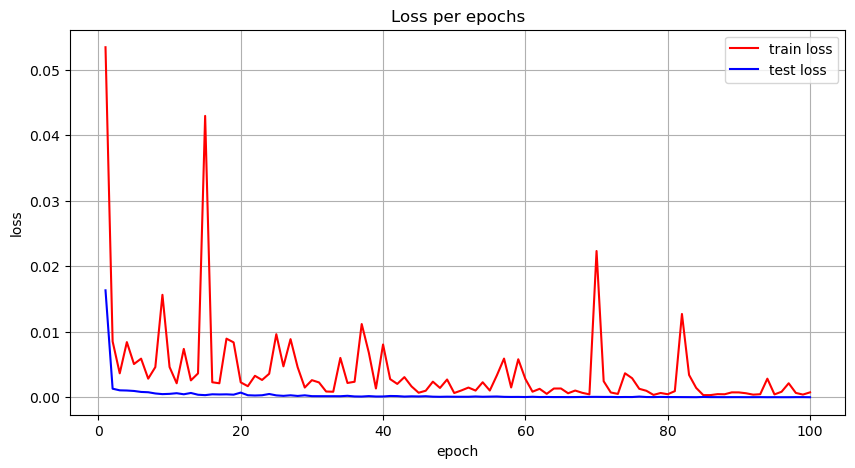

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_loss, 'r', label='train loss')
plt.plot(list(range(1, epochs+1)), test_list_loss, 'b', label='test loss')
plt.title('Loss per epochs')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.grid()
plt.show()

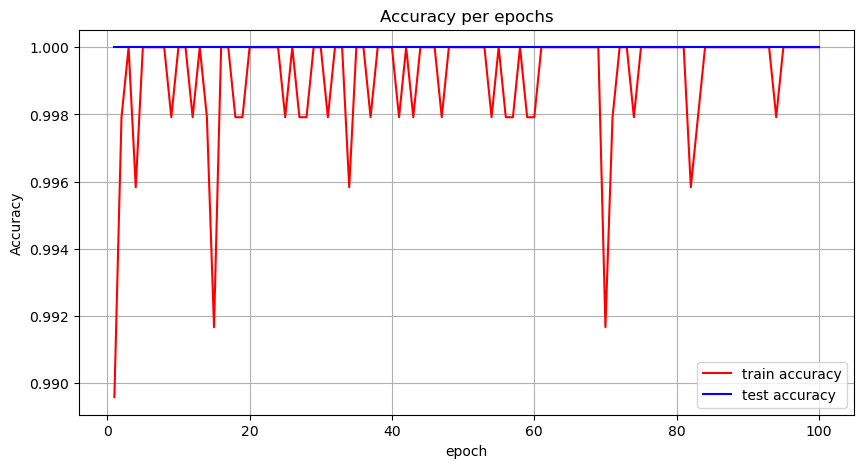

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(list(range(1, epochs+1)), train_list_acc, 'r', label='train accuracy')
plt.plot(list(range(1, epochs+1)), test_list_acc, 'b', label='test accuracy')
plt.title('Accuracy per epochs')
plt.xlabel('epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

### Сохраним модель:

In [ ]:
torch.save(model, 'landmarks_index.pth')

### ------ checkpoint ------

### Загрузим модель:

In [ ]:
landmarks_index = torch.load('landmarks_index.pth', map_location=torch.device('cuda')) 
landmarks_index.eval()

Net_landmarks_classification(
  (linear_1): Linear(in_features=42, out_features=512, bias=True)
  (bn_1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_2): Linear(in_features=512, out_features=256, bias=True)
  (bn_2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear_3): Linear(in_features=256, out_features=2, bias=True)
  (relu): ReLU()
  (dp): Dropout(p=0.2, inplace=False)
)

# Final result

Соберём в итоговую функцию все модели. 

Получится pipeline с возможностью выбора:

1). Используем мы mediapipe или своё решение

2). Используем набор жестов из первой части или из последней

3). Пишем текст или управляем роботом

In [ ]:
def my_landmarks_detect(in_img, min_score=0.5, max_overlap=0.1, top_k=10, box_color=(255,0,0), box_thickness=1, 
                        point_color=(0.,0.,255.), draw_skeleton=True, draw_points=True, skeleton_color=(255.,255.,255.), 
                        skeleton_thickness=2, point_radius=3):
    shp = in_img.shape
    out_img = cv2.cvtColor(in_img, cv2.COLOR_BGR2RGB)
    img = torch.permute(torch.Tensor(in_img), (2, 0, 1)).to(device)
    img_300 = tt.Resize(SIZE, antialias=False)(img) / 255
    locs, classes_scores = hand_detector(img_300[None, ..., ..., ...])
    pred_boxes, pred_labels, pred_scores = hand_detector.detect_objects(locs, classes_scores, min_score, max_overlap, top_k)
    boxes = pred_boxes[0][pred_labels[0] == 1]
    if len(boxes) == 0:
        out_img = cv2.cvtColor(out_img, cv2.COLOR_RGB2BGR)
        return out_img, None, None
    int_boxes = []
    img_hands = []
    for box in boxes:
        x1 = int(box[0]*(shp[1]-1))
        y1 = int(box[1]*(shp[0]-1))
        x2 = int(box[2]*(shp[1]-1))
        y2 = int(box[3]*(shp[0]-1))
        y1 = np.clip(int(y1 - (y2 - y1)*0.2), 0, (shp[0]-1))
        int_boxes.append([x1, y1, x2, y2])
        out_img = cv2.rectangle(out_img, (x1, y1),(x2, y2), color=box_color[::-1], thickness=box_thickness)
        img_hands.append(tt.Resize(SIZE, antialias=False)(img[:, y1:y2, x1:x2])[None, ..., ..., ...] / 255)
    cv2.imshow('frame', out_img)
    pred_landmarks = landmarks_detector_good(torch.cat(img_hands))
    landmarks_list = []
    for i in range(len(boxes)):
        x1 = int_boxes[i][0]
        y1 = int_boxes[i][1]
        x2 = int_boxes[i][2]
        y2 = int_boxes[i][3]
        img_landmarks = pred_landmarks[i].clone()
        img_landmarks[:, 0] += x1/(x2-x1)
        img_landmarks[:, 1] += y1/(y2-y1)
        out_img = draw_landmarks(out_img, img_landmarks, point_color[::-1], draw_skeleton, draw_points, skeleton_color[::-1], 
                        skeleton_thickness, point_radius, size=(x2-x1, y2-y1))
        # min-max normal
        min_max_landmarks = pred_landmarks[i].clone()
        min_max_landmarks[:, 0] -= min(min_max_landmarks[:,0])
        min_max_landmarks[:, 1] -= min(min_max_landmarks[:,1])
        min_max_landmarks[:, 0] /= max(min_max_landmarks[:,0])
        min_max_landmarks[:, 1] /= max(min_max_landmarks[:,1])
        landmarks_list.append(min_max_landmarks[None, ..., ...])
    out_img = cv2.cvtColor(out_img, cv2.COLOR_RGB2BGR)
    landmarks_list = torch.cat(landmarks_list)
    index = torch.argmax(landmarks_index(landmarks_list), 1).cpu().numpy()
    return out_img, landmarks_list, index

In [ ]:
def print_text(messages, trashold, handedness_index, max_scores, max_indexes, delay, gestures,
               x_start, x_end, i_line_message, width_line_message, last_time, text_font_scale, text_thickness):
    # Сначала вводится жест левой руки
    iterat = range(len(handedness_index))
    if len(handedness_index) == 2:
        if handedness_index[0] == 1 and handedness_index[1] == 0:
            iterat = range(len(handedness_index)-1, -1, -1)
    # Если прошло delay времени, то можно реагировать на новый жест
    if time.time() - last_time > delay:
        for i in iterat:
            max_score = max_scores[i].item()
            # Если max_score  > trashold, то происходит действие с сообщением
            if max_score > trashold:
                word = gestures[handedness_index[i]][max_indexes[i].item()]
                if word == None:
                    messages = ['']
                    i_line_message = 0
                    width_line_message = 0
                elif word != '':
                    # Ввод слова    
                    word = ' ' + word
                    (width, height), baseline = cv2.getTextSize(word, cv2.FONT_HERSHEY_COMPLEX, text_font_scale, text_thickness)
                    # Здесь если длина строки сообщения превышает допустимую, то мы переходим на другую строку
                    if width_line_message + width > x_end - x_start:
                        i_line_message += 1
                        messages.append('')
                        width_line_message = 0
                    messages[i_line_message] += word
                    width_line_message += width
                    last_time = time.time()
    
    return messages, i_line_message, width_line_message, last_time

In [ ]:
#!pip install PyBluez-bitalino

In [ ]:
import bluetooth

In [ ]:
def do_robot(frame, sockfd, power, trashold, handedness_index, max_scores, max_indexes, gestures, 
             x_arrow, y_arrow, arrow_len, arrow_color, arrow_thickness, arrow_tip, robot_replace, robot_stop):
    x_centre = int(x_arrow*frame.shape[1])
    y_centre = int(y_arrow*frame.shape[0])
    arrow_len2 = int(arrow_len*frame.shape[0])//2
    moves = []
    for i in range(len(handedness_index)):
        max_score = max_scores[i].item()
        if max_score > trashold:
            move = gestures[handedness_index[i]][max_indexes[i].item()]
            if handedness_index[i] == 1:
                x = x_centre
                y = y_centre
            else:
                x = frame.shape[1] - x_centre
                y = y_centre
            if move == 'w':
                moves.append(move)
                frame = cv2.arrowedLine(frame, (x, y+arrow_len2), (x, y-arrow_len2), 
                                            arrow_color, arrow_thickness, tipLength=arrow_tip)
            elif move == 'a':
                moves.append(move)
                frame = cv2.arrowedLine(frame, (x+arrow_len2, y), (x-arrow_len2, y), 
                                            arrow_color, arrow_thickness, tipLength=arrow_tip)
            elif move == 's':
                moves.append(move)
                frame = cv2.arrowedLine(frame, (x, y-arrow_len2), (x, y+arrow_len2), 
                                            arrow_color, arrow_thickness, tipLength=arrow_tip)
            elif move == 'd':
                moves.append(move)
                frame = cv2.arrowedLine(frame, (x-arrow_len2, y), (x+arrow_len2, y), 
                                            arrow_color, arrow_thickness, tipLength=arrow_tip)
    if moves:
        moves = ''.join(sorted(moves))
        if len(moves) > 1:
            moves = robot_replace[moves]
        sockfd.send(moves)
    else:
        sockfd.send(robot_stop)
    return frame

In [ ]:
class Robot_empty():
    
    def __init__(self, *args, **kwargs):
        pass
    
    def send(self, *args, **kwargs):
        pass
    
    def close(self, *args, **kwargs):
        pass

In [ ]:
def final_result(task='robot', solver='mediapipe', type_gestures='good', old_gestures_text = {'palm_l': 'ПРИВЕТ', 'l_l': ',', 
        'fist_l': 'КАК', 'fist_moved_l': 'ТВОИ', 'thumb_l': 'ДЕЛА', 'index_l': '?', 'ok_l': None, 'palm_moved_l': '', 
        'c_l': '', 'down_l': '', 'palm_r': 'ПРИВЕТ', 'l_r': ',', 'fist_r': 'КАК', 'fist_moved_r': 'ТВОИ', 'thumb_r': 'ДЕЛА', 
        'index_r': '?', 'ok_r': None, 'palm_moved_r': '', 'c_r': '', 'down_r': ''}, old_gestures_robot = {'palm_l': '', 
        'l_l': 'a', 'fist_l': '', 'fist_moved_l': '', 'thumb_l': '', 'index_l': 'd', 'ok_l': '', 
        'palm_moved_l': '', 'c_l': '', 'down_l': '', 'palm_r': '', 'l_r': 's', 'fist_r': '', 
        'fist_moved_r': '', 'thumb_r': '', 'index_r': 'w', 'ok_r': '', 'palm_moved_r': '', 'c_r': '', 
        'down_r': ''}, good_gestures_text={'no_gest_l': '', 'four_l': ',', 'palm_l': 'КАК', 'peace_l': 'ТВОИ', 
        'rock_l': 'ДЕЛА', 'three_l': '?', 'three2_l': None, 'no_gest_r': '', 'four_r': ',', 'palm_r': 'КАК', 
        'peace_r': 'ТВОИ', 'rock_r': 'ДЕЛА', 'three_r': '?', 'three2_r': None}, good_gestures_robot = {'no_gest_l': '', 
        'four_l': '', 'palm_l': 'd', 'peace_l': '', 'rock_l': '', 'three_l': '', 'three2_l': 'a', 
        'no_gest_r': '', 'four_r': '', 'palm_r': 'w', 'peace_r': '', 'rock_r': '', 'three_r': '', 
        'three2_r': 's'}, min_score=0.5, max_overlap=0.1, top_k=2, box_color=(255,0,0), box_thickness=1, trashold=0.8, 
        delay=3, step_message=0.02, x_start_message=0.4, y_start_message=0.01, x_end_message=1, padding_landmarks_detect=0.1, 
        x_padding_output=0.01, y_padding_output=0.01, step_output=0.02, hand_box_color=(255,0,0), output_color=(0,255,0), 
        message_color=(0,230,250), hands=mp.solutions.hands.Hands(static_image_mode=False, min_detection_confidence=0.7, 
        min_tracking_confidence=0.7, max_num_hands=2), box_ppading=0.1, point_color=(0.,0.,255.), draw_skeleton=True, 
        draw_points=True, skeleton_color=(255.,255.,255.), skeleton_thickness=2, point_radius=2, arrow_color=(255,255,0), 
        arrow_thickness=2, arrow_tip=0.3, x_arrow=0.15, y_arrow=0.75, arrow_len=0.2, text_font_scale=0.7, text_thickness=2,
        output_font_scale=0.7, output_thickness=2, fps_x=0.45, fps_y=0.9, fps_color=(0,255,255), 
        robor_address='00:22:06:01:75:2F', robot_port=1, power=170, robot_replace={'aw': 'q', 'dw': 'e', 'as': 'z', 'ds': 'x'}, 
        robot_stop='b', change_power='c', robot_sim=False):
    
    cap = cv2.VideoCapture(0)
    
    # Данные о наборе жестов
    if task == 'text' and type_gestures == 'old':
        gestures_dict = old_gestures_text
    elif task == 'robot' and type_gestures == 'old':
        gestures_dict = old_gestures_robot
    elif task == 'text' and type_gestures == 'good':
        gestures_dict = good_gestures_text
    elif task == 'robot' and type_gestures == 'good':
        gestures_dict = good_gestures_robot
    classes_data = [k[:-2] for k in gestures_dict.keys()][:len(gestures_dict)//2]
    gestures = [list(gestures_dict.values())[:len(gestures_dict)//2], 
                list(gestures_dict.values())[len(gestures_dict)//2:]]
    
    # initialze bounding box to empty
    bbox = ''
    count = 0 
    # bbox_array_size
    bbox_array_size = [480,640,3]

    # Это параметры для выводимого сообщения
    step = int(step_message * bbox_array_size[0])
    x_start = int(x_start_message * bbox_array_size[1])
    y_start = int(y_start_message * bbox_array_size[0])
    x_end = int(x_end_message * bbox_array_size[1])
    messages = ['']
    i_line_message = 0
    width_line_message = 0
    last_time = time.time()
    
    # Подключение к роботу
    if robot_sim:
        sockfd = Robot_empty()
    else:
        sockfd = bluetooth.BluetoothSocket(bluetooth.RFCOMM)
        while True:
            try:
                sockfd.connect((robor_address, robot_port))
                break
            except:
                pass
    
    # Задаем power
    sockfd.send(change_power)
    sockfd.send(chr(power))
    time.sleep(1)
    sockfd.send(robot_stop)

    fps_time_start = time.time()
    while True:
        with torch.no_grad():
            ret, frame = cap.read()
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            # landmarks detect
            if solver == 'mp':
                frame, hand_landmarks, handedness_index = hand_landmarks_detect(frame, hands, box_ppading, box_color, 
                                                                                only_right=False)[:-1]
                if hand_landmarks is not None:
                    hand_landmarks = torch.tensor(hand_landmarks).to(device, dtype=torch.float32)
            elif solver == 'my':
                frame, hand_landmarks, handedness_index = my_landmarks_detect(frame, min_score, 
                                                                              max_overlap, top_k, box_color, box_thickness)
            if hand_landmarks is not None:
                # predict classification_model_landmarks
                if type_gestures == 'old':
                    # Если рука левая, то отзеркаливаем landmarks
                    for i in range(len(handedness_index)):
                      if not handedness_index[i]:
                        hand_landmarks[i,:,0] = 1 - hand_landmarks[i,:,0]
                    output = classification_model_landmarks(hand_landmarks) 
                elif type_gestures == 'good':
                    output = good_classification_model_landmarks(hand_landmarks)
                
                max_scores, max_indexes = F.softmax(output, dim=1).max(dim=1)
                
                # print output classification_model_landmarks
                frame = print_output(frame, output, max_scores, max_indexes, classes_data, handedness_index, 
                                     x_padding_output, y_padding_output, step_output, output_color,
                                     output_font_scale, output_thickness)  
                
                if task == 'text':
                    messages, i_line_message, width_line_message, last_time = print_text(messages, 
                                    trashold, handedness_index, max_scores, max_indexes, delay, gestures,
                                    x_start, x_end, i_line_message, width_line_message, last_time, 
                                    text_font_scale, text_thickness)  
                elif task == 'robot':
                    if ((len(handedness_index) == 2 and handedness_index[0] != handedness_index[1]) 
                                                                        or len(handedness_index) == 1):
                        frame = do_robot(frame, sockfd, power, trashold, handedness_index, max_scores, max_indexes, 
                                         gestures, x_arrow, y_arrow, arrow_len, arrow_color, arrow_thickness, arrow_tip, 
                                         robot_replace, robot_stop)
                    else:
                        sockfd.send(robot_stop)
            elif task == 'robot':
                sockfd.send(robot_stop)
            
            if task == 'text':
                # Пишем сообщение, даже если не показываем новые жесты
                for i in range(i_line_message+1):
                    (width, height), baseline = cv2.getTextSize(messages[i], cv2.FONT_HERSHEY_COMPLEX, 
                                                                text_font_scale, text_thickness)
                    frame = cv2.putText(frame, messages[i], (x_start, y_start+height+(height+step)*i), 
                                    cv2.FONT_HERSHEY_COMPLEX, text_font_scale, message_color, text_thickness, cv2.LINE_AA)
            # Расчёт FPS
            fps = int(1/(time.time() - fps_time_start))
            fps_time_start = time.time()
            fps_text = f"{fps} FPS"
            frame = cv2.putText(frame, fps_text, (int(fps_x*bbox_array_size[1]), int(fps_y*bbox_array_size[0])), 
                                        cv2.FONT_HERSHEY_COMPLEX, text_font_scale, fps_color, text_thickness, cv2.LINE_AA)
            
            frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)    
            cv2.imshow('frame', frame)
            if cv2.waitKey(1) == ord('1'):
                break
                
    sockfd.close()
    cap.release()
    cv2.destroyAllWindows()

In [ ]:
final_result(task='text', solver='my', type_gestures='good', power=150, robot_sim=True)

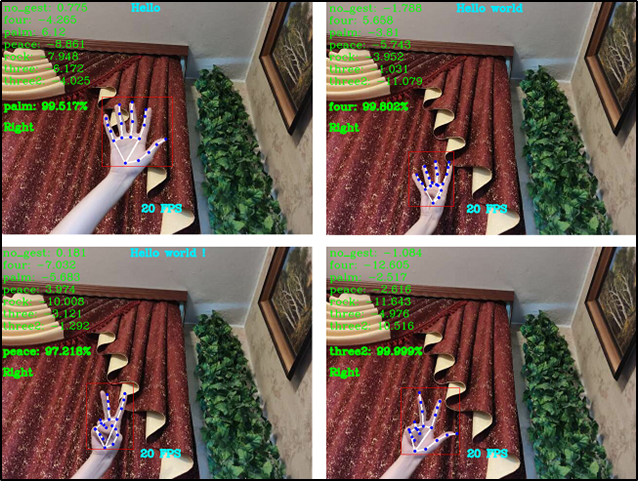